In [1]:
from gaia_tools import query
import matplotlib
#matplotlib.use("AGG")
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from astropy.table import Table
import pyexcel
from astropy import units as u
from astropy.coordinates import SkyCoord

import sklearn
from sklearn import cluster
from astropy import units as u
from astropy.coordinates import SkyCoord
from matplotlib.patches import Circle
#from matplotlib import patches

%pylab inline

Created TAP+ (v1.0.1) - Connection:
	Host: gea.esac.esa.int
	Use HTTPS: False
	Port: 80
	SSL Port: 443
Populating the interactive namespace from numpy and matplotlib


In [ ]:
#Just Testing/Checking Stuff
#Don't need to run

#GlobClust_Log_CMD
#GlobClust_Log_g
#GlobClust_Log_rp
#GlobClust_Log_bp
#GlobClust_Log_rpbp
#GlobClust_Log_ra_out
fabs(GlobClust_Log_dec_out-GlobClust_Log_dec_out.mean())<Clust_Edge/60
#GlobClust_Log_pmdec_out
#GlobClust_Log_pmra_out

In [10]:
GlobClust_Log_ra_dec.loc[0:7,"ID":"DEC"]

,ID,r_h,r_t,r_c,RA,DEC
0,NGC 288,2.23,13.192702,1.35,0h52m45.24s,-26d34m57.4s
1,Pal 5,2.73,7.582903,2.29,15h16m5.25s,0d6m41.8s
2,NGC 104,3.17,42.296312,0.36,0h24m5.67s,-72d4m52.6s
3,Pal 14,1.22,5.173850,0.82,16h11m0.6s,14d57m28s
4,Pal 15,1.10,4.777286,1.20,16h59m51s,0d32m20s
5,NGC 7492,1.15,4.513344,0.86,23h8m26.63s,-15d36m41.4s
6,NGC 5694,0.40,4.657483,0.06,14h39m36.29s,-26d32m20.2s
7,NGC 1851,0.51,6.519924,0.09,5h14m6.76s,-40d2m47.6s


<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
[5] :  NGC 288 1.35 0.0225 8900


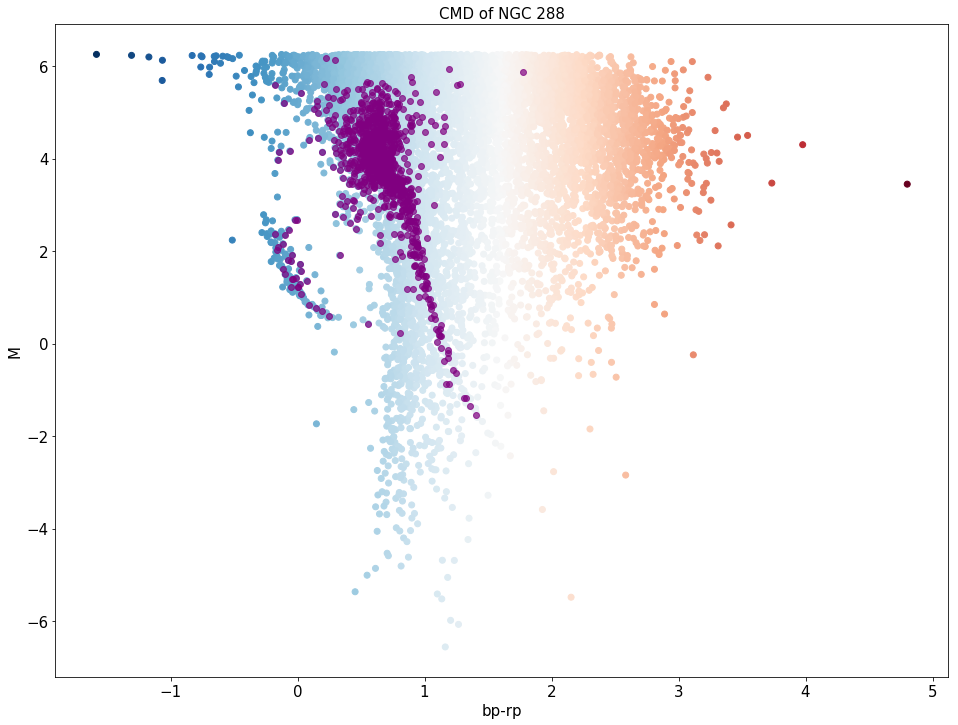

In [4]:
# Plotting core stars CMD on full CMD set (not considering parallax)
# RUN FOR DBSCAN !

#from gaia_tools import query
#import matplotlib
#matplotlib.use("AGG")
#import matplotlib.pyplot as plt
#import numpy as np
#import pandas as pd
#from astropy.table import Table
#import pyexcel
#from astropy import units as u
#from astropy.coordinates import SkyCoord

GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
#GlobClust_Log_r_h = GlobClust_Log_ra_dec.loc[:,"r_h"]
#Clust_Edge = GlobClust_Log_r_h
GlobClust_Log_r_c = GlobClust_Log_ra_dec.loc[:,"r_c"]
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[:,"r_t"]

out_logs = ['out_NGC 104_full_4-rt_ra_dec.csv','out_NGC 5694_full_4-rt_ra_dec.csv',\
            'out_NGC 1851_full_4-rt_ra_dec.csv','out_NGC 7492_full_4-rt_ra_dec.csv','out_Pal 5_full_4-rt_ra_dec.csv',\
            'out_NGC 288_full_4-rt_ra_dec.csv']
GC_IDs = ['NGC 104', 'NGC 5694', 'NGC 1851', 'NGC 7492', 'Pal 5', 'NGC 288']
Clust_Edge = [GlobClust_Log_r_c[2], GlobClust_Log_r_c[6], GlobClust_Log_r_c[7], GlobClust_Log_r_c[5], GlobClust_Log_r_c[1], GlobClust_Log_r_c[0]] #[0.4, 0.03, 0.1, 0.05, 0.13, 0.2]

d_kpc = [4500, 35000, 45100, 12100, 26300, 8900, 23200, 76500]
d_pc = d_kpc

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

for i in range(5,6):#len(GC_IDs)): #Should be better
    print([i], ": ", GC_IDs[i], Clust_Edge[i], Clust_Edge[i]/60, d_pc[i])
    GlobClust_Log_CMD = pd.read_csv(out_logs[i]) 
    GlobClust_Log_g = GlobClust_Log_CMD.loc[:,"phot_g_mean_mag"]
    GlobClust_Log_rp = GlobClust_Log_CMD.loc[:,"phot_rp_mean_mag"]
    GlobClust_Log_bp = GlobClust_Log_CMD.loc[:,"phot_bp_mean_mag"]
    GlobClust_Log_rpbp = GlobClust_Log_bp - GlobClust_Log_rp
    GlobClust_Log_ra_out = GlobClust_Log_CMD.loc[:,"ra"]
    GlobClust_Log_dec_out = GlobClust_Log_CMD.loc[:,"dec"]
    GlobClust_Log_pmdec_out = GlobClust_Log_CMD.loc[:,"pmdec"]
    GlobClust_Log_pmra_out = GlobClust_Log_CMD.loc[:,"pmra"]
    
    
    #M=m-5(log(d)-1)
    GlobClust_Log_M = GlobClust_Log_g-5*((log10(d_pc[i])) - 1)
    
    indx = (sqrt((np.fabs(GlobClust_Log_ra_out-coord_ra_dec.ra.deg)**2+np.fabs(GlobClust_Log_dec_out-coord_ra_dec.dec.deg)**2))<Clust_Edge[i]/60)
    #(np.fabs(GlobClust_Log_ra_out-GlobClust_Log_ra_out.mean())<Clust_Edge[i]/60)*\
    #(np.fabs(GlobClust_Log_dec_out-GlobClust_Log_dec_out.mean())<Clust_Edge[i]/60)  #have used 1.1 & 0.35 for NGC 288
    
    fig=plt.figure(figsize=(16,12))
    plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
    plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='purple', alpha=0.7) #core stars
    plt.xlabel('bp-rp', fontsize=15)
    plt.ylabel('M', fontsize=15)
    plt.title('CMD of ' + GC_IDs[i], fontsize=15)
    #cb=plt.colorbar()
    #cb.ax.tick_params(labelsize=15)
    #cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
    plt.gca().tick_params(labelsize=15)
    plt.show()

    #CMD_raw = {'bprp': GlobClust_Log_rpbp, 'M': GlobClust_Log_M, 'ra': GlobClust_Log_ra_out, 'dec': GlobClust_Log_dec_out}
    #CMD_plot = pd.DataFrame(data=CMD_raw)
    #CMD_plot.to_csv('out_CMD_'+ GC_IDs[i] +'_rawplot.csv', index=True, header=True)
    
    #GC_StarsPlot = {'bprp indx': GlobClust_Log_rpbp[indx], 'M indx': GlobClust_Log_M[indx], 'ra': GlobClust_Log_ra_out,\
    #                'dec': GlobClust_Log_dec_out}
    #GC_StarscutPlot = pd.DataFrame(data=GC_StarsPlot)
    #GC_StarscutPlot.to_csv('out_GCStars_'+ GC_IDs[i] +'_cutplot_r_c.csv', index=True, header=True)
    


In [ ]:
# JustTesting - Don't Run

indx = (np.fabs(GlobClust_Log_ra_out.as_matrix()-GlobClust_Log_ra_out.mean())<Clust_Edge/60)*\
    (np.fabs(GlobClust_Log_dec_out.as_matrix()-GlobClust_Log_dec_out.mean())<Clust_Edge/60)

In [7]:
# WHY DOES THIS NOT WORK 
# DO NOT RUN UNTIL UNDERSTOOD

# Setup csv-pd for NGC288
GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
GlobClust_Log_r_c = GlobClust_Log_ra_dec.loc[0:0,"r_c"]
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[0:0,"r_t"]
GlobClust_Log_radec = GlobClust_Log_ra_dec.loc[0:0,"RA":"DEC"]
GlobClust_Log_ID = GlobClust_Log_ra_dec.loc[0:0,"ID"]

Clust_Edge = GlobClust_Log_r_c.as_matrix()

print('NGC 288', ": r_t =", Clust_Edge, Clust_Edge/60)
GlobClust_Log_CMD = pd.read_csv('out_NGC 288_full_4-rt_ra_dec.csv')
GlobClust_Log_g = GlobClust_Log_CMD.loc[:,"phot_g_mean_mag"]
GlobClust_Log_rp = GlobClust_Log_CMD.loc[:,"phot_rp_mean_mag"]
GlobClust_Log_bp = GlobClust_Log_CMD.loc[:,"phot_bp_mean_mag"]
GlobClust_Log_rpbp = GlobClust_Log_bp - GlobClust_Log_rp
GlobClust_Log_ra_out = GlobClust_Log_CMD.loc[:,"ra"]
GlobClust_Log_dec_out = GlobClust_Log_CMD.loc[:,"dec"]
GlobClust_Log_pmdec_out = GlobClust_Log_CMD.loc[:,"pmdec"]
GlobClust_Log_pmdec_out = GlobClust_Log_CMD.loc[:,"pmra"]

d_kpc = 8.9
d_pc = d_kpc*1000

#M=m-5(log(d)-1)
GlobClust_Log_M = GlobClust_Log_g-5*((log10(d_pc)) - 1)

indx = (np.fabs(GlobClust_Log_ra_out.as_matrix()-GlobClust_Log_ra_ou t.mean())<Clust_Edge/60)*\
    (np.fabs(GlobClust_Log_dec_out.as_matrix()-GlobClust_Log_dec_out.mean())<Clust_Edge/60)

#indx = (np.fabs(GlobClust_Log_ra_out-GlobClust_Log_ra_out.mean())<Clust_Edge/60)*\
#(np.fabs(GlobClust_Log_dec_out-GlobClust_Log_dec_out.mean())<Clust_Edge/60)  #have used 1.1 & 0.35 for NGC 288

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='purple', alpha=0.7)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('CMD of NGC 288', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()



SyntaxError: invalid syntax (<ipython-input-7-112ae7cc7eb0>, line 30)

NameError: name 'ra_ic3' is not defined

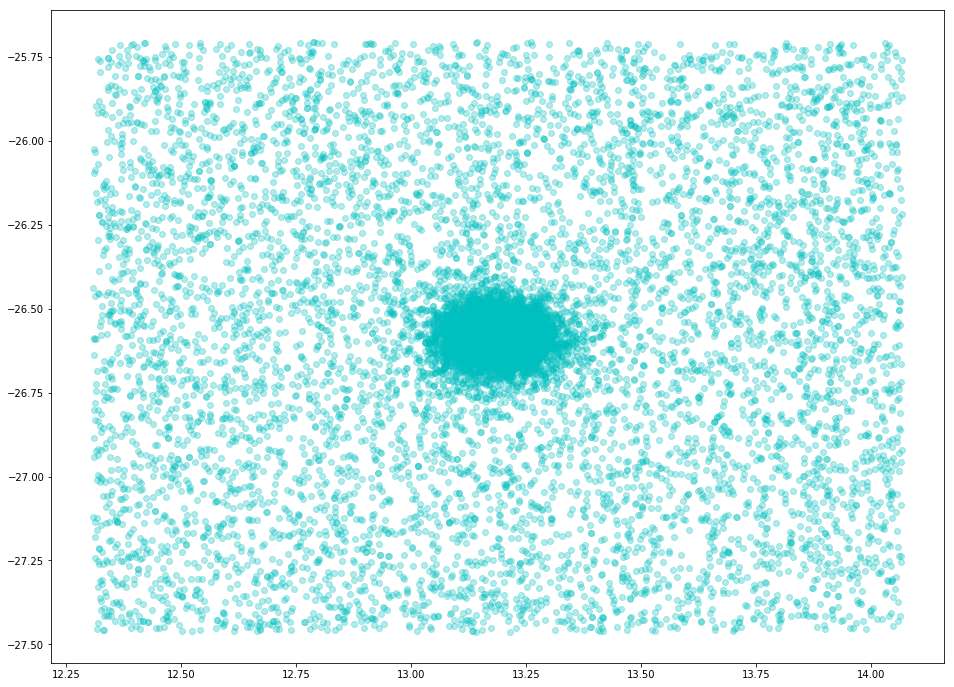

In [5]:
# Full Ra-Dec set overplotted with cleaned data of Cluster Stars  (Run after next 2 cells)

fig=plt.figure(figsize=(16,12))
indx2 = [not i for i in indx]
plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3)
#plt.scatter(x=GlobClust_Log_ra_out[indx2], y=GlobClust_Log_dec_out[indx2], c='c', alpha=0.3)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_ic3, y=dec_ic3, c='purple')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

In [37]:
Clust_Edge

array([ 1.35])

In [3]:
# csv-pd set up for DBSCANN

GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[0:0,"r_t"]
GlobClust_Log_radec = GlobClust_Log_ra_dec.loc[0:0,"RA":"DEC"]
GlobClust_Log_ID = GlobClust_Log_ra_dec.loc[0:0,"ID"]
#GlobClust_Log_dec = GlobClust_Log_ra_dec.loc[:,"dec"]
#GlobClust_Log_RA = GlobClust_Log_ra_dec.loc[0:7,"RA"]
#GlobClust_Log_DEC = GlobClust_Log_ra_dec.loc[0:7,"DEC"]
print(GlobClust_Log_r_t)

GlobClust_Log_2 = pd.read_csv('~/out_NGC 288_full_4-rt_ra_dec.csv')
GlobClust_Log_pmra = GlobClust_Log_2.loc[:,"pmra"]
GlobClust_Log_pmdec = GlobClust_Log_2.loc[:,"pmdec"]
GlobClust_Log_ra = GlobClust_Log_2.loc[:,"ra"]
GlobClust_Log_dec = GlobClust_Log_2.loc[:,"dec"]
GlobClust_Log_pmra = GlobClust_Log_pmra.as_matrix()
GlobClust_Log_pmdec = GlobClust_Log_pmdec.as_matrix()
GlobClust_Log_ra = GlobClust_Log_ra.as_matrix()
GlobClust_Log_dec = GlobClust_Log_dec.as_matrix()

0    13.192702
Name: r_t, dtype: float64


<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(15094, 4)
[ 0  0 -1 ..., -1  0  0]
(15094,)
Estimated number of Subgroups: 2


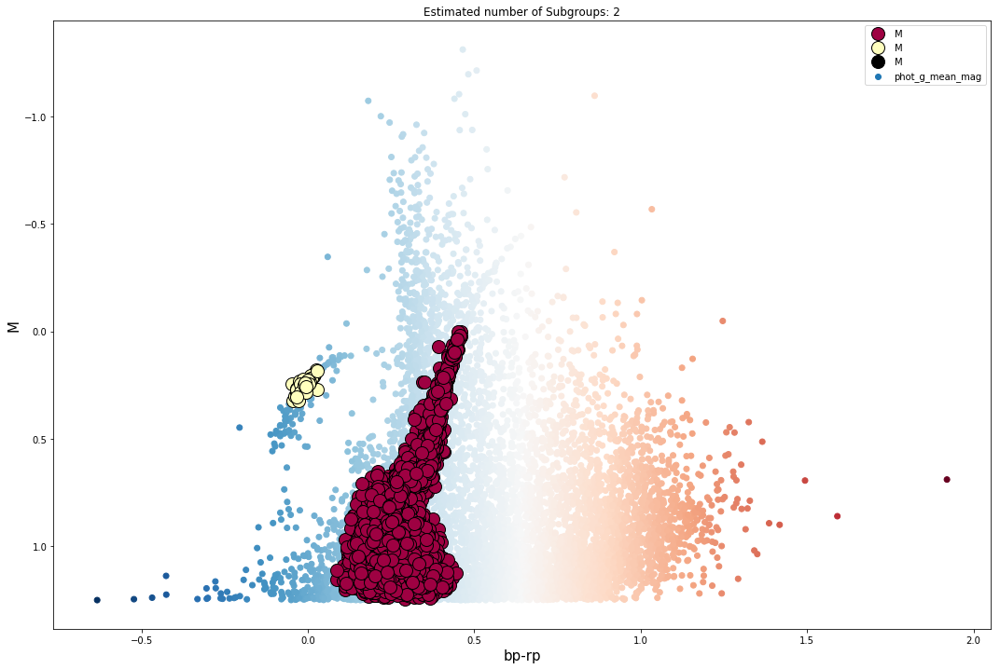

In [9]:
# DBSCANN

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

#DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
#    'pmdec': GlobClust_Log_pmdec[indx]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DF={'M': GlobClust_Log_M/5, 'rpbp': GlobClust_Log_rpbp/2.5, 'pmra': GlobClust_Log_pmra/20, \
    'pmdec': GlobClust_Log_pmdec/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625/2, min_samples=40, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

(7458, 1)


/usr/local/lib/python3.6/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


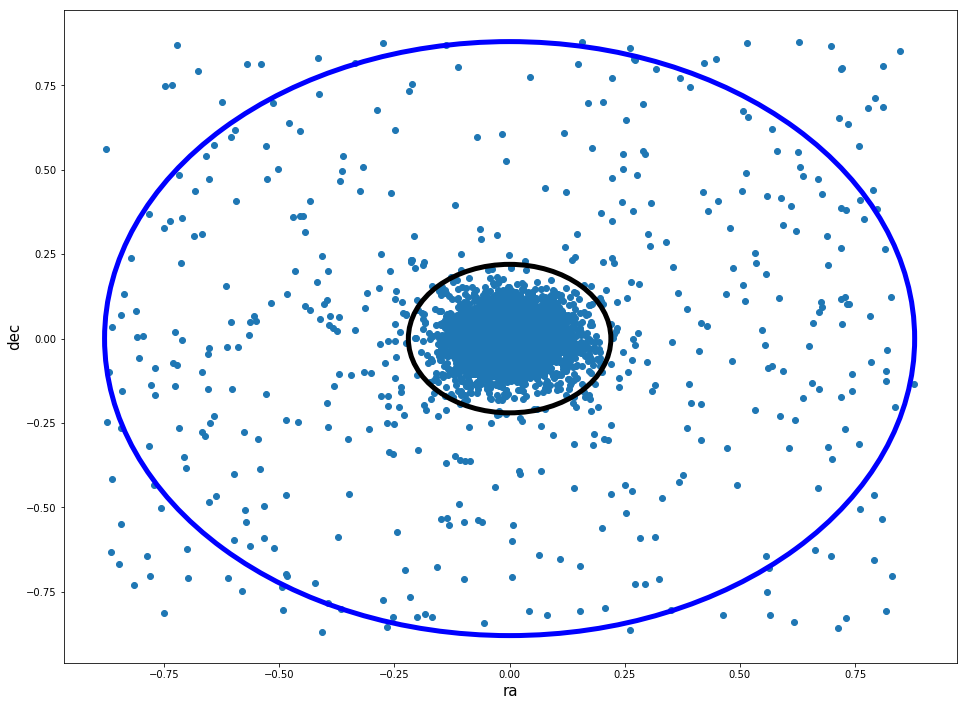

In [6]:
x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

#x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
#x_out4.reset_index()
#x_out4 = x_out4.transpose() 
#x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
##x_out4 = x_out4["pmra"].as_matrix()
#x_out4

#y_out4 = pd.DataFrame(y_param4)#, index=None)#, mangle_dupe_cols=True)
#y_out4.reset_index()
#y_out4 = y_out4.transpose() 
#y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
##y_out4 = y_out4["pmdec"].as_matrix()
#print(shape(y_out4))

GC_ra = pd.DataFrame(GlobClust_Log_ra)
GC_dec = pd.DataFrame(GlobClust_Log_dec)

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)

#for i in range(len(GlobClust_Log_M)):
#    for k in range(len(y_out3)):
#        if GlobClust_Log_M[i] == y_out3[k] and GlobClust_Log_rpbp[i] == x_out3[k] and \
#        GlobClust_Log_pmra[i] == x_out4[k] and GlobClust_Log_pmdec[i] == y_out4[k] :
#            ra_DB.append(GlobClust_Log_ra.as_matrix()[i])
#            dec_DB.append(GlobClust_Log_dec.as_matrix()[i])
            
#.as_matrix()
#.as_matrix()
#.as_matrix()
#.as_matrix()

fig = plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(ra_DB-ra_DB.mean(), dec_DB-dec_DB.mean())
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((0, 0), 4*GlobClust_Log_r_t[0]/60, color='b', fill=False, lw=5)
ax.add_artist(circle2)
#plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.legend()
plt.show()

<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(15094, 4)
[ 0 -1 -1 ..., -1  0 -1]
(15094,)
Estimated number of Subgroups: 2


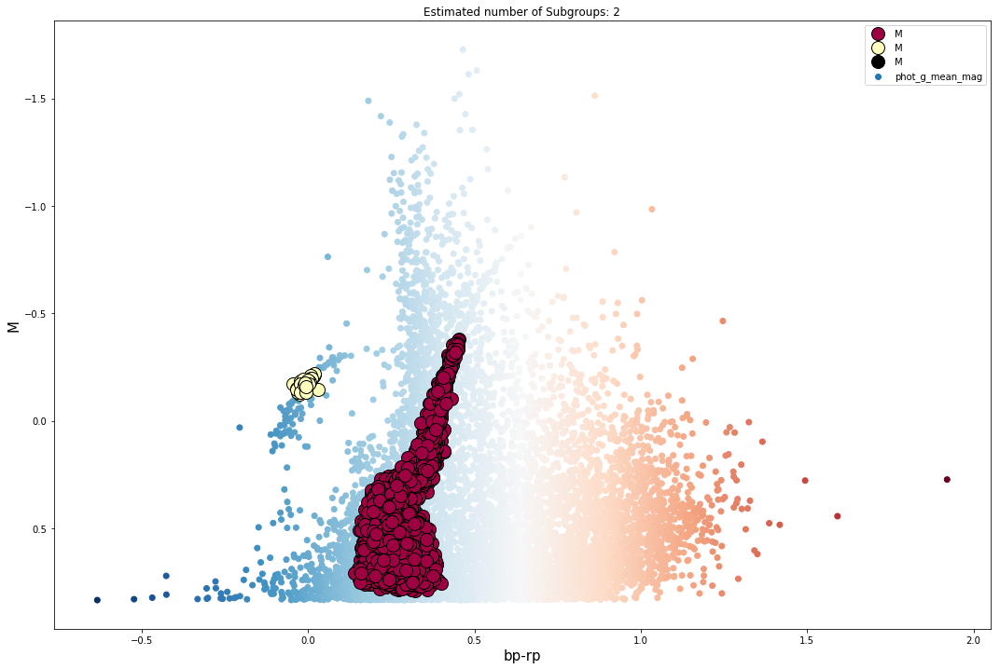

(6092, 1)


/usr/local/lib/python3.6/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


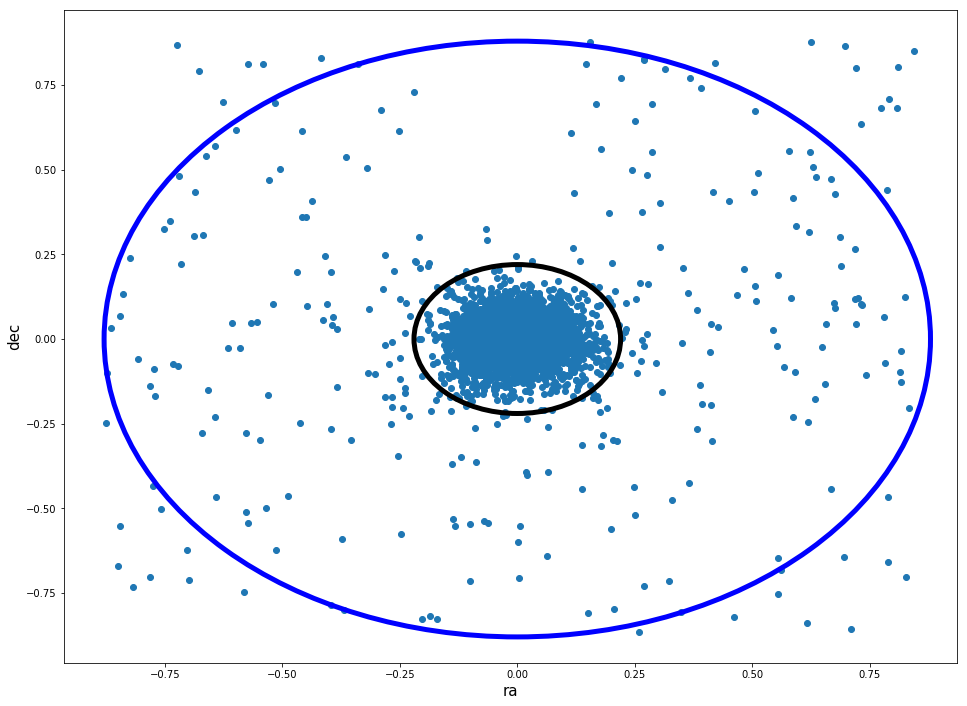

In [7]:
# DBSCANN

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

#DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
#    'pmdec': GlobClust_Log_pmdec[indx]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DF={'M': GlobClust_Log_M/5, 'rpbp': GlobClust_Log_rpbp/2.5, 'pmra': GlobClust_Log_pmra/20, \
    'pmdec': GlobClust_Log_pmdec/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625/3, min_samples=30, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

#x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
#x_out4.reset_index()
#x_out4 = x_out4.transpose() 
#x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
##x_out4 = x_out4["pmra"].as_matrix()
#x_out4

#y_out4 = pd.DataFrame(y_param4)#, index=None)#, mangle_dupe_cols=True)
#y_out4.reset_index()
#y_out4 = y_out4.transpose() 
#y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
##y_out4 = y_out4["pmdec"].as_matrix()
#print(shape(y_out4))

GC_ra = pd.DataFrame(GlobClust_Log_ra)
GC_dec = pd.DataFrame(GlobClust_Log_dec)

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)

#for i in range(len(GlobClust_Log_M)):
#    for k in range(len(y_out3)):
#        if GlobClust_Log_M[i] == y_out3[k] and GlobClust_Log_rpbp[i] == x_out3[k] and \
#        GlobClust_Log_pmra[i] == x_out4[k] and GlobClust_Log_pmdec[i] == y_out4[k] :
#            ra_DB.append(GlobClust_Log_ra.as_matrix()[i])
#            dec_DB.append(GlobClust_Log_dec.as_matrix()[i])
            
#.as_matrix()
#.as_matrix()
#.as_matrix()
#.as_matrix()

fig = plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(ra_DB-ra_DB.mean(), dec_DB-dec_DB.mean())
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((0, 0), 4*GlobClust_Log_r_t[0]/60, color='b', fill=False, lw=5)
ax.add_artist(circle2)
#plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.legend()
plt.show()

<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(15094, 4)
[-1 -1 -1 ..., -1  0 -1]
(15094,)
Estimated number of Subgroups: 4


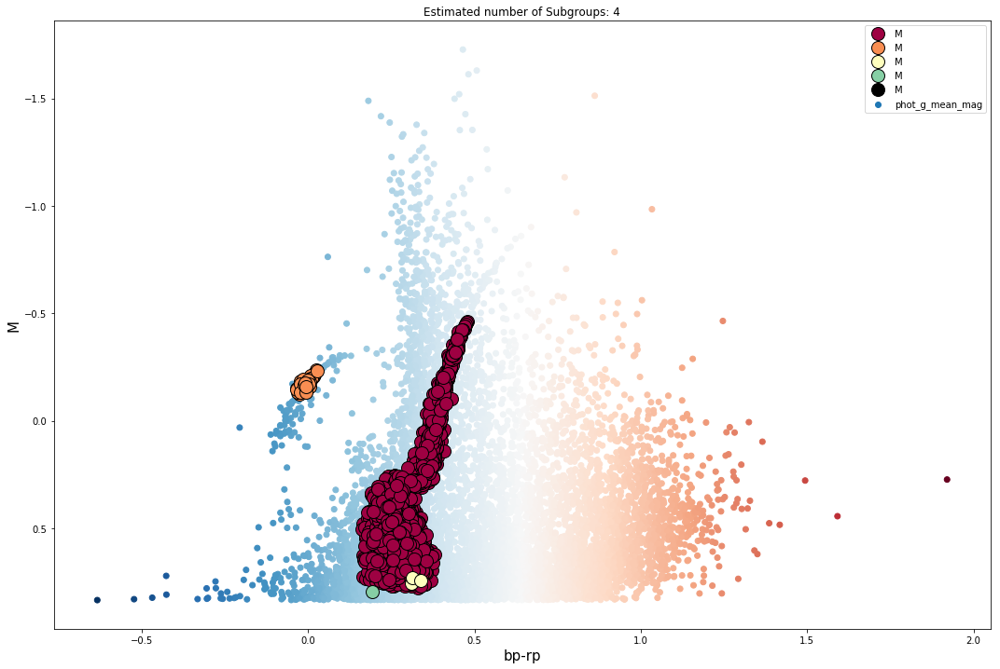

(5518, 1)


/usr/local/lib/python3.6/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


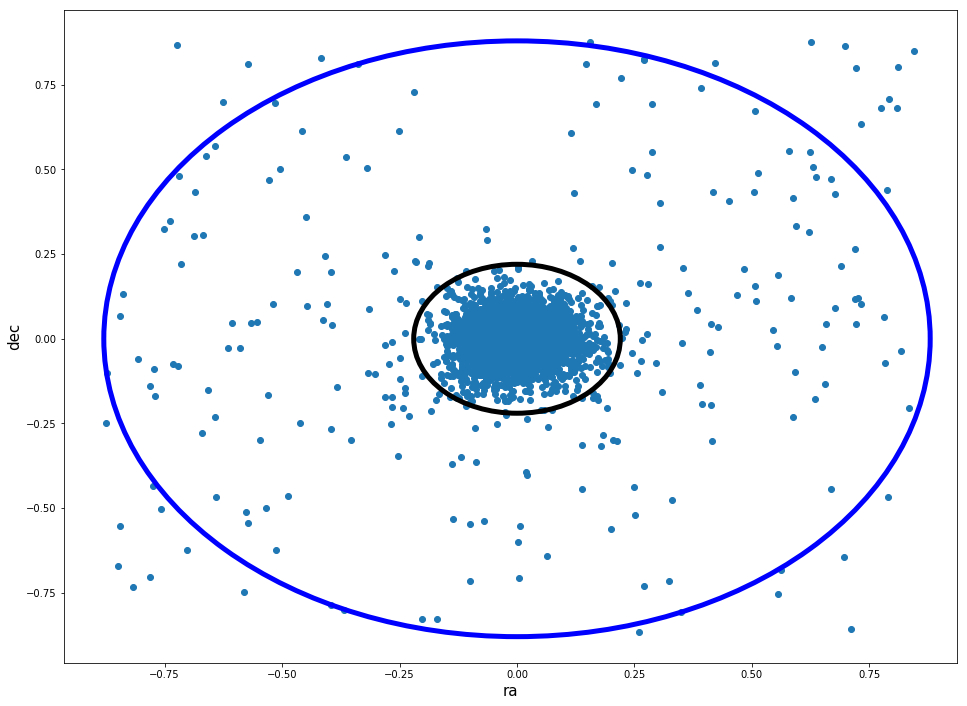

In [8]:
# DBSCANN

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

#DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
#    'pmdec': GlobClust_Log_pmdec[indx]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DF={'M': GlobClust_Log_M/5, 'rpbp': GlobClust_Log_rpbp/2.5, 'pmra': GlobClust_Log_pmra/20, \
    'pmdec': GlobClust_Log_pmdec/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625/4, min_samples=15, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

#x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
#x_out4.reset_index()
#x_out4 = x_out4.transpose() 
#x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
##x_out4 = x_out4["pmra"].as_matrix()
#x_out4

#y_out4 = pd.DataFrame(y_param4)#, index=None)#, mangle_dupe_cols=True)
#y_out4.reset_index()
#y_out4 = y_out4.transpose() 
#y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
##y_out4 = y_out4["pmdec"].as_matrix()
#print(shape(y_out4))

GC_ra = pd.DataFrame(GlobClust_Log_ra)
GC_dec = pd.DataFrame(GlobClust_Log_dec)

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)

#for i in range(len(GlobClust_Log_M)):
#    for k in range(len(y_out3)):
#        if GlobClust_Log_M[i] == y_out3[k] and GlobClust_Log_rpbp[i] == x_out3[k] and \
#        GlobClust_Log_pmra[i] == x_out4[k] and GlobClust_Log_pmdec[i] == y_out4[k] :
#            ra_DB.append(GlobClust_Log_ra.as_matrix()[i])
#            dec_DB.append(GlobClust_Log_dec.as_matrix()[i])
            
#.as_matrix()
#.as_matrix()
#.as_matrix()
#.as_matrix()

fig = plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(ra_DB-ra_DB.mean(), dec_DB-dec_DB.mean())
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((0, 0), 4*GlobClust_Log_r_t[0]/60, color='b', fill=False, lw=5)
ax.add_artist(circle2)
#plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.legend()
plt.show()

<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(9463, 4)
[-1 -1 -1 ..., -1  0 -1]
(9463,)


/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))


Estimated number of Subgroups: 5


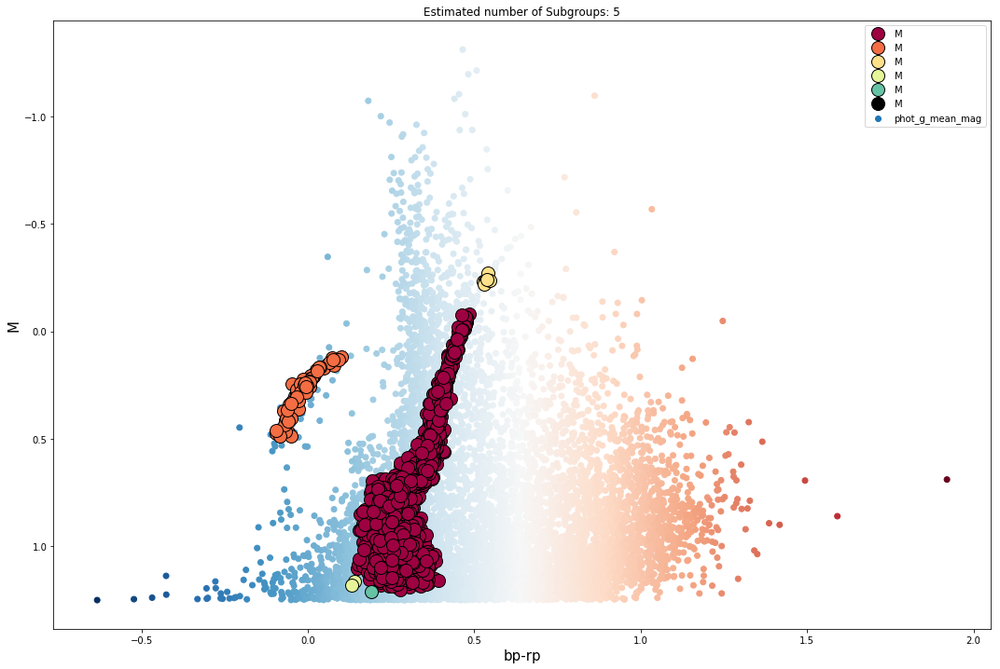

In [6]:
# DBSCANN

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

GlobClust_Log_parallax_out = GlobClust_Log_2.loc[:,"parallax"]
GlobClust_Log_parallaxerror_out = GlobClust_Log_2.loc[:,"parallax_error"]
GlobClust_Log_parallaxe_out = GlobClust_Log_2.loc[:,"parallax":"parallax_error"]

GlobClust_Log_parallaxover_out = GlobClust_Log_parallaxerror_out/GlobClust_Log_parallax_out

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20))
parallax_indx2=((1/GlobClust_Log_parallax_out<5.)*(GlobClust_Log_parallaxover_out<0.10))
parallax_indx2=[not i for i in parallax_indx2]

#DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
#    'pmdec': GlobClust_Log_pmdec[indx]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DF={'M': GlobClust_Log_M[parallax_indx2]/5, 'rpbp': GlobClust_Log_rpbp[parallax_indx2]/2.5, \
    'pmra': GlobClust_Log_pmra[parallax_indx2]/20, \
    'pmdec': GlobClust_Log_pmdec[parallax_indx2]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625/4, min_samples=8, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)
    
    #x_param4.append(xy.loc[:, "ra"]*0.35)
    #y_param4.append(xy.loc[:, "dec"]*0.3)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

(3863, 1)


/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))


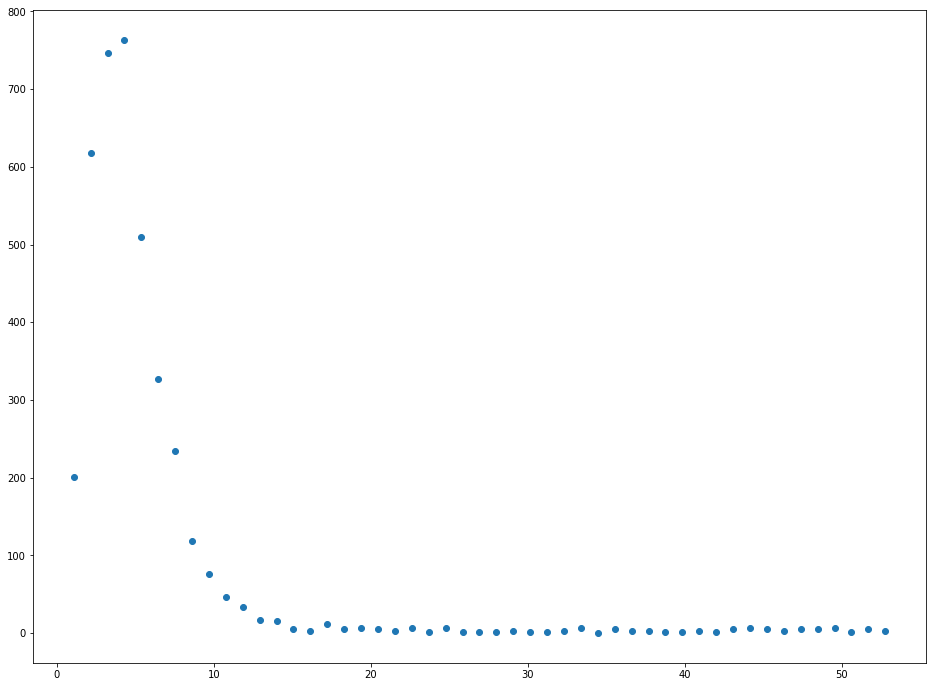

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:57: RuntimeWarning: divide by zero encountered in log


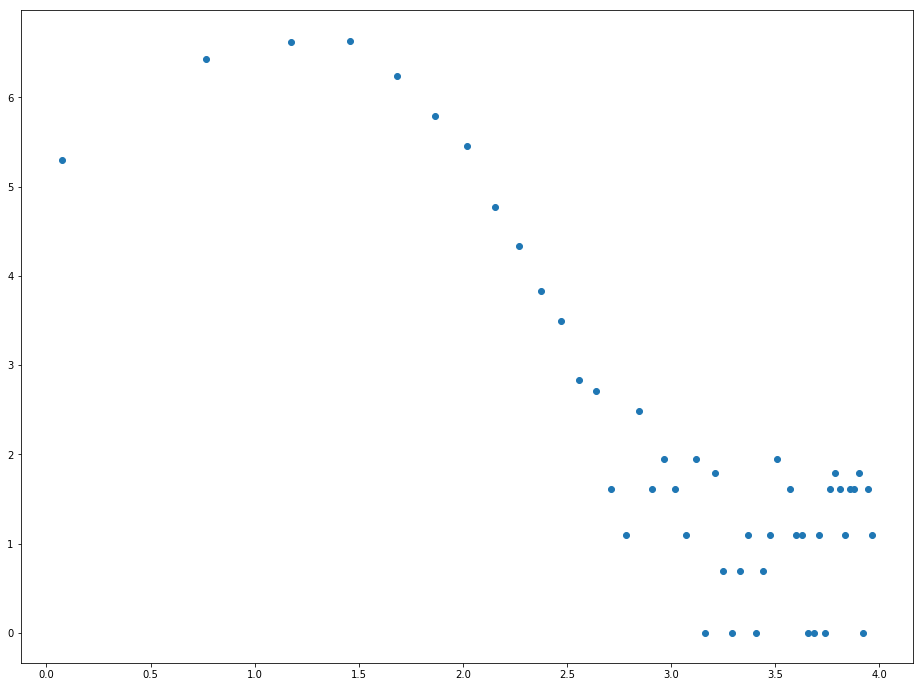

In [7]:
#ra_DB2-coord_ra_dec.ra.deg
x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

ra_DB = GlobClust_Log_ra_out.reindex(x_out3.index)
dec_DB = GlobClust_Log_dec_out.reindex(y_out3.index)
pmra_DB = GlobClust_Log_pmra_out.reindex(x_out3.index)
pmdec_DB = GlobClust_Log_pmdec_out.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(x_out3.index)
M_DB = GlobClust_Log_M.reindex(y_out3.index)

#radii=linspace(0, ra_DB.max(),3)

radii=linspace(0, 4*GlobClust_Log_r_t[0]/60)

c_a = []

for i in range(1,len(radii)):
    indx_r = (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2)<radii[i])*\
    (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_DB[indx_r])
    dec_count = len(dec_DB[indx_r])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count#/r_area_ring
    count_area2 = dec_count#/r_area_ring
    #print('debug',count_area)
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

fig=plt.figure(figsize(16,12))
plt.scatter(radii[1:]*60,c_a)
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

In [42]:
ra_DB
x=np.fabs(ra_DB-coord_ra_dec.ra.deg)**2
y=np.fabs(dec_DB-coord_ra_dec.dec.deg)**2
#coord_ra_dec
x+y
indx1 = (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2<10)))#+\
                  #np.fabs(dec_DB-coord_ra_dec.dec.deg)**2))<10)
indx2=(sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2))>0)
#indx.sum()
indx1.sum()
#x+y
indx = (sqrt((np.fabs(GlobClust_Log_ra_out-GlobClust_Log_ra_out.mean())**2+np.fabs(GlobClust_Log_dec_out-GlobClust_Log_dec_out.mean())**2))<Clust_Edge[i]/60)
type(ra_DB)
type(GlobClust_Log_ra_out)
ra_DB.as_matrix
indx
ra_DB = GlobClust_Log_ra_out.reindex(x_out3.index)
dec_DB = GlobClust_Log_dec_out.reindex(y_out3.index)
type(ra_DB)
indx_density = (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2)<10)*\
    (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2))>0)
indx_density.sum()

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))


3863

<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(972, 6)
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0
  0  0  0 -1  0  0  0  0  0  0 -1  0 -1  0  0  0  0  0  0  0  0  0  0  0 -1
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 -1  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0 -1  0  0  0  0  0  0  0  0  0
  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0
 -1  0  0  0  0 -1  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0 -1  0  0 -1
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0
  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0
  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0

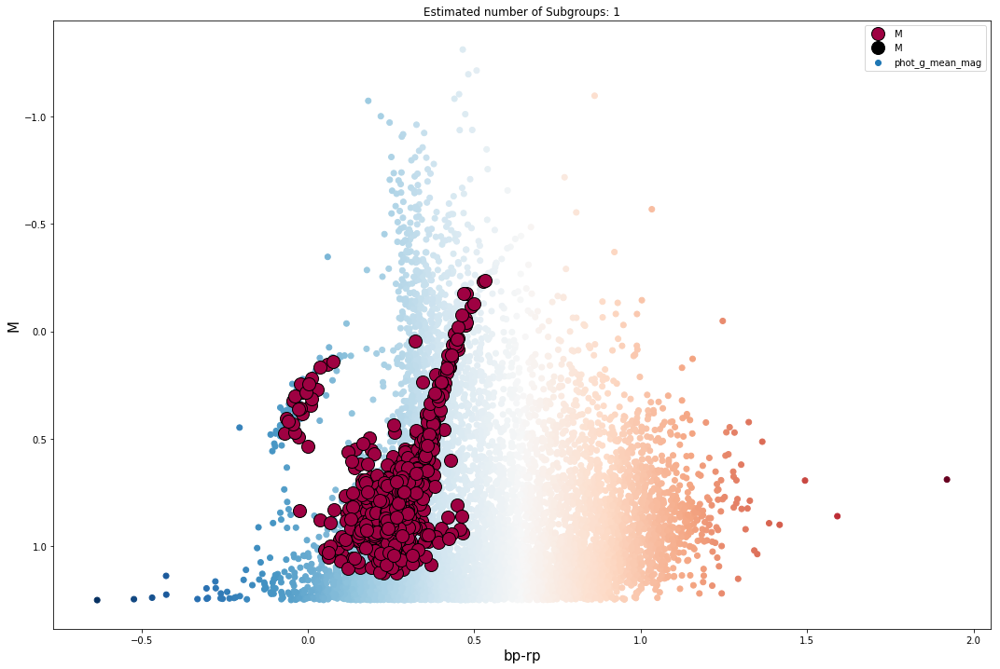

In [29]:
# DBSCANN

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

#DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
#    'pmdec': GlobClust_Log_pmdec[indx]/20}#, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DF={'M': GlobClust_Log_M[indx]/5, 'rpbp': GlobClust_Log_rpbp[indx]/2.5, 'pmra': GlobClust_Log_pmra[indx]/20, \
    'pmdec': GlobClust_Log_pmdec[indx]/20, 'ra': GlobClust_Log_ra[indx]/0.35, 'dec': GlobClust_Log_dec[indx]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625, min_samples=8, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)
    
    #x_param4.append(xy.loc[:, "ra"]*0.35)
    #y_param4.append(xy.loc[:, "dec"]*0.3)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

In [30]:
# Matching DBSCANN results to full CMD

import time

t0 = time.time()

#print(x_param)
#print(y_param)

#print(GlobClust_Log_M[x_param])
#x_out = x_param.transpose()
x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))


M_i3 = GlobClust_Log_M.as_matrix()
rpbp_i3 = GlobClust_Log_rpbp.as_matrix()

M_k3 = y_out3
rpbp_k3 = x_out3


Cluster3 = np.zeros(len(GlobClust_Log_M), dtype='bool')


M_final3 = []
rpbp_final3 =[]


for i3 in range(0,len(M_i3)):
    count = 0
    for k3 in range(0,len(M_k3)):
        dist3 = np.sqrt(np.abs((M_i3[i3]-M_k3[k3])**2+(rpbp_i3[i3]-rpbp_k3[k3])**2))
        if dist3 < 0.1:
            Cluster3[i3]=True
            M_final3.append(M_i3[i3])
            rpbp_final3.append(rpbp_i3[i3])
            count+=1
            if count != 0:
                break

t1 = time.time()
total = t1-t0
print(total)
print(Cluster3)
print(shape(Cluster3))
print(np.sum(Cluster3))

(854,)
45.34917068481445
[ True False False ..., False  True False]
(21399,)
8732


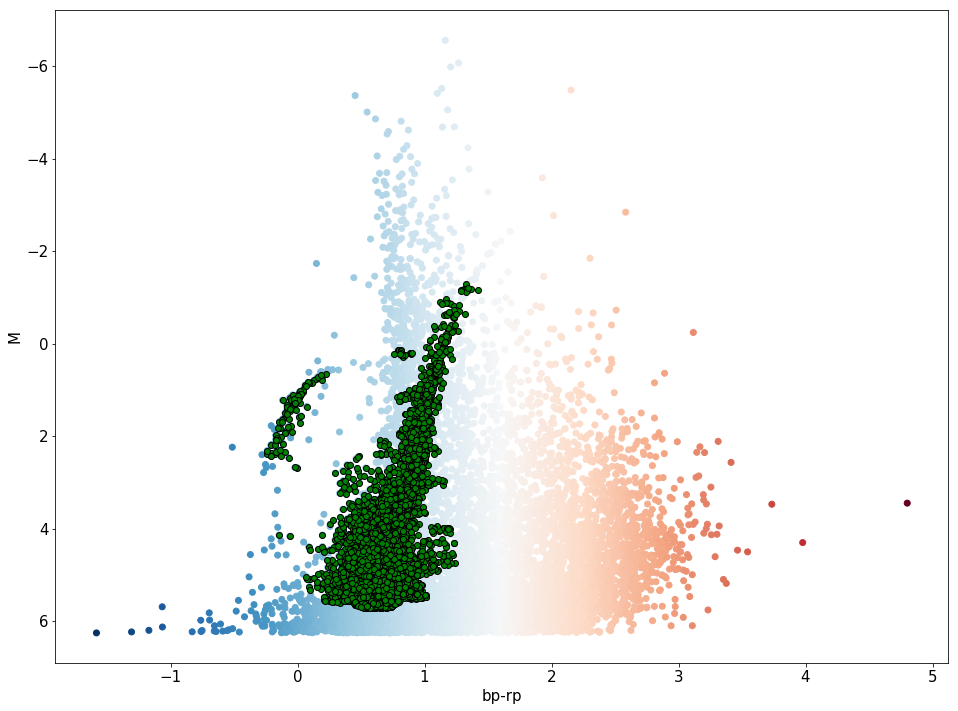

In [31]:
# PLOT OUTCOME OF CMD MATCHING - RUN AFTER PREVIOUS CELL
rpbp_ic3=rpbp_i3[Cluster3] #np.multiply(rpbp_i,Cluster)
M_ic3=M_i3[Cluster3] #multiply(M_i,Cluster)

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=rpbp_ic3, y=M_ic3, c='g', edgecolors='k')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

In [64]:
shape(pmra_norm2)
shape(Survive2)
shape(pmra_norm2[Survive2])
shape(pmra_ic3)
shape(Survive)

(8739,)

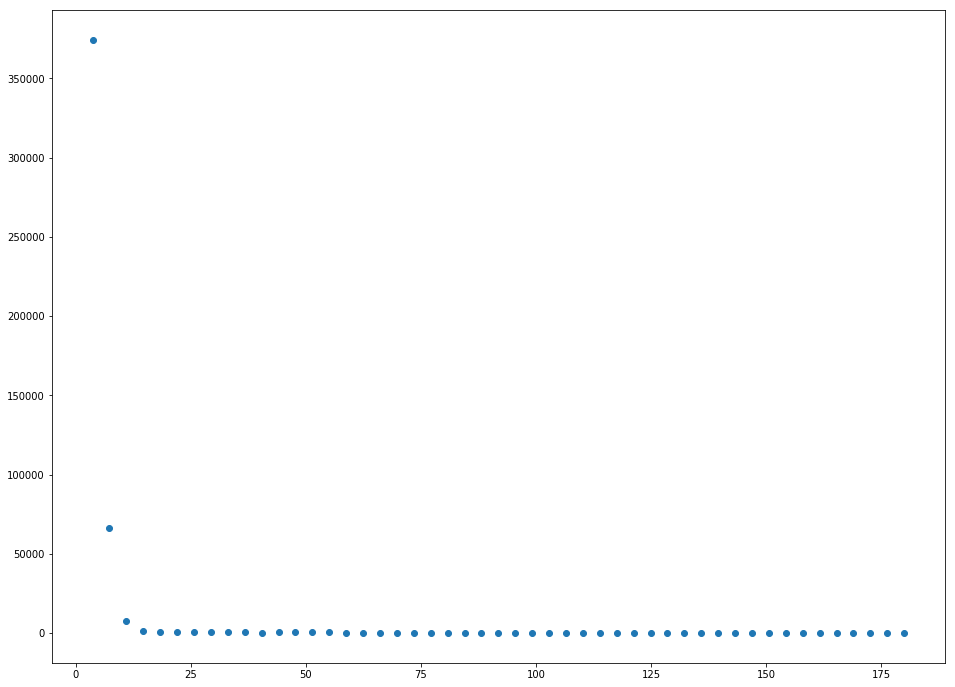

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:35: RuntimeWarning: divide by zero encountered in log


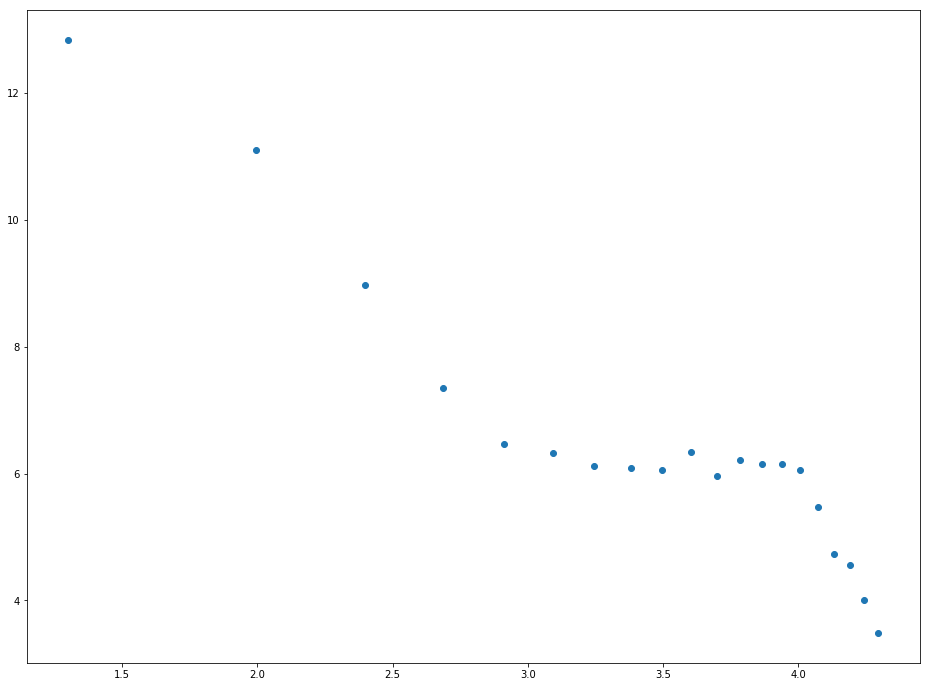

In [16]:
#ra_DB2-coord_ra_dec.ra.deg

radii=linspace(0, 3)

c_a = []

for i in range(1,50):
    indx_r = (sqrt((np.fabs(ra_ic3-coord_ra_dec.ra.deg)**2+\
                    np.fabs(dec_ic3-coord_ra_dec.dec.deg)**2))<radii[i])*\
    (sqrt((np.fabs(ra_ic3-coord_ra_dec.ra.deg)**2+\
                    np.fabs(dec_ic3-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_ic3[indx_r])
    dec_count = len(dec_ic3[indx_r])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count/r_area_ring
    count_area2 = dec_count/r_area_ring
    
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

fig=plt.figure(figsize(16,12))
plt.scatter(radii[1:]*60,c_a)
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

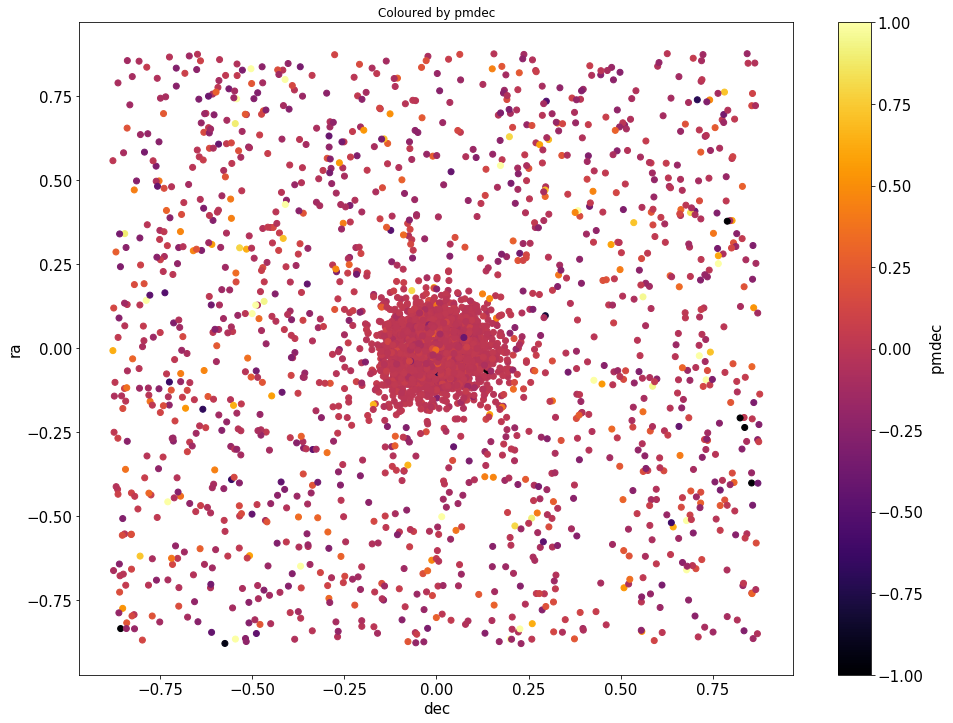

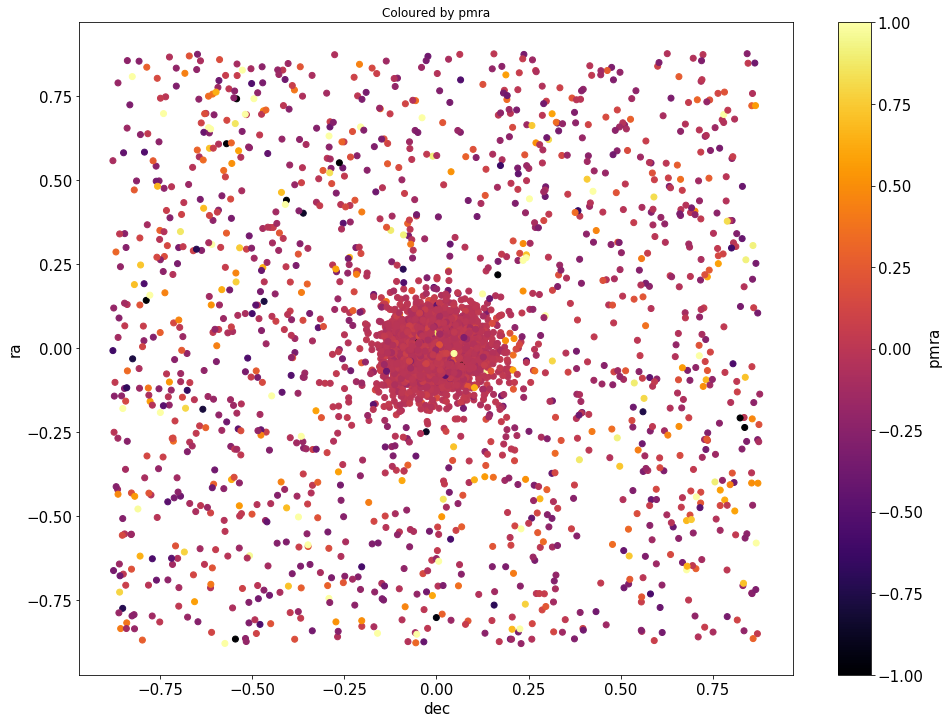

In [21]:
# PLOT RA-DEC FROM MATCHING CMD
# RUN AFTER PREVIOUS CELLS

GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[:,"r_t"]
Tidal_Edge = GlobClust_Log_r_t.loc[0]

ra_ic3=GlobClust_Log_ra[Cluster3] #np.multiply(rpbp_i,Cluster)
dec_ic3=GlobClust_Log_dec[Cluster3] #multiply(M_i,Cluster)
pmdec_ic3=GlobClust_Log_pmdec[Cluster3]
pmra_ic3=GlobClust_Log_pmra[Cluster3]

Survive = (sqrt((np.fabs(ra_ic3-ra_ic3.mean())**2+np.fabs(dec_ic3-dec_ic3.mean())**2))<Tidal_Edge/60)
#Survive = [not i for i in Survive]
Survive2 = [not i for i in Survive]

#pmdec_norm2 = (pmdec_ic3 - np.nanmean(pmdec_ic3)) / (20*np.nanmean(pmdec_ic3))
#pmra_norm2 = (pmra_ic3 - np.nanmean(pmra_ic3)) / (16*np.nanmean(pmra_ic3))

#Scaling:
pmdec_norm2 = (pmdec_ic3 - np.nanmean(pmdec_ic3[Survive2])) / (4*np.nanmean(pmdec_ic3[Survive2]))
pmra_norm2 = (pmra_ic3 - np.nanmean(pmra_ic3[Survive2])) / (4*np.nanmean(pmra_ic3[Survive2]))

#caraay=[cm.magma_r((3.5-2.5)/2.5),cm.magma_r(0),cm.magma_r((2.8-2.5)/2.5),cm.magma_r((3-2.5)/2.5),cm.magma_r((3.2-2.5)/2.5),\
#        cm.magma_r((3.5-2.5)/2.5),cm.magma_r((3.8-2.5)/2.5),cm.magma_r((4-2.5)/2.5),cm.magma_r((5-2.5)/2.5)]


fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c=pmdec_norm2, cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
plt.gca().tick_params(labelsize=15)

fig=plt.figure(figsize=(16,12))
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c=pmra_norm2, cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
plt.gca().tick_params(labelsize=15)
plt.show()

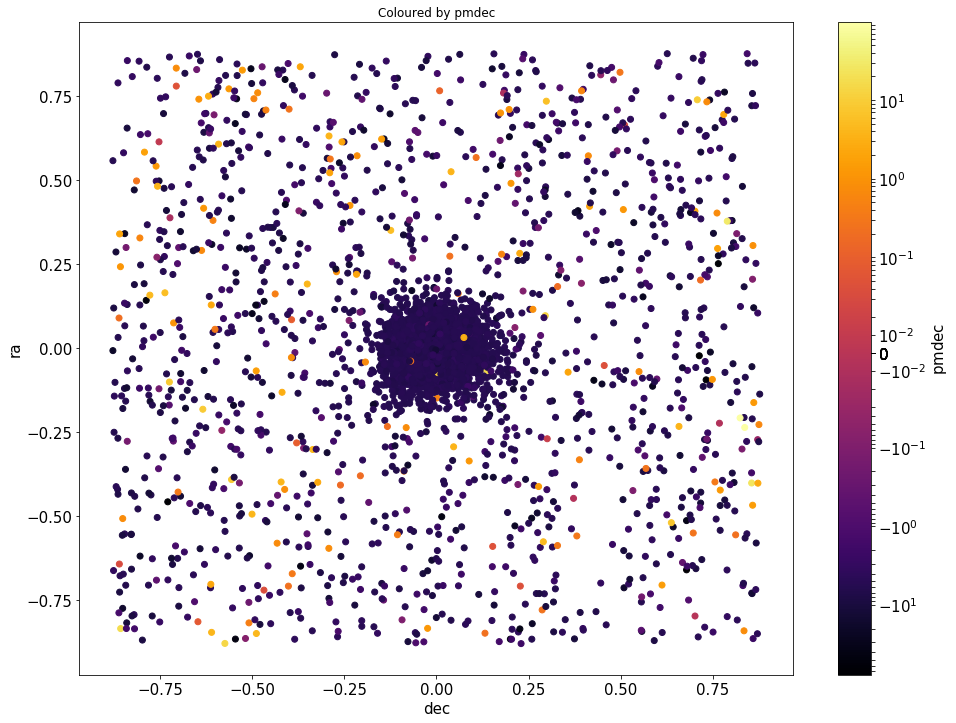

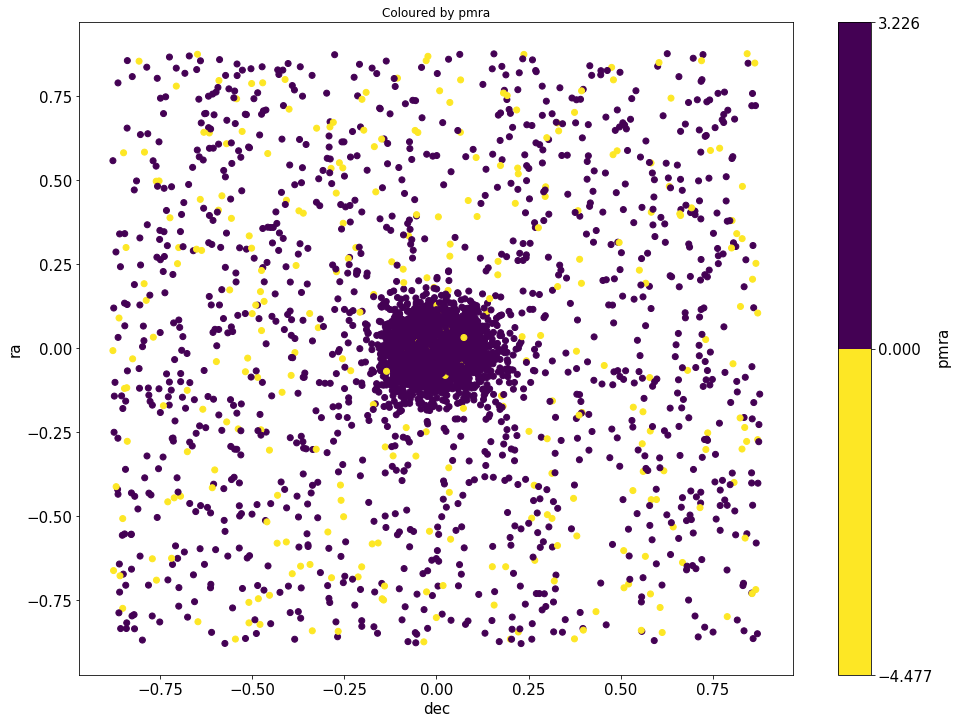

[-4.4769013820483847, 0, 3.2258286513781704]


In [14]:
# Another attempt at colouring - using normalized colouring in matplotlib

import matplotlib.colors as colors

ra_ic3=GlobClust_Log_ra[Cluster3] #np.multiply(rpbp_i,Cluster)
dec_ic3=GlobClust_Log_dec[Cluster3] #multiply(M_i,Cluster)
pmdec_ic3=GlobClust_Log_pmdec[Cluster3]
pmra_ic3=GlobClust_Log_pmra[Cluster3]

pmdec_norm2 = (pmdec_ic3 - np.nanmean(pmdec_ic3[Survive2])) / (4*np.nanmean(pmdec_ic3[Survive2]))
pmra_norm2 = (pmra_ic3 - np.nanmean(pmra_ic3[Survive2])) / (4*np.nanmean(pmra_ic3[Survive2]))

#caraay=[cm.magma_r((3.5-2.5)/2.5),cm.magma_r(0),cm.magma_r((2.8-2.5)/2.5),cm.magma_r((3-2.5)/2.5),cm.magma_r((3.2-2.5)/2.5),\
#        cm.magma_r((3.5-2.5)/2.5),cm.magma_r((3.8-2.5)/2.5),cm.magma_r((4-2.5)/2.5),cm.magma_r((5-2.5)/2.5)]

fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c=pmdec_ic3, cmap='inferno', 
            norm=colors.SymLogNorm(vmin=np.nanmin(pmdec_ic3), vmax=np.nanmax(pmdec_ic3), linthresh=0.03, ),)#edgecolors='k')
#           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
plt.gca().tick_params(labelsize=15)

bounds=[np.nanmin(pmra_ic3), np.nanmean(pmra_ic3), 0, np.nanmax(pmra_ic3)]
normbounds = [np.nanmin(pmra_norm2), 0, np.nanmax(pmra_norm2)]
fig=plt.figure(figsize=(16,12))
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c=pmra_ic3, cmap='viridis_r',
           norm=colors.BoundaryNorm(normbounds, ncolors=256))#edgecolors='k')
#           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
plt.gca().tick_params(labelsize=15)
plt.show()

print(normbounds)

In [272]:
print([np.nanmin(pmdec_norm2)/fabs(np.nanmean(pmdec_ic3)), 0, np.nanmax(pmdec_norm2)/fabs(np.nanmean(pmdec_ic3))])

[-0.51453600754776896, 0, 1.4547958498838729]


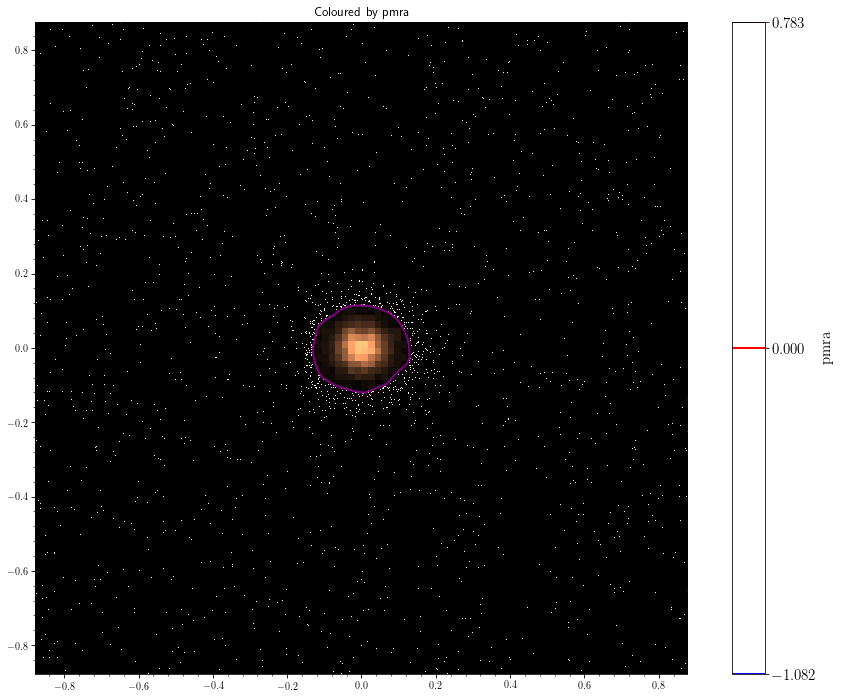

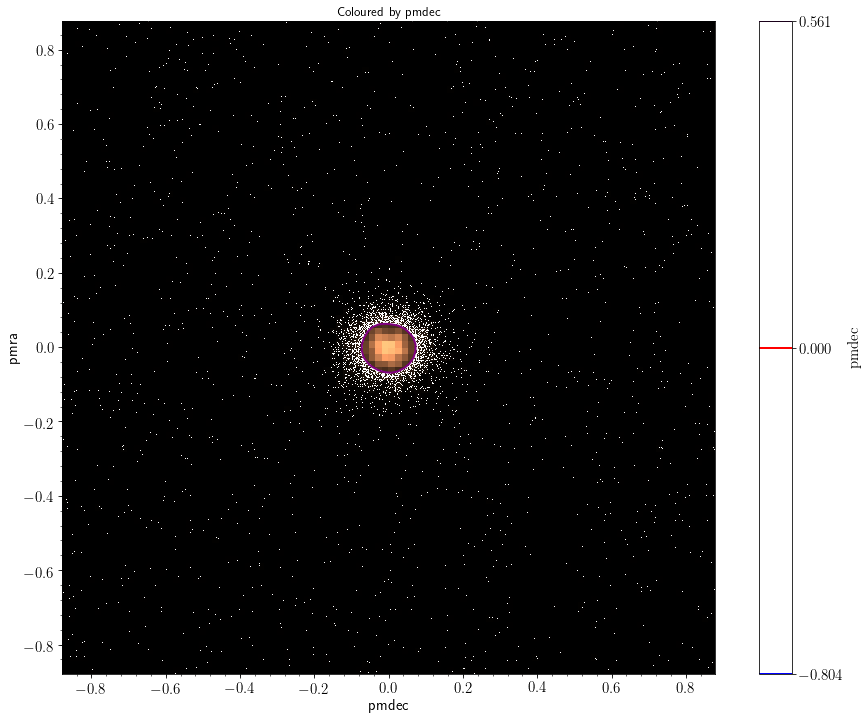

[0.80816468921939955, 0, -0.56359995966626064]


In [16]:
# PLOT RA-DEC FROM MATCHING CMD - USING BOVY PLOTS
# RUN AFTER PREVIOUS CELLS

from galpy.util import bovy_plot

ra_ic3=GlobClust_Log_ra[Cluster3] #np.multiply(rpbp_i,Cluster)
dec_ic3=GlobClust_Log_dec[Cluster3] #multiply(M_i,Cluster)
pmdec_ic3=GlobClust_Log_pmdec[Cluster3]
pmra_ic3=GlobClust_Log_pmra[Cluster3]

#bounds_pmra=[np.nanmin(pmra_ic3), np.nanmean(pmra_ic3), 0, np.nanmax(pmra_ic3)]
#normbounds_pmra = [np.nanmin(pmra_norm2), 0, np.nanmax(pmra_norm2)]
#bounds_pmdec=[np.nanmin(pmdec_ic3), np.nanmean(pmdec_ic3), 0, np.nanmax(pmdec_ic3)]
#normbounds_pmdec = [np.nanmin(pmdec_norm2), 0, np.nanmax(pmdec_norm2)]

#caraay=[cm.magma_r((3.5-2.5)/2.5),cm.magma_r(0),cm.magma_r((2.8-2.5)/2.5),cm.magma_r((3-2.5)/2.5),cm.magma_r((3.2-2.5)/2.5),\
#        cm.magma_r((3.5-2.5)/2.5),cm.magma_r((3.8-2.5)/2.5),cm.magma_r((4-2.5)/2.5),cm.magma_r((5-2.5)/2.5)]

#fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
bovy_plot.bovy_print(fig_width=16,fig_height=12)
bovy_plot.scatterplot(ra_ic3-coord_ra_dec.ra.deg,dec_ic3-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3), 
                    #'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmra_norm2)/np.nanmean(pmra_ic3[Survive2]), 0, np.nanmax(pmra_norm2)/np.nanmean(pmra_ic3[Survive2])],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                     cmap='copper',
                        cntrcolors=['blue','red','purple'],#,'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        )
                     #colorbar=True,
                     #xrange=[-0.5,0.5], yrange=[0.5,-0.5])#,
                      #bins=101)
                      #levels=[0.02,0.06,0.12,0.21,0.33,0.50,0.68,0.80,0.90,0.95],
                      #contours=False,
                     #xlabel=r'$X\,(\mathrm{kpc})$',
                     #ylabel=r'$X\,(\mathrm{kpc})$')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.title('Coloured by pmra')
                    
bovy_plot.scatterplot(ra_ic3-coord_ra_dec.ra.deg,dec_ic3-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3), 
                    #'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmdec_norm2)/fabs(np.nanmean(pmdec_ic3[Survive2])), 0, np.nanmax(pmdec_norm2)/fabs(np.nanmean(pmdec_ic3[Survive2]))],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                     cmap='copper',
                        cntrcolors=['blue','red','purple'],#,'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.title('Coloured by pmdec')

plt.xlabel('pmdec', fontsize=15)
plt.ylabel('pmra', fontsize=15)
#plt.legend()
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
plt.gca().tick_params(labelsize=15)
plt.show()

#print(normbounds/fabs(np.nanmean(pmdec_ic3)))
print([np.nanmin(pmdec_norm2)/np.nanmean(pmdec_ic3), 0, np.nanmax(pmdec_norm2)/np.nanmean(pmdec_ic3)])

In [55]:
shape(GC_pmradec)
pywt.dwt_max_level(16258, 2)
shape(pmra_norm2)
GC_pmdec

array([ nan,  nan,  nan, ...,  nan,  nan,  nan])

In [66]:
# Wavelet Transform plots for all 4 coefficients
# plots in proper motions

import pywt

GC_pmra=pmra_norm2
GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_norm2
GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (3765,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (3765,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=2, start_level=0, axes=1)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure()
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=50, cntrSmooth=True)

cb=plt.colorbar()
plt.show()


# Wavelet transform plotting all 4 coefficients
# plots in radec

import pywt

GC_radec = {'ra': ra_ic3-coord_ra_dec.ra.deg, 'dec': dec_ic3-coord_ra_dec.dec.deg}
GC_radec = pd.DataFrame(GC_radec)
#GC_radec.as_matrix()

GC_pmra=pmra_norm2
GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_norm2
GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (3765,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (3765,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=1, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure()
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=50, cntrSmooth=True)

cb=plt.colorbar()
plt.show()


TypeError: 'int' object is not iterable

### Cutting out the cluster for colouring the maps

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:96: RuntimeWarning: divide by zero encountered in true_divide

/home/kaderali/local/lib/python3.6/site-packages/galpy/util/bovy_plot.py:993: RuntimeWarning: invalid value encountered in greater
  plotx= x[cums > levels[-1]]

/home/kaderali/local/lib/python3.6/site-packages/galpy/util/bovy_plot.py:994: RuntimeWarning: invalid value encountered in greater
  ploty= y[cums > levels[-1]]



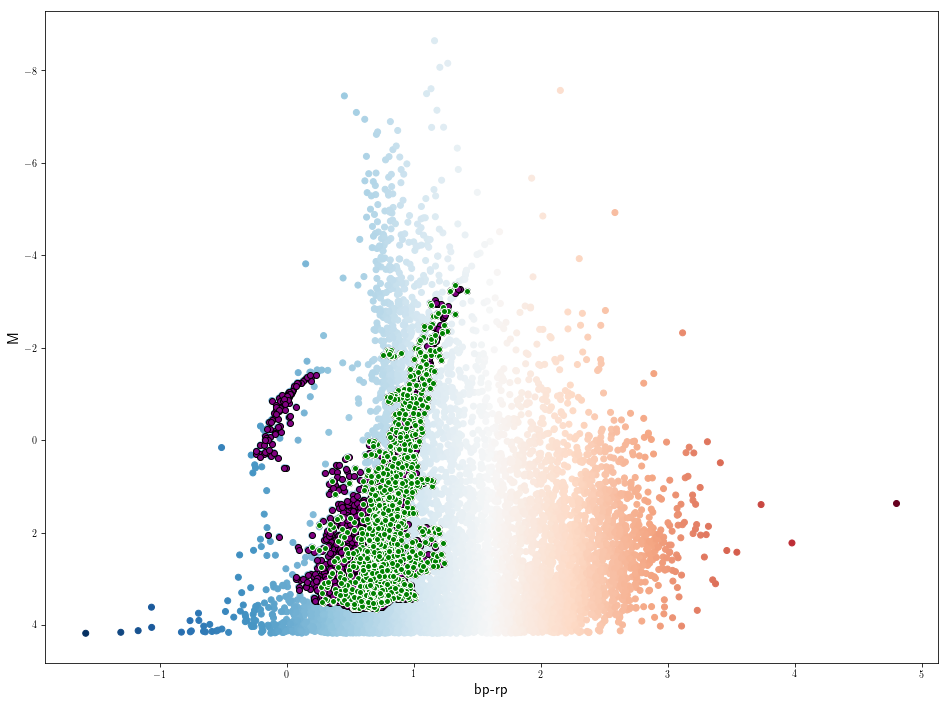

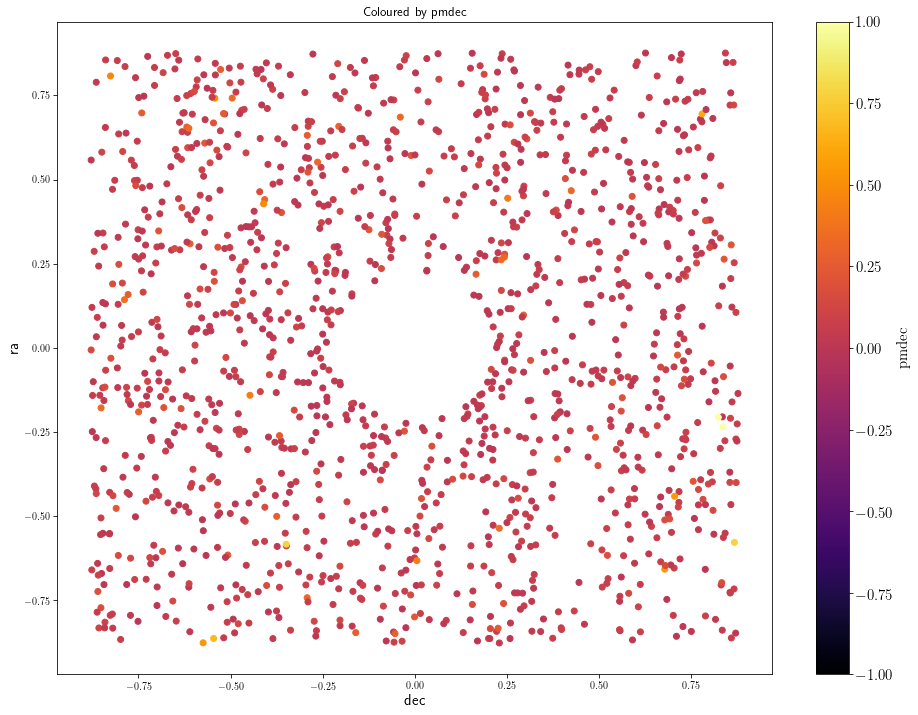

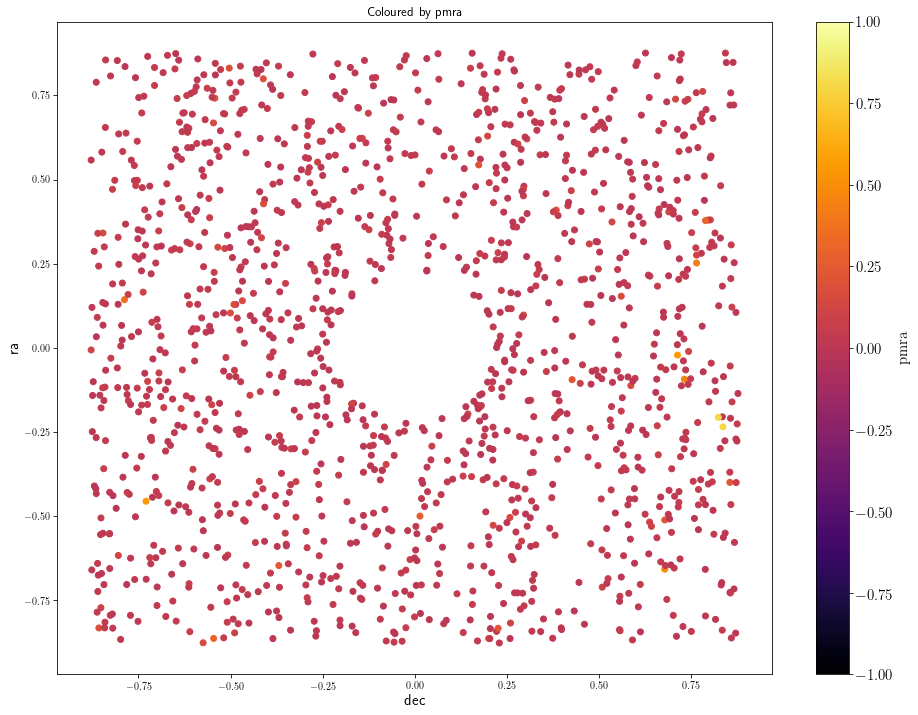

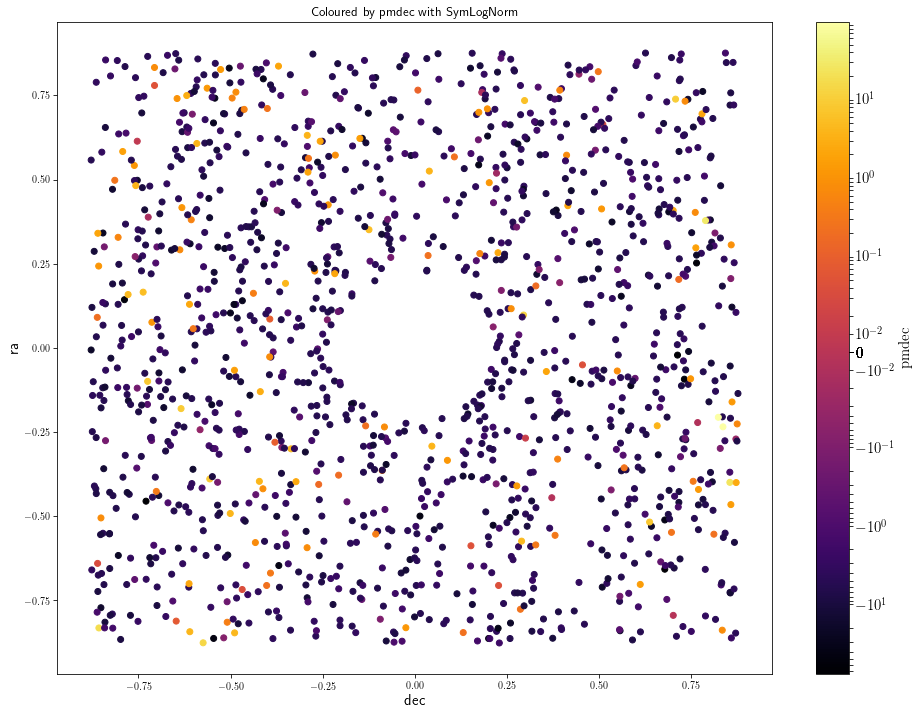

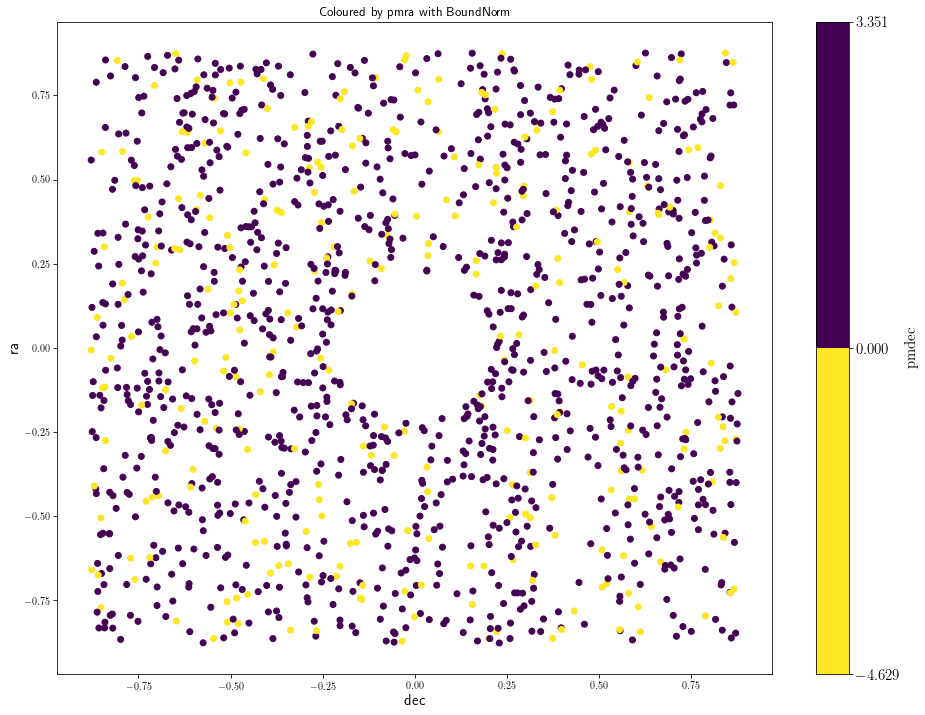

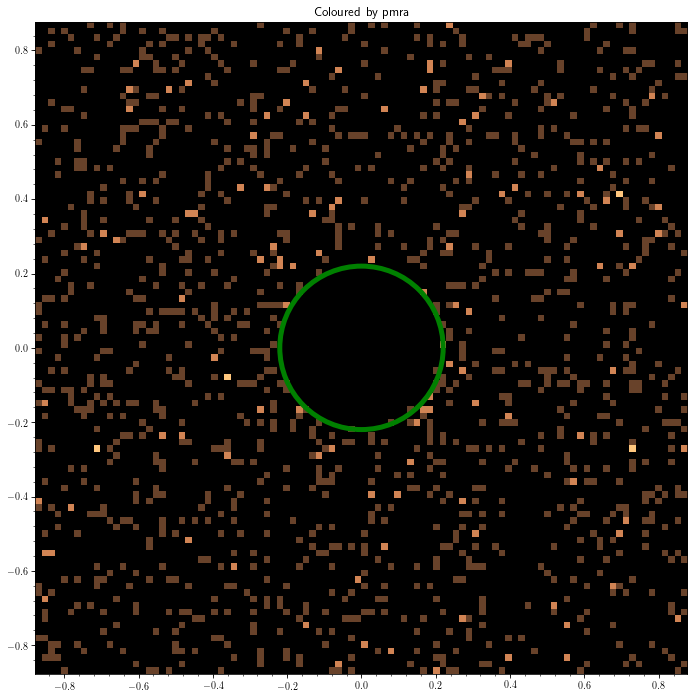

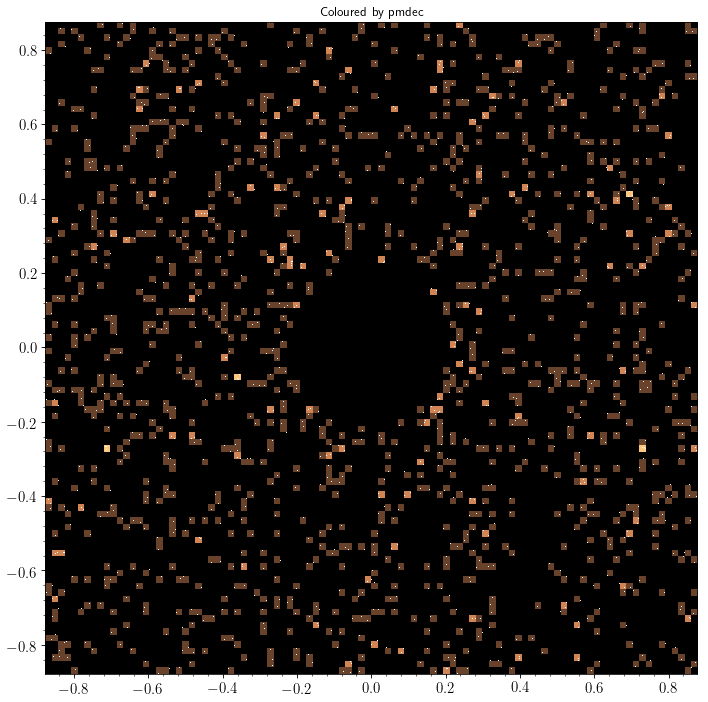

In [20]:
GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[:,"r_t"]
Tidal_Edge = GlobClust_Log_r_t.loc[0]

#Survive = (sqrt((np.fabs(ra_ic3-ra_ic3.mean())**2+np.fabs(dec_ic3-dec_ic3.mean())**2))<5/60)
#Survive = (sqrt((np.fabs(ra_ic3-ra_ic3.mean())**2+np.fabs(dec_ic3-dec_ic3.mean())**2))<Tidal_Edge/60)
#Survive = [not i for i in Survive]

ra_outer=ra_ic3[Survive] #np.multiply(rpbp_i,Cluster)
dec_outer=dec_ic3[Survive] #multiply(M_i,Cluster)
pmdec_outer=pmdec_ic3[Survive]
pmra_outer=pmra_ic3[Survive]
rpbp_outer=rpbp_ic3[Survive]
M_outer=M_ic3[Survive]

#pmdec_norm2 = (pmdec_ic3 - np.nanmean(pmdec_ic3)) / (4*np.nanmean(pmdec_ic3))
#pmra_norm2 = (pmra_ic3 - np.nanmean(pmra_ic3)) / (4*np.nanmean(pmra_ic3))

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=rpbp_outer, y=M_outer, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Scatter pmra (ra-dec)
fig=plt.figure(figsize=(16,12))
plt.scatter(x=ra_outer-coord_ra_dec.ra.deg, y=dec_outer-coord_ra_dec.dec.deg, 
            c=np.fabs(pmra_norm2[Survive]/np.nanmean(pmra_ic3[Survive2])), cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter pmdec (ra-dec)
fig=plt.figure(figsize=(16,12))
plt.scatter(x=ra_outer-coord_ra_dec.ra.deg, y=dec_outer-coord_ra_dec.dec.deg, 
            c=np.fabs(pmdec_norm2[Survive]/np.nanmean(pmdec_ic3[Survive2])), cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by Symlog
fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_outer-coord_ra_dec.ra.deg, y=dec_outer-coord_ra_dec.dec.deg, c=pmdec_outer, cmap='inferno', 
            norm=colors.SymLogNorm(vmin=np.nanmin(pmdec_outer), vmax=np.nanmax(pmdec_outer), linthresh=0.03, ),)#edgecolors='k')
#           vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec with SymLogNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by BoundNorm
bounds=[np.nanmin(pmra_outer), np.nanmean(pmra_outer), 0, np.nanmax(pmra_outer)]
normbounds = [np.nanmin(pmra_norm2), 0, np.nanmax(pmra_norm2)]
fig=plt.figure(figsize=(16,12))
plt.scatter(x=ra_outer-coord_ra_dec.ra.deg, y=dec_outer-coord_ra_dec.dec.deg, c=pmra_outer, cmap='viridis_r',
           norm=colors.BoundaryNorm(normbounds, ncolors=256)#edgecolors='k')
           ,vmin=-1, vmax=1)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra with BoundNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Bovy Plots
fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.bovy_print(fig_width=16,fig_height=12)
bovy_plot.scatterplot(ra_outer-coord_ra_dec.ra.deg,dec_outer-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3),'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmra_ic3)/20/np.nanmean(pmra_ic3/[Survive2]), 0, np.nanmax(pmra_ic3)/20/np.nanmean(pmra_ic3/[Survive2])],# GlobClust_Log_r_t[0]/60],
                      #levels=[np.nanmin(pmra_norm2)/np.nanmean(pmra_ic3), 0, np.nanmax(pmra_norm2)/np.nanmean(pmra_ic3)],# GlobClust_Log_r_t[0]/60],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        gcf=True)
                     #colorbar=True,
                     #xrange=[-0.5,0.5], yrange=[0.5,-0.5])#,
                      #bins=101)
                      #levels=[0.02,0.06,0.12,0.21,0.33,0.50,0.68,0.80,0.90,0.95],
                      #contours=False,
                     #xlabel=r'$X\,(\mathrm{kpc})$',
                     #ylabel=r'$X\,(\mathrm{kpc})$')
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
#cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.title('Coloured by pmra')
                    
bovy_plot.scatterplot(ra_outer-coord_ra_dec.ra.deg,dec_outer-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3), 
                      #'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmdec_norm2)/(2*fabs(np.nanmean(pmdec_ic3[Survive2]))), 0, np.nanmax(pmdec_norm2)/(2*fabs(np.nanmean(pmdec_ic3[Survive2])))],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#,'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        )
#cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.title('Coloured by pmdec')



plt.gca().tick_params(labelsize=15)
plt.show()

In [177]:
shape(WT2)
pd.DataFrame(WT2_aa)
pywt.swt_max_level(len(pmra_outer))
shape(GC_pmradec)

(2089, 2)

[-121.51794462 -121.15319299  -79.89261611 ...,   79.89261611  121.15319299
  121.51794462]
[-63.11238764 -63.11238764 -56.23291727 ...,  41.2641098   41.9635673
  41.9635673 ]
[-121.51794462 -121.15319299  -79.89261611 ...,   79.89261611  121.15319299
  121.51794462]
[]


ValueError: Contour levels must be increasing

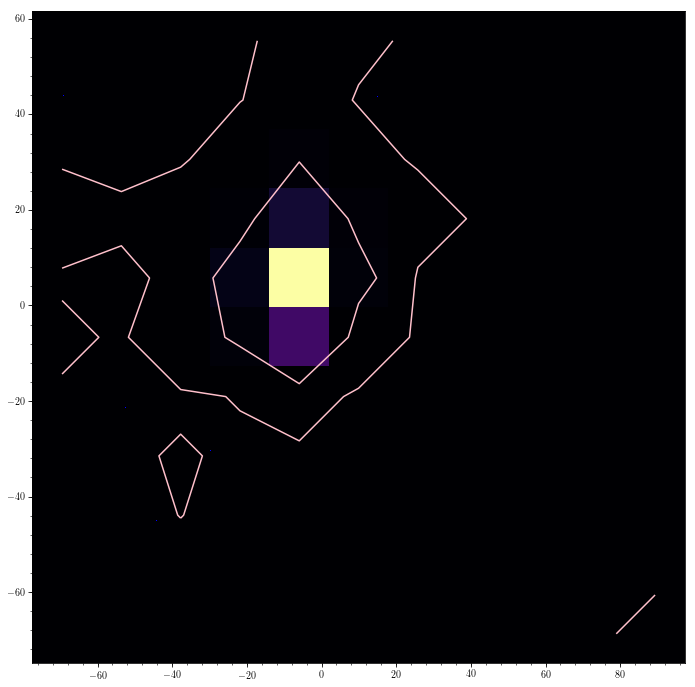

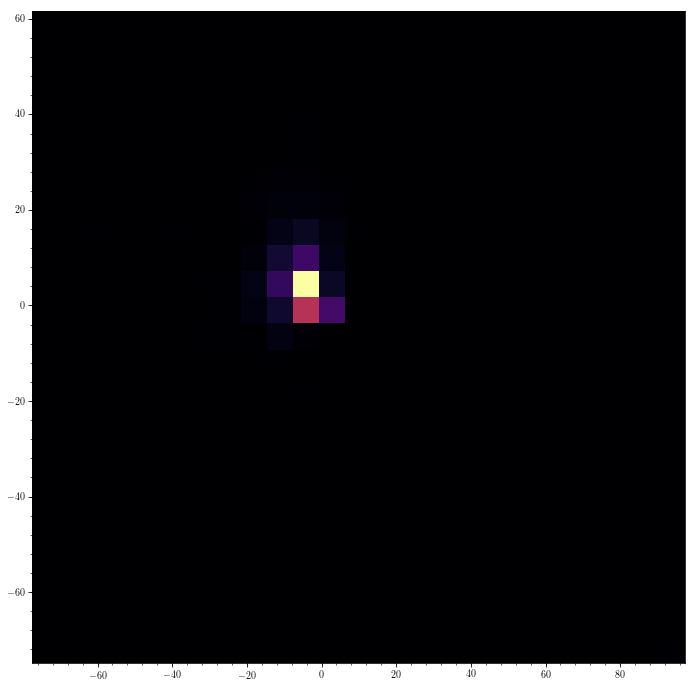

In [21]:
## import pywt
# Trying other types of WTs

GC_pmra=pmra_outer
#GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_outer
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (309,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (309,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swt(GC_pmradec.as_matrix(), 'db2', level=1, start_level=0)
WT2

#WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2[0]#.get("aa")[:,0]
#WT2_aa = WT2
WT2_aa=np.array(WT2_aa)
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
#WT2_aa = WT2_aa[::-1]
print(WT2_aa)

#WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2[0][0]
WT2_ad=np.array(WT2_ad)
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

#WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2[0][1]
WT2_da=np.array(WT2_da)
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

#WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2[0][0][1]
WT2_dd=np.array(WT2_dd)
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure()
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'])#, levels=WT2_aa, bins=25, cntrSmooth=True)#, xrange=[-12, 12], yrange=[-12,12])

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=25, cntrSmooth=True)#, xrange=[-12, 12], yrange=[-12,12])

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=25, cntrSmooth=True)#, xrange=[-12, 12], yrange=[-12,12])

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=25, cntrSmooth=True)#, xrange=[-12, 12], yrange=[-12,12])

cb=plt.colorbar()
plt.show()


In [215]:
# install did not work
import mlpy.wavelet as wave

ModuleNotFoundError: No module named 'mlpy'

In [185]:
shape(pmra_outer)

(1471,)

In [14]:
pmra_ic3.mean()
Clust_Edge[5]
np.sum(Survive2)
shape(pmra_outer)
pmdec_ic3[Survive2]
pd.DataFrame(WT2_aa)

,0
0,-121.517945
1,-121.153193
2,-111.375995
3,-94.901158
4,-94.901158
5,-79.892616
6,-78.882671
7,-70.387068
8,-63.112388
9,-63.112388


[-42.25806732 -41.43512067 -36.28758857 ...,  32.61366425  34.35659608
  38.02156512]
[-82.57114601 -81.38454114 -75.99006091 ...,  50.20949937  54.50815541
  58.01882603]
[-40.81566026 -29.05285453 -28.74808151 ...,  28.1153526   37.23627683
  40.30532298]
[-89.39641108 -87.42470975 -51.25012154 ...,  56.06747217  80.76182134
  81.32584069]


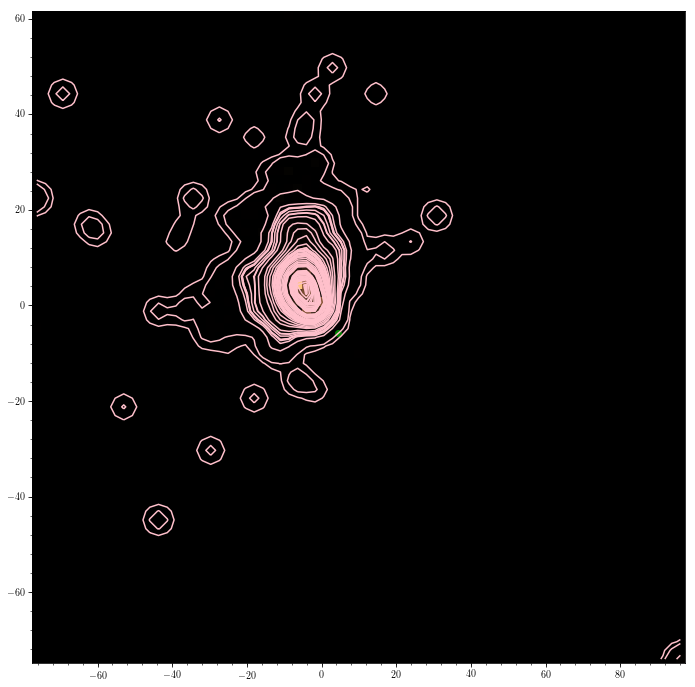

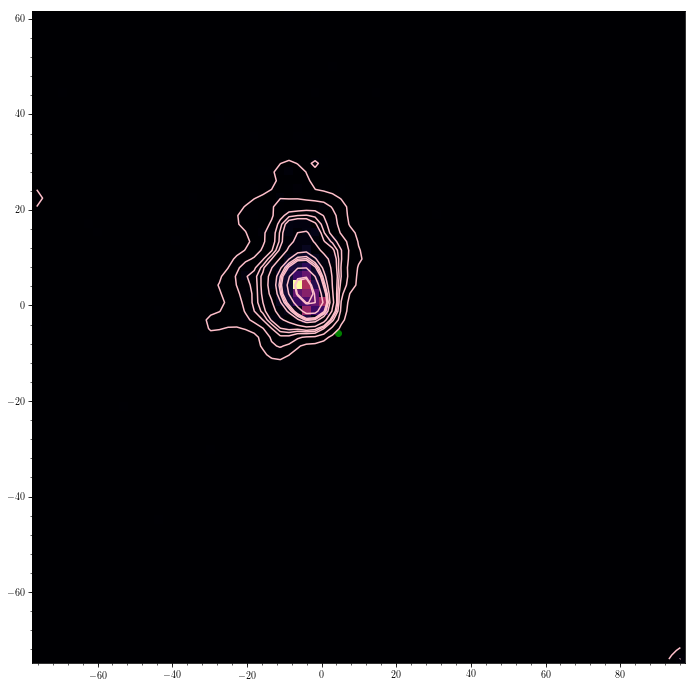

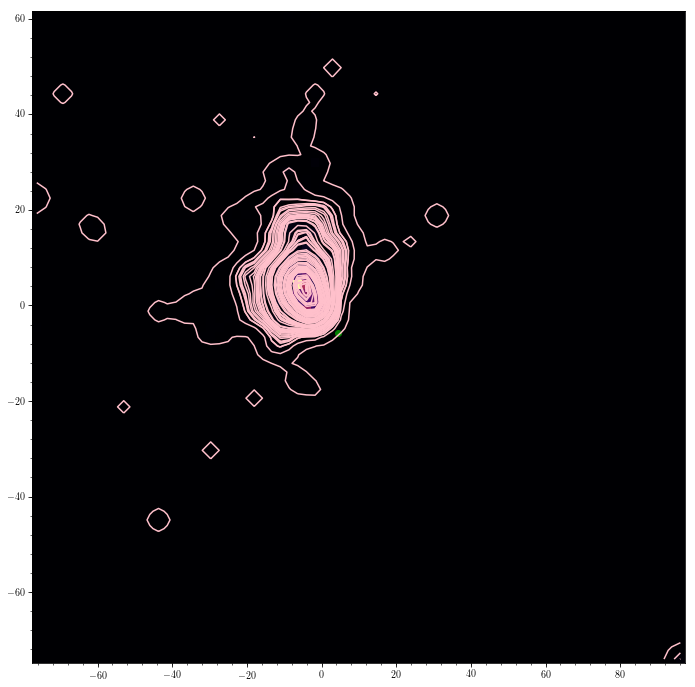

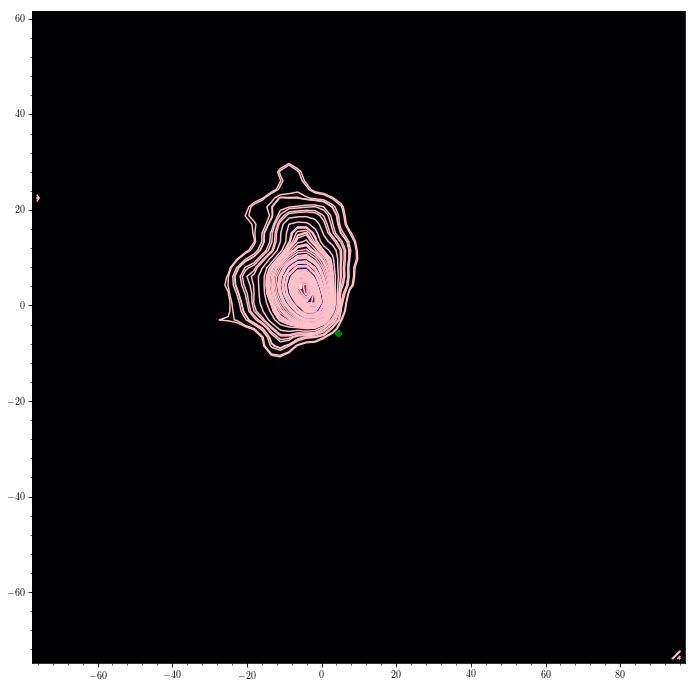

In [22]:
import pywt

#Survive2 = (sqrt((np.fabs(pmra_ic3-pmra_ic3.mean())**2+np.fabs(pmdec_ic3-pmdec_ic3.mean())**2))<Tidal_Edge[5]/60)
#Survive2 = [not i for i in Survive]

GC_pmra=pmra_outer
#GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_outer
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (322,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (322,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=1, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
#WT2_aa=WT2_aa/20
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b.',
                     cmap='copper', cntrcolors=['pink'], levels=WT2_aa, bins=75, cntrSmooth=True, gcf=True)#, xrange=[-12, 12], yrange=[-12,12])
plt.scatter(np.nanmean(pmra_ic3[Survive2]), np.nanmean(pmdec_ic3[Survive2]), c='g')

fig=figure(figsize=(16,12))
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True, gcf=True)#, xrange=[-12, 12], yrange=[-12,12])
plt.scatter(np.nanmean(pmra_ic3[Survive2]), np.nanmean(pmdec_ic3[Survive2]), c='g')

fig=figure(figsize=(16,12))
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=75, cntrSmooth=True, gcf=True)#, xrange=[-12, 12], yrange=[-12,12])
plt.scatter(np.nanmean(pmra_ic3[Survive2]), np.nanmean(pmdec_ic3[Survive2]), c='g')

fig=figure(figsize=(16,12))
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=75, cntrSmooth=True, gcf=True)#, xrange=[-12, 12], yrange=[-12,12])
plt.scatter(np.nanmean(pmra_ic3[Survive2]), np.nanmean(pmdec_ic3[Survive2]), c='g')


#bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix()/20, GC_pmradec.loc[:,"pmra"].dropna().as_matrix()/20, 'b,',
#                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=25, cntrSmooth=True)#, xrange=[-12, 12], yrange=[-12,12])

#bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix()/20, GC_pmradec.loc[:,"pmra"].dropna().as_matrix()/20, 'b,',
#                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=25, cntrSmooth=True, xrange=[-12, 12], yrange=[-12,12])

#bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix()/20, GC_pmradec.loc[:,"pmra"].dropna().as_matrix()/20, 'b,',
#                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=25, cntrSmooth=True, xrange=[-12, 12], yrange=[-12,12])

#bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix()/20, GC_pmradec.loc[:,"pmra"].dropna().as_matrix()/20, 'b,',
#                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=25, cntrSmooth=True, xrange=[-12, 12], yrange=[-12,12])


#cb=plt.colorbar()
plt.show()


In [22]:
shape(pmra_outer)
#shape(GC_pmradec)

(1404,)

[-42.25806732 -41.43512067 -36.28758857 ...,  32.61366425  34.35659608
  38.02156512]
[-82.57114601 -81.38454114 -75.99006091 ...,  50.20949937  54.50815541
  58.01882603]
[-40.81566026 -29.05285453 -28.74808151 ...,  28.1153526   37.23627683
  40.30532298]
[-89.39641108 -87.42470975 -51.25012154 ...,  56.06747217  80.76182134
  81.32584069]


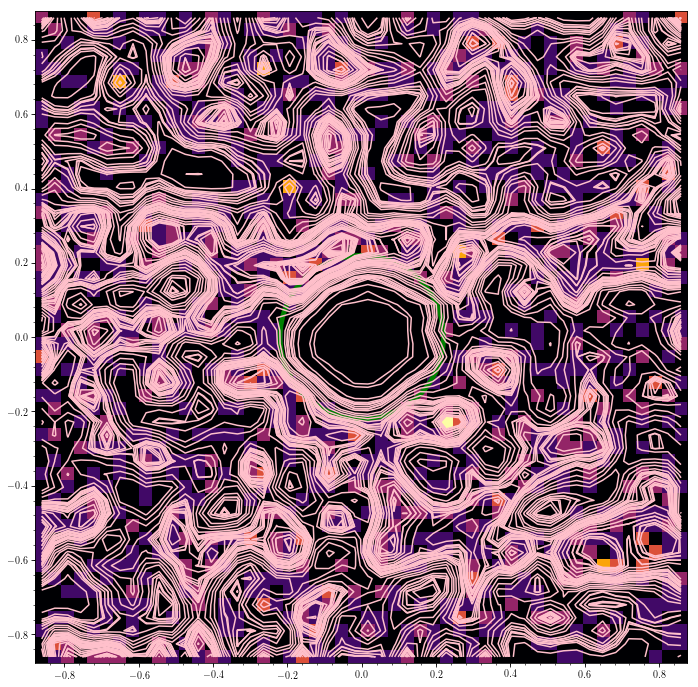

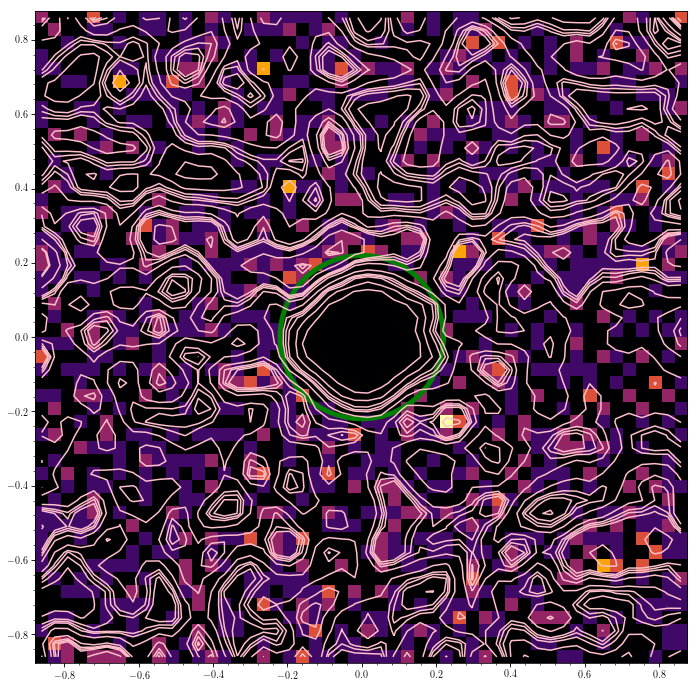

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


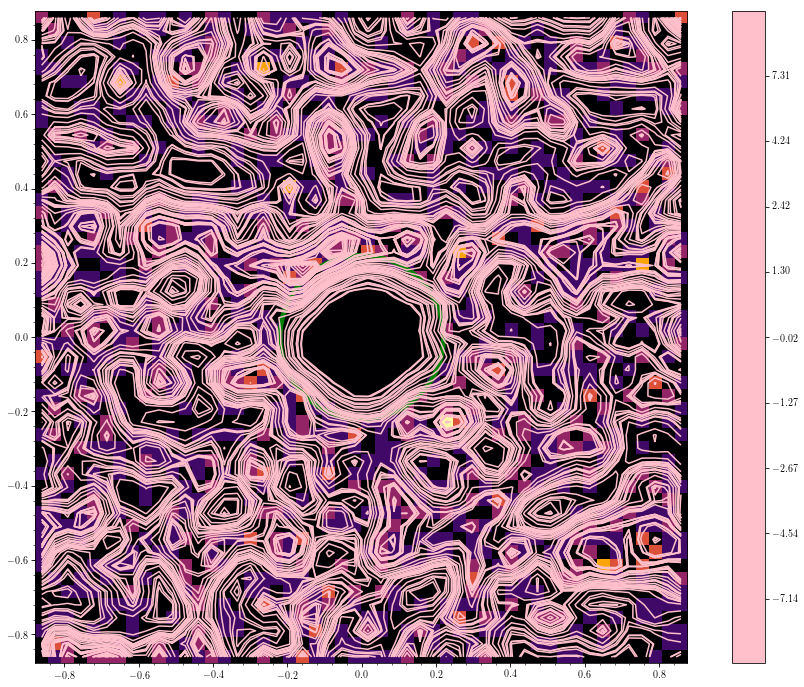

In [23]:
# Wavelet transform plotting all 4 coefficients
# plots in radec

import pywt

GC_radec = {'ra': ra_outer-coord_ra_dec.ra.deg, 'dec': dec_outer-coord_ra_dec.dec.deg}
GC_radec = pd.DataFrame(GC_radec)
#GC_radec.as_matrix()

import pywt

GC_pmra=pmra_outer
#GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_outer
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (322,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (322,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=1, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

#e = np.e
#X, Y = np.meshgrid(np.linspace(0, 5, 100), np.linspace(0, 5, 100))
#F = X ** Y
#G = Y ** X



fig=figure(figsize=(16,12))
#ax=fig.add_subplot(1,1,1)
ax = plt.gca()
#ax2 = bovy_plot.bovy_print( fig_size =  [16,12])
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=50, cntrSmooth=True, gcf=True)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
#ax2.add_axes(bovy1)
ax.add_artist(circle)

fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=50, cntrSmooth=True, gcf=True)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)

fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=50, cntrSmooth=True, gcf=True)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
            
fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=50, cntrSmooth=True, gcf=True)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)

cb=plt.colorbar()

#plt.plot([GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], [-GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], 'b-', lw=2)
#plt.plot([-GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], [GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], 'b-', lw=2)
#plt.plot([-GlobClust_Log_r_t/60, -GlobClust_Log_r_t/60], [-GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], 'b-', lw=2)
#plt.plot([-GlobClust_Log_r_t/60, GlobClust_Log_r_t/60], [-GlobClust_Log_r_t/60, -GlobClust_Log_r_t/60], 'b-', lw=2)


#ax = fig.add_plot()
#circ=plt.Circle((0, 0), radius=GlobClust_Log_r_t[0]/60, color='g')#, NoFill=True)
#plt.contour(X, Y, (F - G), [0])
#ax.add_patch(circ)
#plt.show()

plt.show()


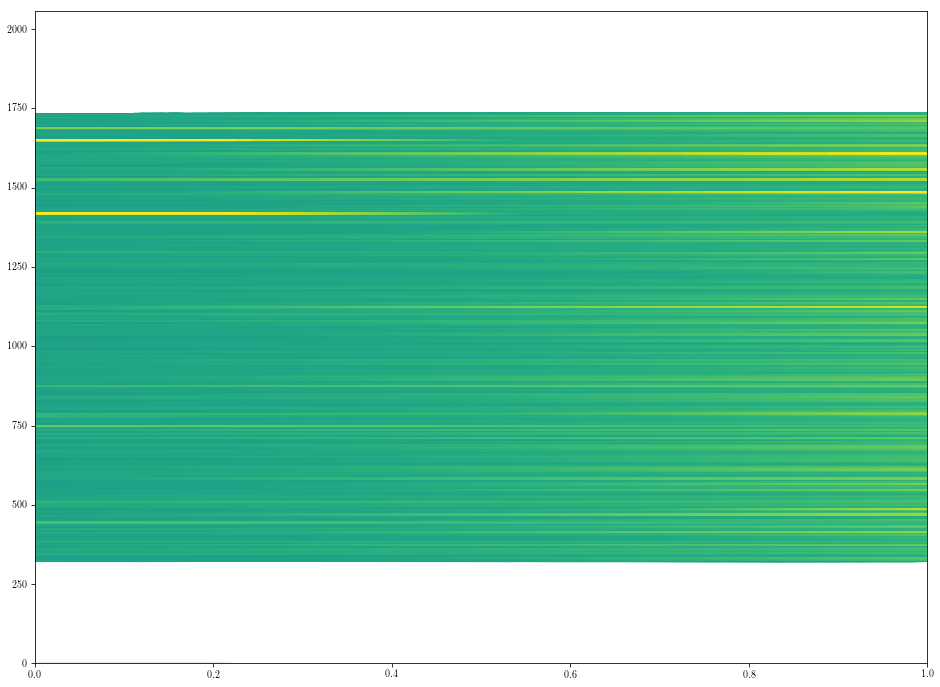

In [24]:
plt.figure()
ax=plt.gca()
plt.contour(GC_pmradec, levels=WT2_ad)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False)
ax.add_artist(circle)
plt.show()

#### Adding parallax and taking stars away that are close with good errors

In [25]:
# Set up
GlobClust_Log_parallax_out = GlobClust_Log_CMD.loc[:,"parallax"]
GlobClust_Log_parallaxerror_out = GlobClust_Log_CMD.loc[:,"parallax_error"]

GlobClust_Log_parallaxe_out = GlobClust_Log_CMD.loc[:,"parallax":"parallax_error"]
GlobClust_Log_parallaxe_out

GlobClust_Log_parallaxover_out = GlobClust_Log_parallaxerror_out/GlobClust_Log_parallax_out

parallax_indx = (GlobClust_Log_parallaxover_out>0.20) | ((1/GlobClust_Log_parallax_out>5.)*(GlobClust_Log_parallaxover_out<0.20))

GlobClust_Log_parallaxover_out[parallax_indx]
GlobClust_Log_parallaxerror_out[parallax_indx]
GlobClust_Log_parallaxe_out[indx][parallax_indx]
#GlobClust_Log_parallaxover_out[indx_parallax]

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  



,parallax,parallax_error
37,0.809683,1.516089
54,0.167614,0.841768
80,1.455520,0.785869
153,0.893935,0.553203
173,2.674876,0.843261
201,0.083099,0.836107
219,0.106936,0.028473
221,0.972085,0.981505
237,0.552141,0.250780
251,0.548595,0.242390


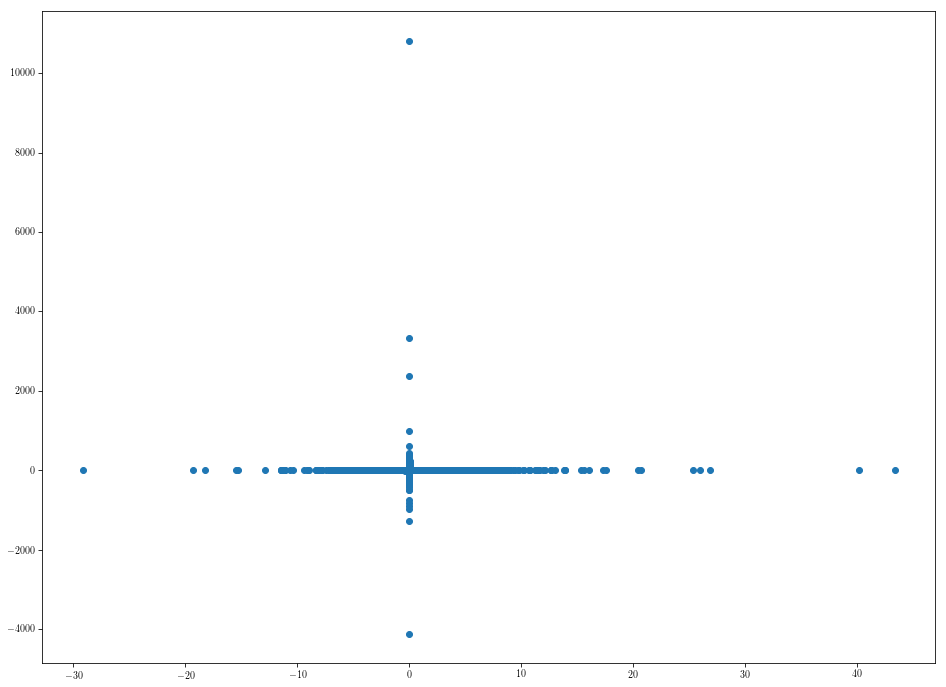

In [26]:
plt.scatter(GlobClust_Log_parallax_out, GlobClust_Log_parallaxover_out)

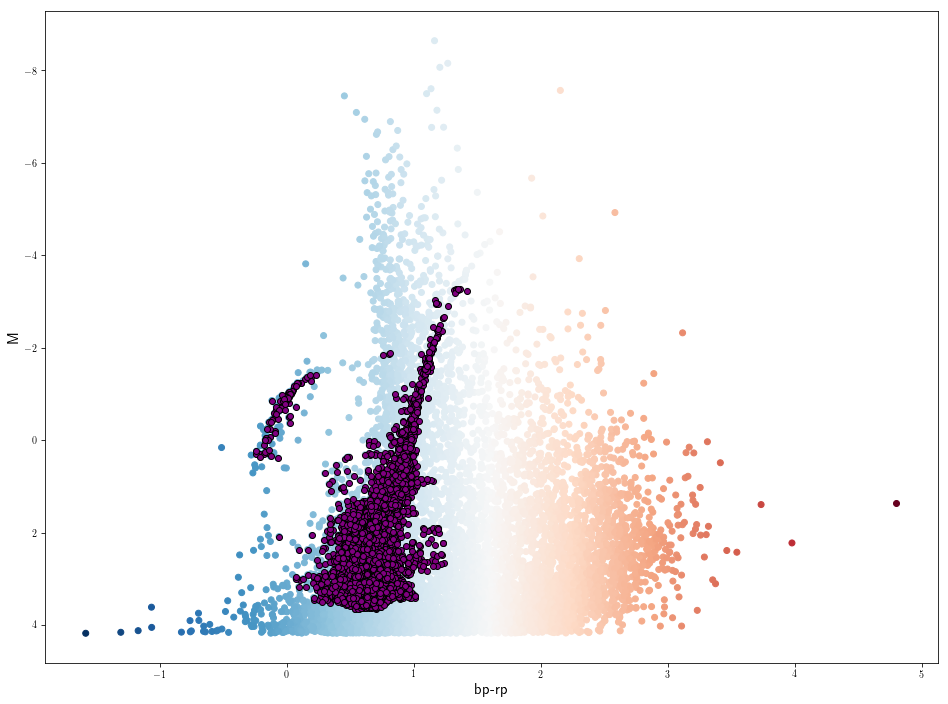

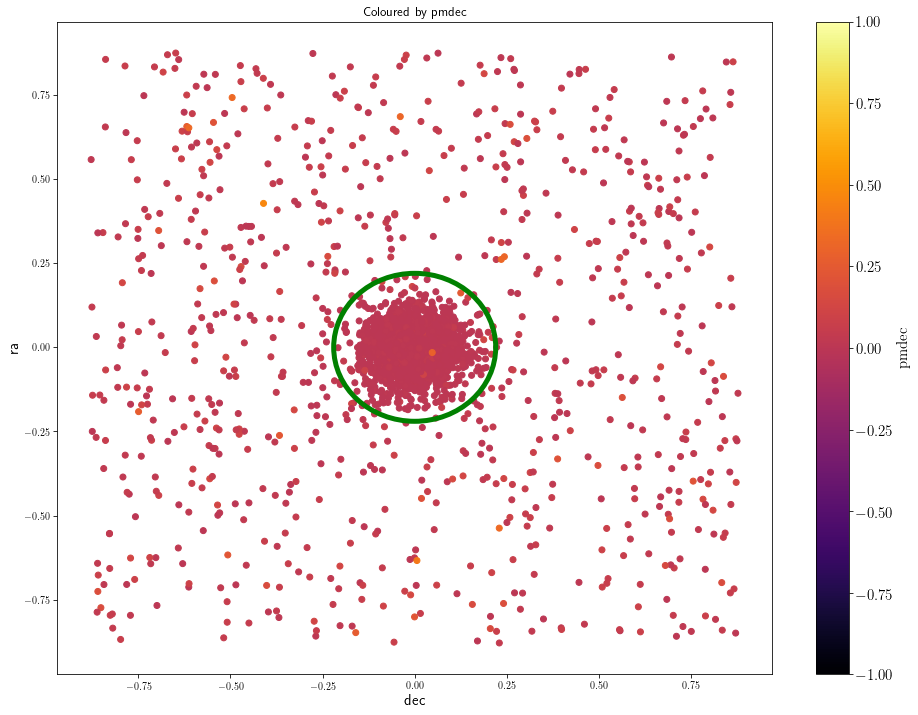

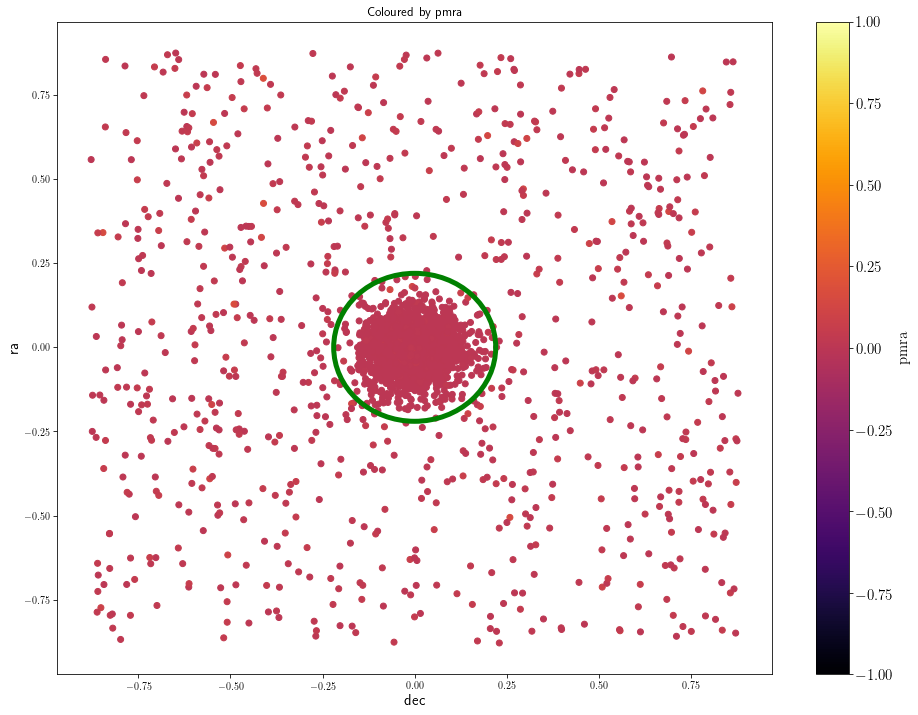

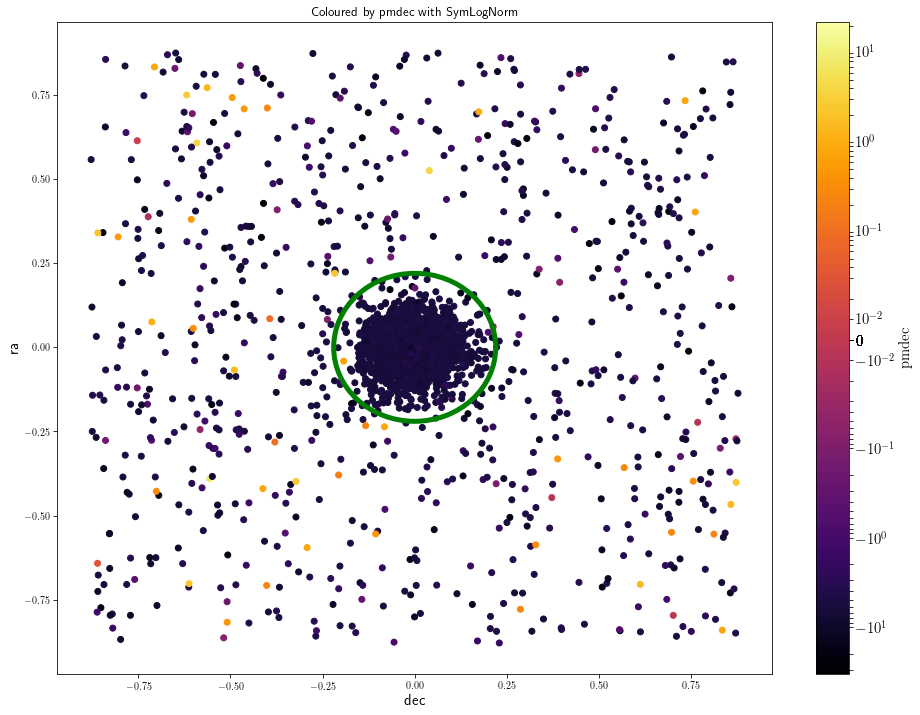

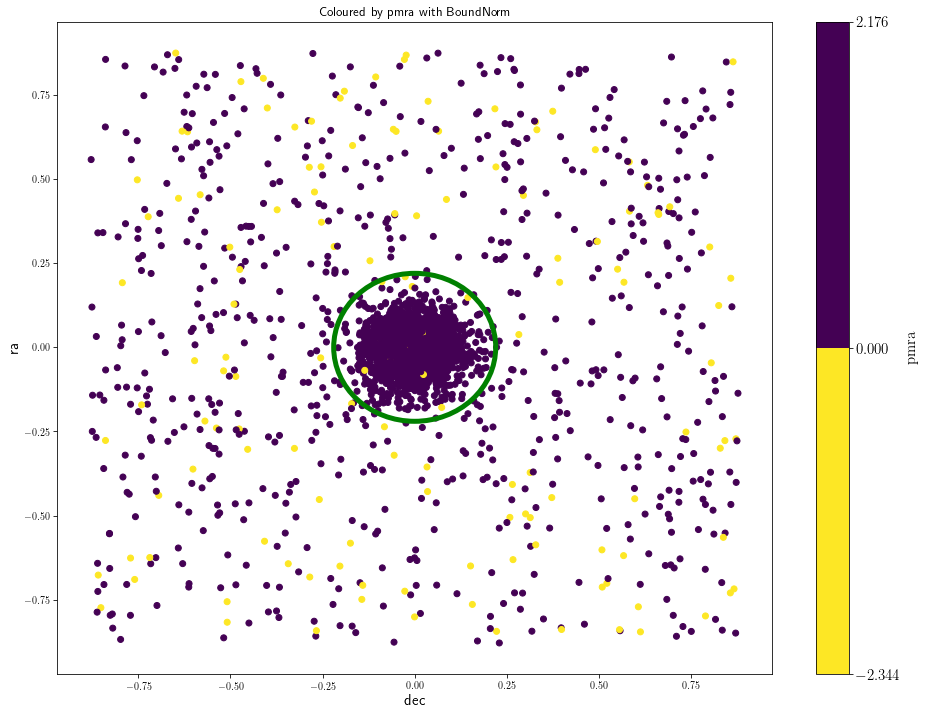

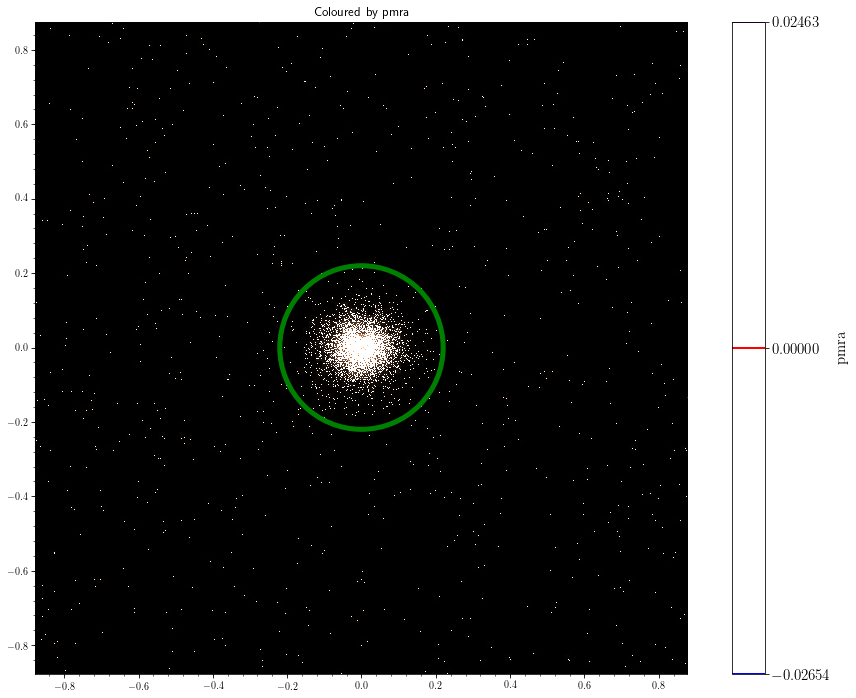

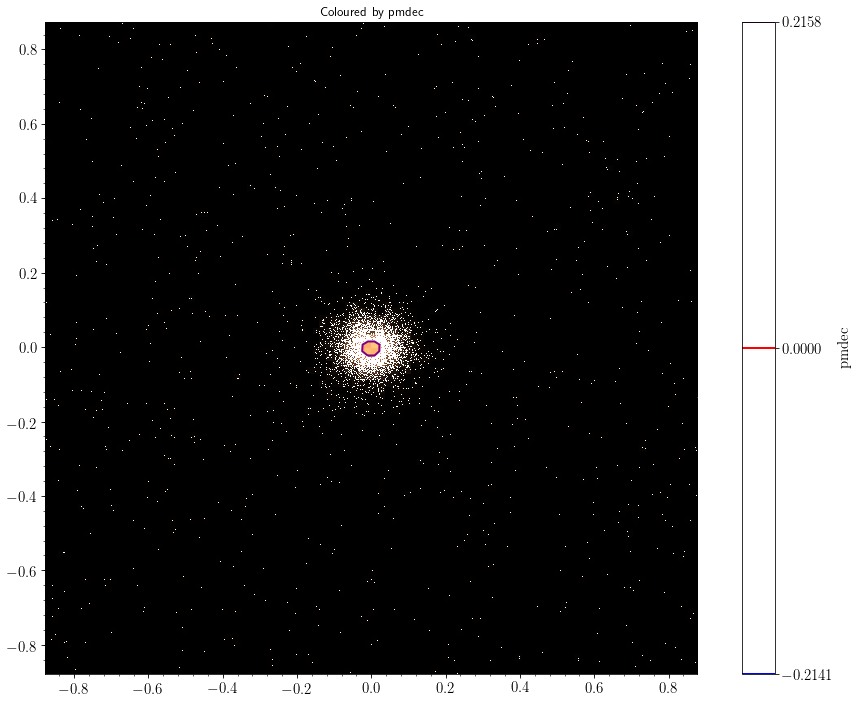

In [27]:
# Apply parallax_indx to current set w/ & w/out cluster w/in r_t

#first shorten parallax_indx
parallax_indx_3 = parallax_indx[Cluster3]

#apply data
ra_ic3_p = ra_ic3[parallax_indx_3]
#ra_ic3_p
dec_ic3_p = dec_ic3[parallax_indx_3]
#dec_ic3_p
pmra_ic3_p = pmra_ic3[parallax_indx_3]
#pmra_ic3_p
pmdec_ic3_p = pmdec_ic3[parallax_indx_3]
#pmdec_ic3_p
M_ic3_p = M_ic3[parallax_indx_3]
#M_ic3_p
rpbp_ic3_p = rpbp_ic3[parallax_indx_3]
#rpbp_ic3_p


#apply to plots
fig=plt.figure(figsize=(16,12))

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3_p, y=M_ic3_p, c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer, y=M_outer, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Scatter pmra (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_ic3_p-coord_ra_dec.ra.deg, y=dec_ic3_p-coord_ra_dec.dec.deg, 
            c=np.fabs(pmra_norm2[parallax_indx_3]/np.nanmean(pmra_ic3_p)), 
            cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter pmdec (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_ic3_p-coord_ra_dec.ra.deg, y=dec_ic3_p-coord_ra_dec.dec.deg, 
            c=np.fabs(pmdec_norm2[parallax_indx_3]/np.nanmean(pmdec_ic3_p)), cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by Symlog
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_ic3_p-coord_ra_dec.ra.deg, y=dec_ic3_p-coord_ra_dec.dec.deg, c=pmdec_ic3_p, cmap='inferno', 
            norm=colors.SymLogNorm(vmin=np.nanmin(pmdec_ic3_p), vmax=np.nanmax(pmdec_ic3_p), linthresh=0.03, ),)#edgecolors='k')
#           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec with SymLogNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by BoundNorm
bounds=[np.nanmin(pmra_ic3_p), np.nanmean(pmra_ic3_p), 0, np.nanmax(pmra_ic3_p)]
normbounds = [np.nanmin(pmra_norm2[parallax_indx_3]), 0, np.nanmax(pmra_norm2[parallax_indx_3])]
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_ic3_p-coord_ra_dec.ra.deg, y=dec_ic3_p-coord_ra_dec.dec.deg, c=pmra_ic3_p, cmap='viridis_r',
           norm=colors.BoundaryNorm(normbounds, ncolors=256)#edgecolors='k')
           ,vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra with BoundNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Bovy Plots
fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.bovy_print(fig_width=16,fig_height=12)
bovy_plot.scatterplot(ra_ic3_p-coord_ra_dec.ra.deg,dec_ic3_p-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3),'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmra_norm2[parallax_indx_3])/20/np.nanmean(pmra_ic3_p), 0, np.nanmax(pmra_norm2[parallax_indx_3])/20/np.nanmean(pmra_ic3_p)],# GlobClust_Log_r_t[0]/60],
                      #levels=[np.nanmin(pmra_norm2)/np.nanmean(pmra_ic3), 0, np.nanmax(pmra_norm2)/np.nanmean(pmra_ic3)],# GlobClust_Log_r_t[0]/60],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        gcf=True)
                     #colorbar=True,
                     #xrange=[-0.5,0.5], yrange=[0.5,-0.5])#,
                      #bins=101)
                      #levels=[0.02,0.06,0.12,0.21,0.33,0.50,0.68,0.80,0.90,0.95],
                      #contours=False,
                     #xlabel=r'$X\,(\mathrm{kpc})$',
                     #ylabel=r'$X\,(\mathrm{kpc})$')
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.title('Coloured by pmra')
                    
bovy_plot.scatterplot(ra_ic3_p-coord_ra_dec.ra.deg,dec_ic3_p-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3), 
                      #'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmdec_norm2[parallax_indx_3])/fabs(np.nanmean(pmdec_ic3_p)), 0, np.nanmax(pmdec_norm2[parallax_indx_3])/fabs(np.nanmean(pmdec_ic3_p))],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#,'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.title('Coloured by pmdec')



plt.gca().tick_params(labelsize=15)
plt.show()

In [31]:
GlobClust_Log_r_t[0]/60

0.21987837466666665

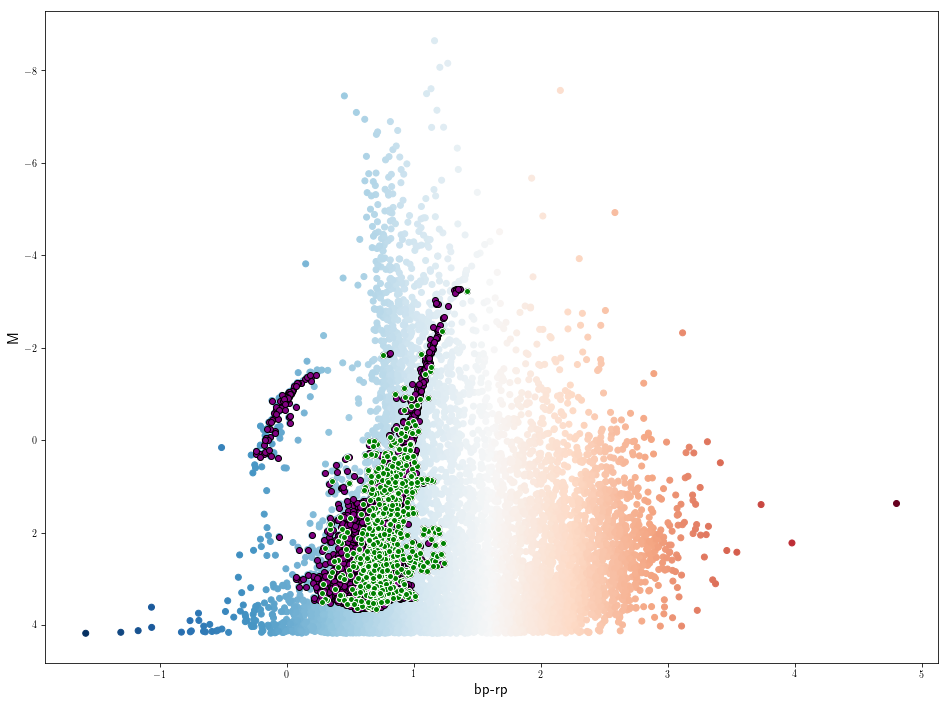

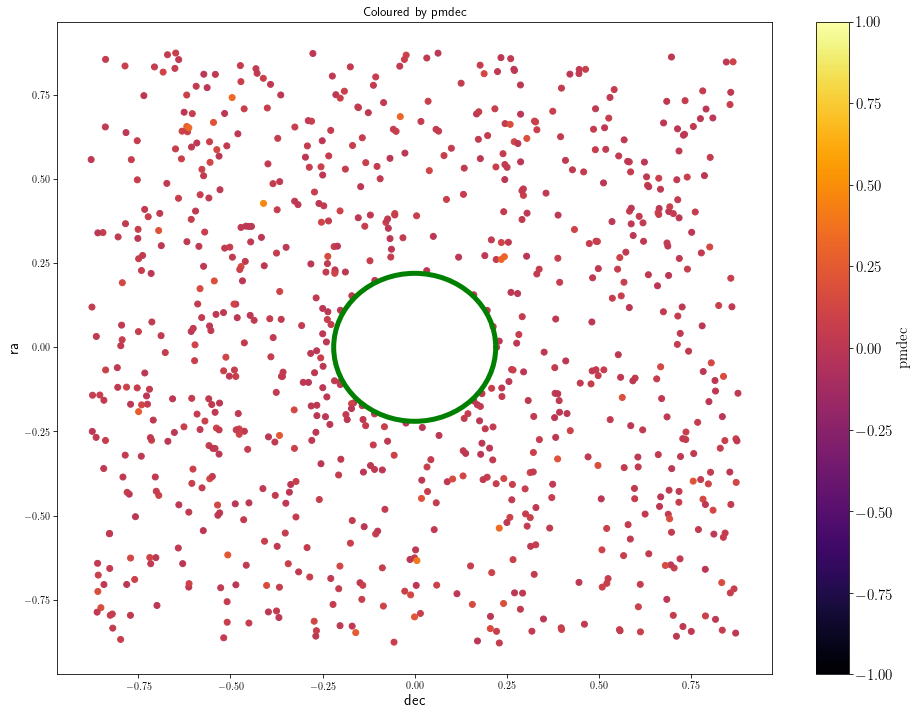

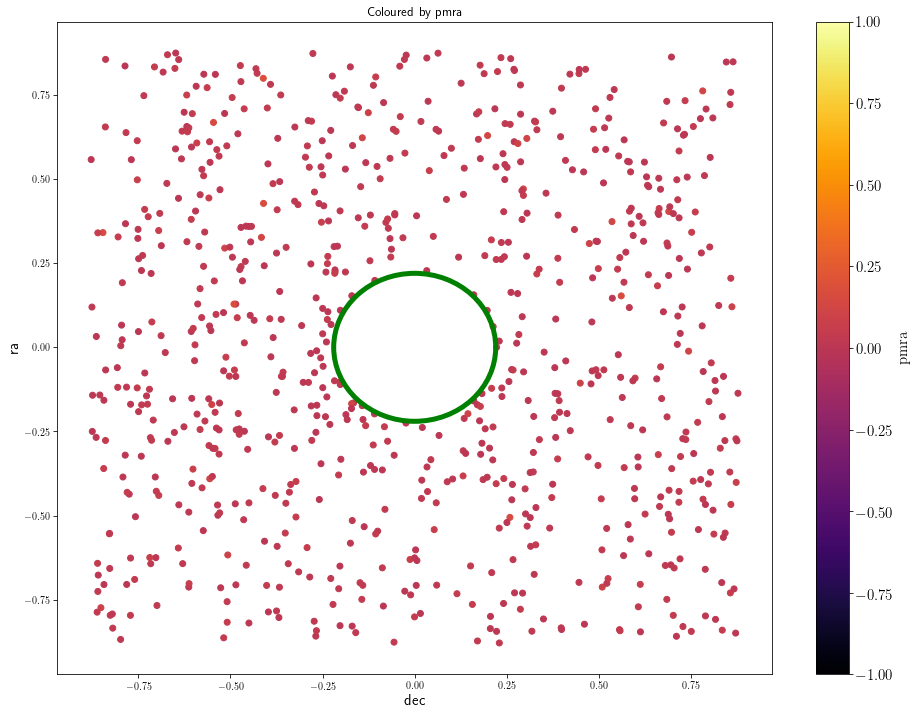

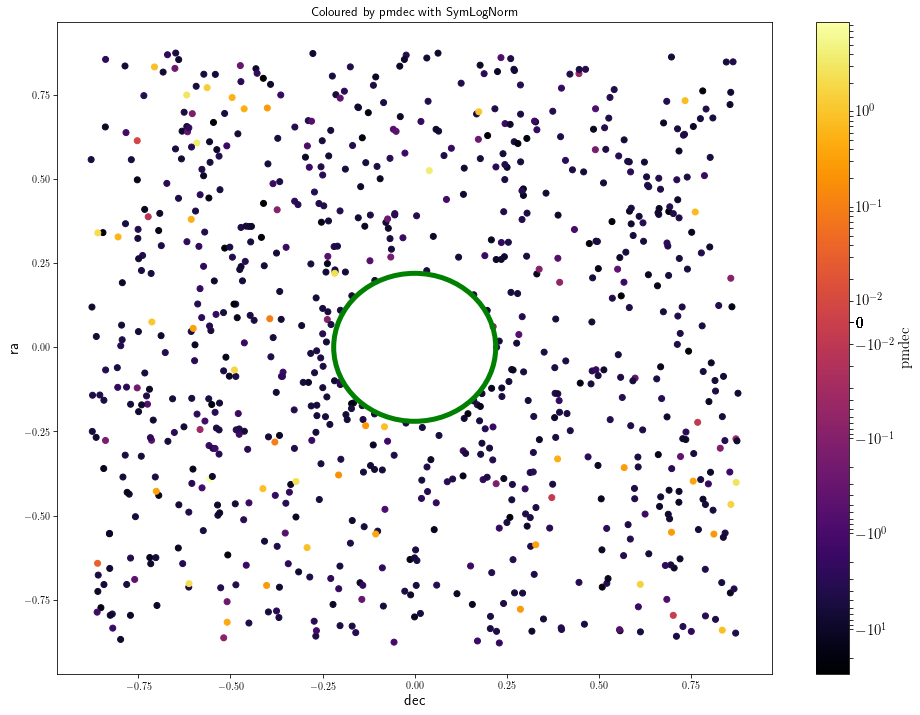

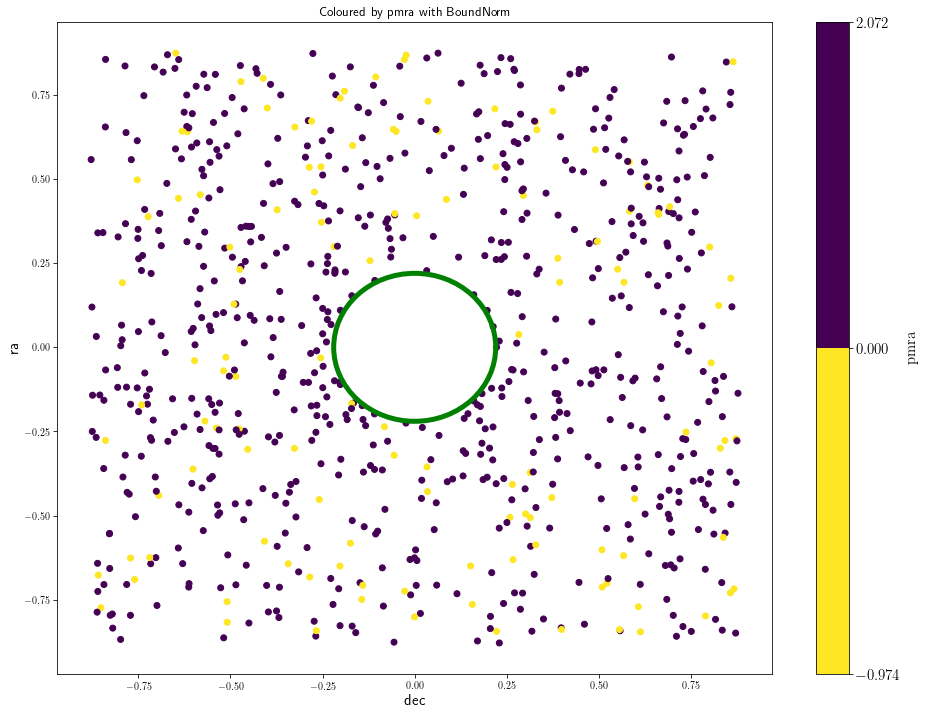

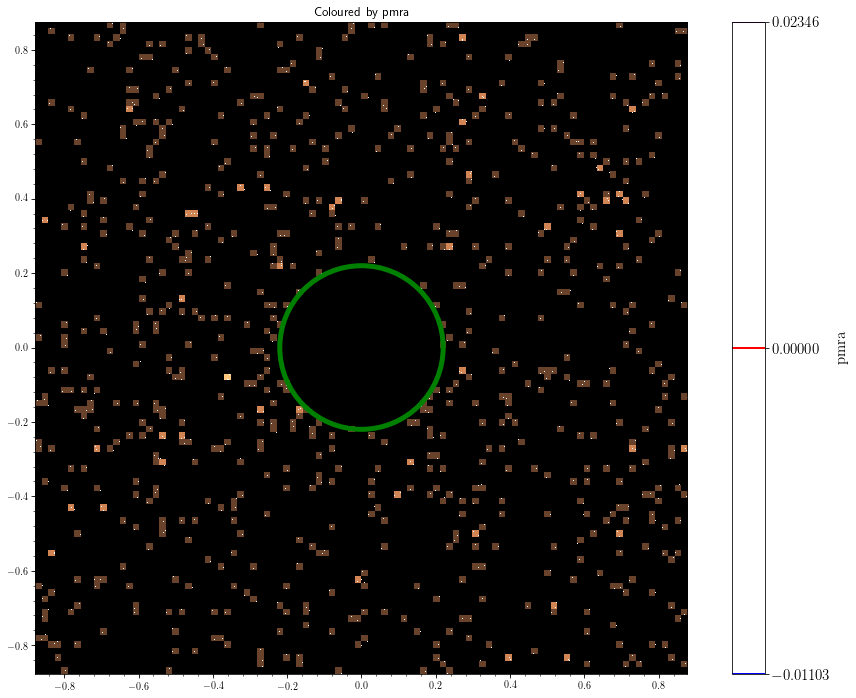

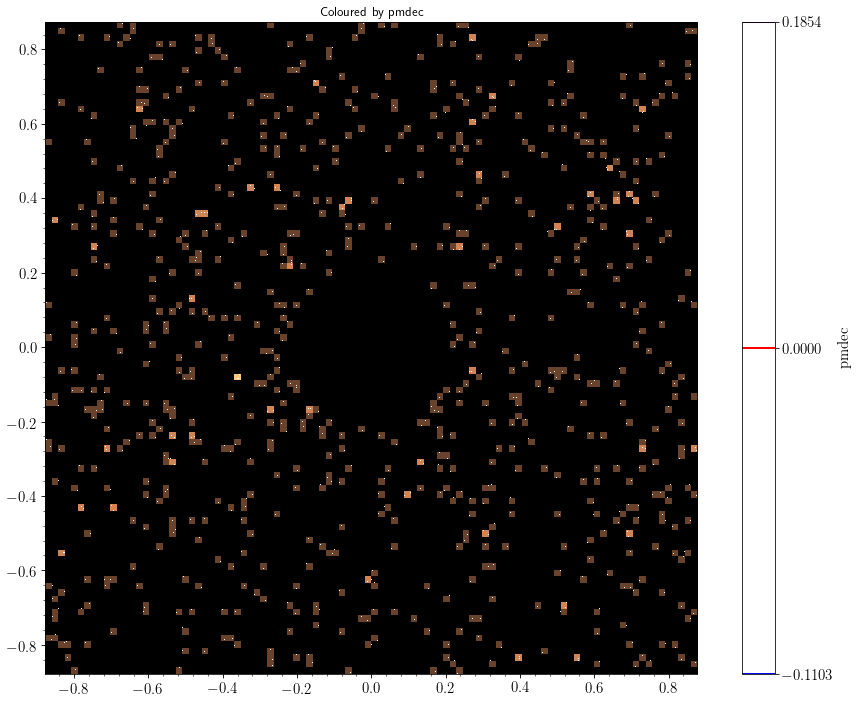

In [28]:
# Apply parallax_indx to current set w/ & w/out cluster w/in r_t

#first shorten parallax_indx
parallax_indx_S = parallax_indx[Cluster3][Survive]


#apply data
ra_outer_p = ra_outer[parallax_indx_S]
#ra_ic3_p
dec_outer_p = dec_outer[parallax_indx_S]
#dec_ic3_p
pmra_outer_p = pmra_outer[parallax_indx_S]
#pmra_ic3_p
pmdec_outer_p = pmdec_outer[parallax_indx_S]
#pmdec_ic3_p
M_outer_p = M_outer[parallax_indx_S]
#M_ic3_p
rpbp_outer_p = rpbp_outer[parallax_indx_S]
#rpbp_ic3_p


#apply to plots
fig=plt.figure(figsize=(16,12))

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3_p, y=M_ic3_p, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Scatter pmra (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_outer_p-coord_ra_dec.ra.deg, y=dec_outer_p-coord_ra_dec.dec.deg, 
            c=np.fabs(pmra_norm2[Survive][parallax_indx_S]/np.nanmean(pmra_ic3_p)), 
            cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter pmdec (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_outer_p-coord_ra_dec.ra.deg, y=dec_outer_p-coord_ra_dec.dec.deg, 
            c=np.fabs(pmdec_norm2[Survive][parallax_indx_S]/np.nanmean(pmdec_ic3_p)), cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by Symlog
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='k', alpha=0.4)
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_outer_p-coord_ra_dec.ra.deg, y=dec_outer_p-coord_ra_dec.dec.deg, c=pmdec_outer_p, cmap='inferno', 
            norm=colors.SymLogNorm(vmin=np.nanmin(pmdec_outer_p), vmax=np.nanmax(pmdec_outer_p), linthresh=0.03, ),)#edgecolors='k')
#           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec with SymLogNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter by BoundNorm
bounds=[np.nanmin(pmra_ic3_p), np.nanmean(pmra_ic3_p), 0, np.nanmax(pmra_ic3_p)]
normbounds = [np.nanmin(pmra_norm2[Survive][parallax_indx_S]), 0, np.nanmax(pmra_norm2[Survive][parallax_indx_S])]
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_outer_p-coord_ra_dec.ra.deg, y=dec_outer_p-coord_ra_dec.dec.deg, c=pmra_outer_p, cmap='viridis_r',
           norm=colors.BoundaryNorm(normbounds, ncolors=256)#edgecolors='k')
           ,vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra with BoundNorm')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Bovy Plots
fig=figure(figsize=(16,12))
ax = plt.gca()
bovy_plot.bovy_print(fig_width=16,fig_height=12)
bovy_plot.scatterplot(ra_outer_p-coord_ra_dec.ra.deg,dec_outer_p-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3),'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmra_norm2[Survive][parallax_indx_S])/20/np.nanmean(pmra_ic3_p), 0, np.nanmax(pmra_norm2[Survive][parallax_indx_S])/20/np.nanmean(pmra_ic3_p)],# GlobClust_Log_r_t[0]/60],
                      #levels=[np.nanmin(pmra_norm2)/np.nanmean(pmra_ic3), 0, np.nanmax(pmra_norm2)/np.nanmean(pmra_ic3)],# GlobClust_Log_r_t[0]/60],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        gcf=True)
                     #colorbar=True,
                     #xrange=[-0.5,0.5], yrange=[0.5,-0.5])#,
                      #bins=101)
                      #levels=[0.02,0.06,0.12,0.21,0.33,0.50,0.68,0.80,0.90,0.95],
                      #contours=False,
                     #xlabel=r'$X\,(\mathrm{kpc})$',
                     #ylabel=r'$X\,(\mathrm{kpc})$')
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.title('Coloured by pmra')
                    
bovy_plot.scatterplot(ra_outer_p-coord_ra_dec.ra.deg,dec_outer_p-coord_ra_dec.dec.deg,'w,', bins=100, 
                      #pmra_norm2[~numpy.isnan(pmra_norm2)]/np.nanmean(pmra_ic3), pmdec_norm2[~numpy.isnan(pmdec_norm2)]/np.nanmean(pmra_ic3), 
                      #'b,', bins=250,                  
                      #levels=[0,4.3,61.62,74.9],
                      #levels=[np.nanmin(pmra_ic3), 0, np.nanmax(pmra_ic3)],
                      levels=[np.nanmin(pmdec_norm2[Survive][parallax_indx_S])/fabs(np.nanmean(pmdec_ic3_p)), 0, np.nanmax(pmdec_norm2[Survive][parallax_indx_S])/fabs(np.nanmean(pmdec_ic3_p))],
        #levels=[GlobClust_Log_r_c[0]/60, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60*4],
        #levels=[GlobClust_Log_r_t[0]/60*4, GlobClust_Log_r_t[0]/60*3.5, GlobClust_Log_r_t[0]/60, GlobClust_Log_r_c[0]/60],
                     cntrSmooth=True, 
                      #justcontours=True,
                      cmap='copper',
                        cntrcolors=['blue','red','purple'],#,'green'], 
                      cntrlw=2,
                     #onedhists=True,
                      #xrange=[-0.03,0.03],yrange=[-0.03,0.03],
                        )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.title('Coloured by pmdec')



plt.gca().tick_params(labelsize=15)
plt.show()

In [22]:
shape(GC_pmra) == shape(WT2_aa)
shape(GC_pmra)
#pywt.swt_max_level(len(GC_pmradec))
#shape(squeeze(WT2_aa))
#pd.DataFrame(WT2_aa)


(2060,)

[-1.03507857 -0.90370508 -0.89437477 ...,  1.13520221  1.38614812
  1.40673199]
[-1.33796305 -1.12232876 -0.88495953 ...,  0.9735412   1.09239385
  1.11968987]
[-1.36612839 -1.0685377  -0.98679172 ...,  1.09528781  1.12510256  1.525232  ]
[-1.31766271 -1.0590272  -0.87625966 ...,  1.20434183  1.21084052
  1.23309481]


ValueError: Contour levels must be increasing

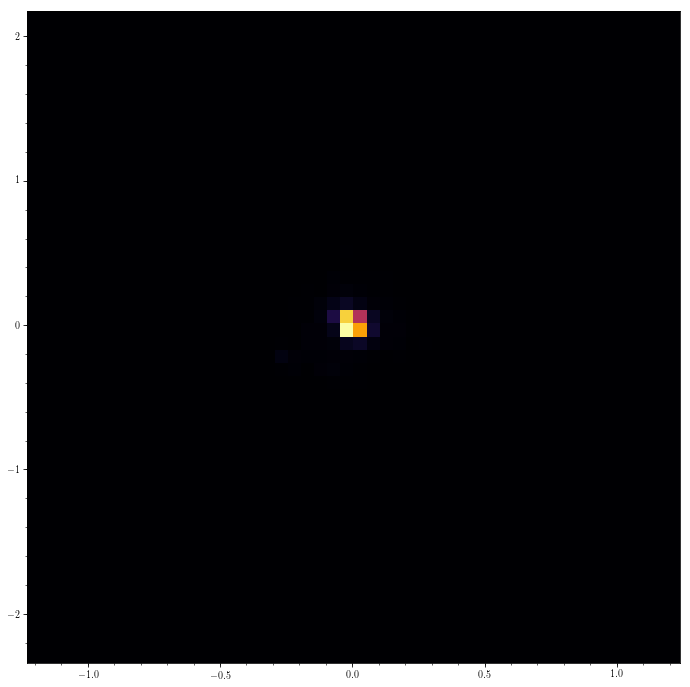

In [29]:
# Wavelet Transform plots for all 4 coefficients
# plots in proper motions

import pywt

GC_pmra=pmra_norm2[parallax_indx_3]
#GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_norm2[parallax_indx_3]
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (27,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (27,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=1, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
#WT2_aa = squeeze(WT2_aa)
WT2_aa.sort()
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure()
bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_pmradec.loc[:,"pmdec"].dropna().as_matrix(), GC_pmradec.loc[:,"pmra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=50, cntrSmooth=True)

cb=plt.colorbar()
plt.show()


[-1.03507857 -0.90370508 -0.89437477 ...,  1.13520221  1.38614812
  1.40673199]
[-1.33796305 -1.12232876 -0.88495953 ...,  0.9735412   1.09239385
  1.11968987]
[-1.36612839 -1.0685377  -0.98679172 ...,  1.09528781  1.12510256  1.525232  ]
[-1.31766271 -1.0590272  -0.87625966 ...,  1.20434183  1.21084052
  1.23309481]


ValueError: Contour levels must be increasing

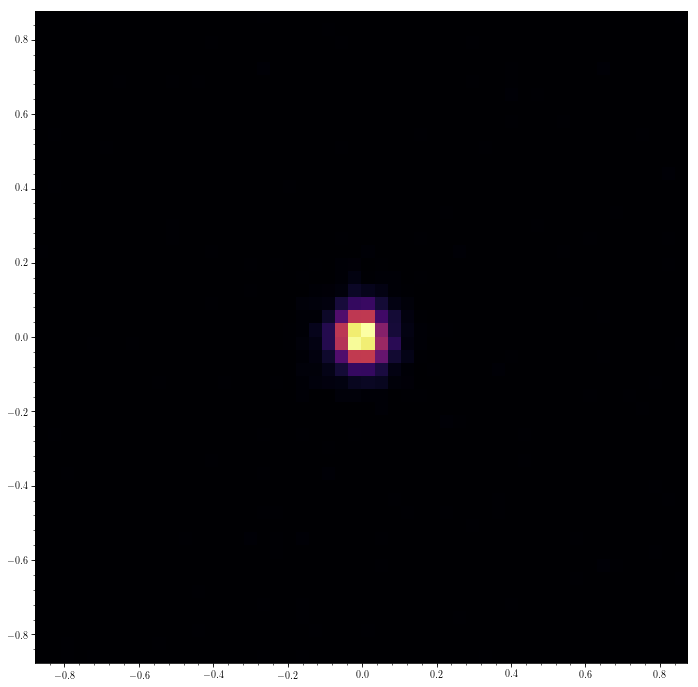

In [30]:
# Wavelet transform plotting all 4 coefficients
# plots in radec

import pywt

GC_radec = {'ra': ra_ic3[parallax_indx_3]-coord_ra_dec.ra.deg, 'dec': dec_ic3[parallax_indx_3]-coord_ra_dec.dec.deg}
GC_radec = pd.DataFrame(GC_radec)
#GC_radec.as_matrix()

GC_pmra=pmra_norm2[parallax_indx_3]
#GC_pmra=append(GC_pmra,GC_pmra.mean())
GC_pmdec=pmdec_norm2[parallax_indx_3]
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
GC_pmra = np.pad(GC_pmra, (1392,), 'mean')
GC_pmdec = np.pad(GC_pmdec, (1392,), 'mean')
GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
GC_pmradec = pd.DataFrame(GC_pmradec)
GC_pmradec

WT2 = pywt.swtn(GC_pmradec.as_matrix(), 'db4', level=1, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
print(WT2_dd)

fig=figure()
bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=50, cntrSmooth=True)

bovy_plot.scatterplot(GC_radec.loc[:,"dec"].dropna().as_matrix(), GC_radec.loc[:,"ra"].dropna().as_matrix(), 'b,',
                     cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=50, cntrSmooth=True)

cb=plt.colorbar()
plt.show()

## Density plot from NGC 288 Paper

In [ ]:
starc1 = ()

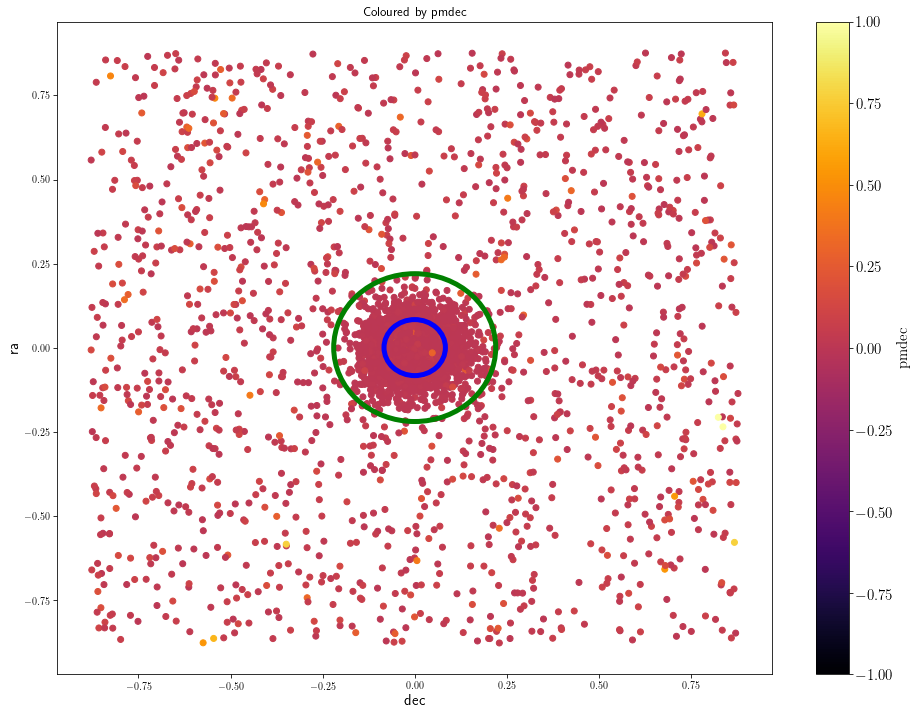

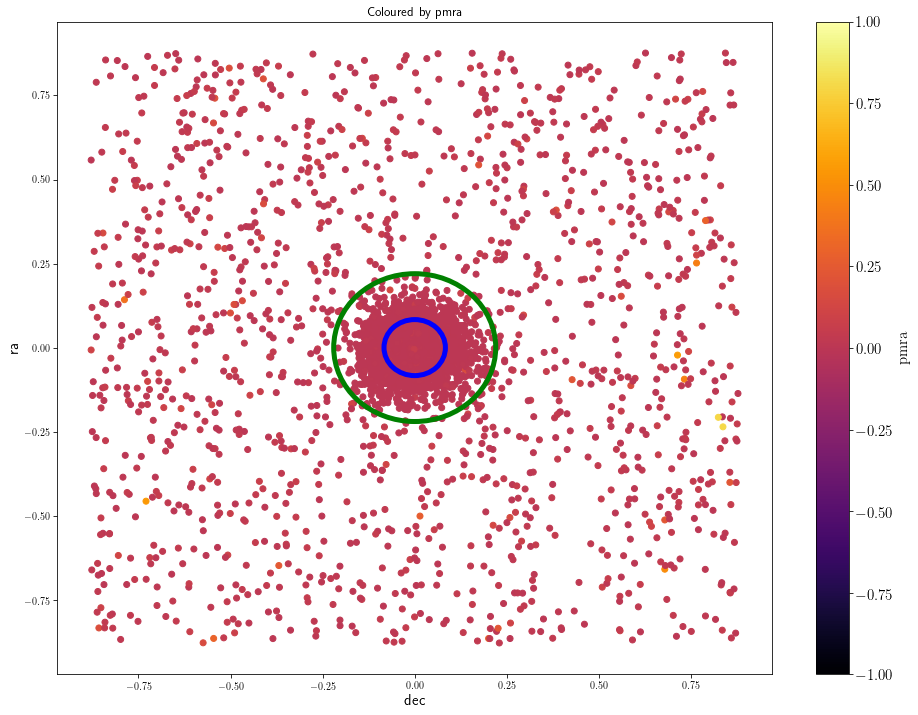

In [31]:
# Blue circle = 5 arcmin (0.083 deg) -> limit for Ngc 288 paper
# Green circle = tidal radius ~13 arcmin (~0.22 deg)

#Scatter pmra (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, 
            c=np.fabs(pmra_norm2/np.nanmean(pmra_ic3)), 
            cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((0, 0), 5/60, color='b', fill=False, lw=5)
ax.add_artist(circle2)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmdec')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

#Scatter pmdec (ra-dec)
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, 
            c=np.fabs(pmdec_norm2/np.nanmean(pmdec_ic3)), cmap='inferno',#)#edgecolors='k')
           vmin=-1, vmax=1)
circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='g', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((0, 0), 5/60, color='b', fill=False, lw=5)
ax.add_artist(circle2)
plt.xlabel('dec', fontsize=15)
plt.ylabel('ra', fontsize=15)
plt.title('Coloured by pmra')
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
#plt.gca().set_ylim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])
#plt.gca().set_xlim([GlobClust_Log_r_t.as_matrix()/60, -GlobClust_Log_r_t.as_matrix()/60])

## Contamination check from Fig 1 of paper

In [9]:
M_uplim=20.7-5*((log10(d_pc[5])) - 1)
M_dlim=18.7-5*((log10(d_pc[5])) - 1)

In [10]:
d_pc[5]

8900

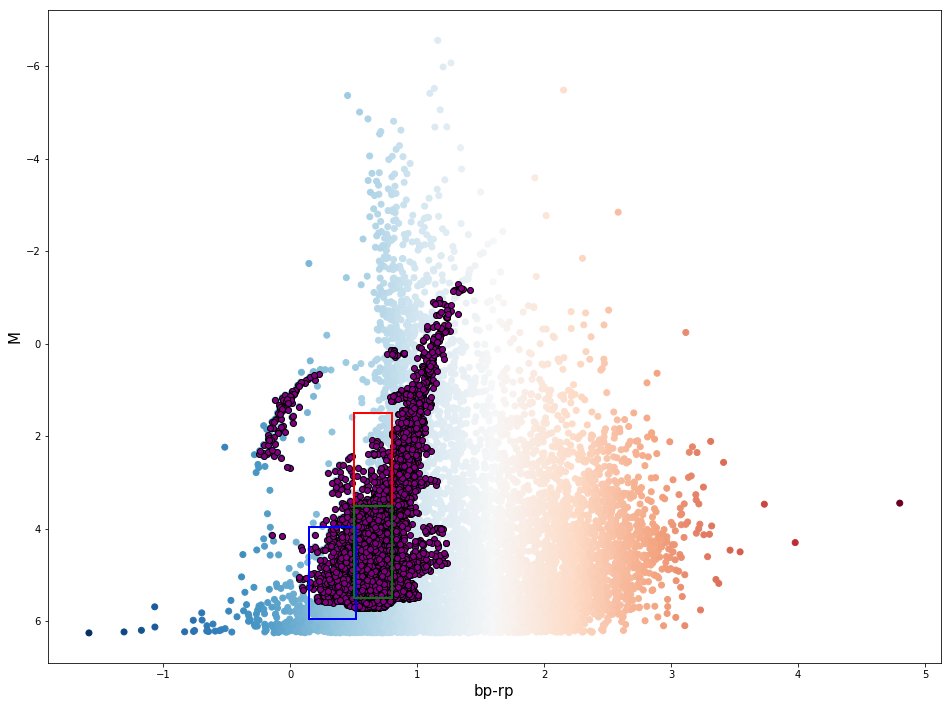

In [40]:
#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_ic3, y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Box in same place as paper
plt.plot([0.15,0.15], [M_dlim, M_uplim], 'b-', lw=2)
plt.plot([0.52,0.52], [M_dlim, M_uplim], 'b-', lw=2)
plt.plot([0.15,0.52], [M_uplim, M_uplim], 'b-', lw=2)
plt.plot([0.15,0.52], [M_dlim, M_dlim], 'b-', lw=2)

#Chosen box?:
plt.plot([0.5,0.5], [1.5, 3.5], 'r-', lw=2)
plt.plot([0.8,0.8], [1.5, 3.5], 'r-', lw=2)
plt.plot([0.5,0.8], [3.5, 3.5], 'r-', lw=2)
plt.plot([0.5,0.8], [1.5, 1.5], 'r-', lw=2)

plt.plot([0.5,0.5], [3.5, 5.5], 'g-', lw=2)
plt.plot([0.8,0.8], [3.5, 5.5], 'g-', lw=2)
plt.plot([0.5,0.8], [5.5, 5.5], 'g-', lw=2)
plt.plot([0.5,0.8], [3.5, 3.5], 'g-', lw=2)
plt.show()

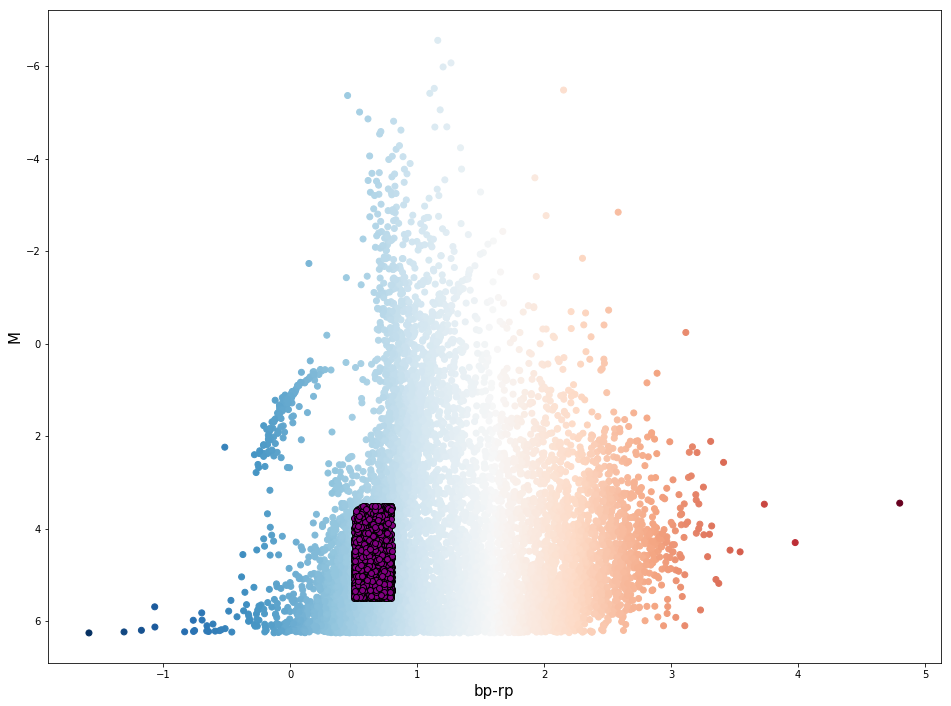

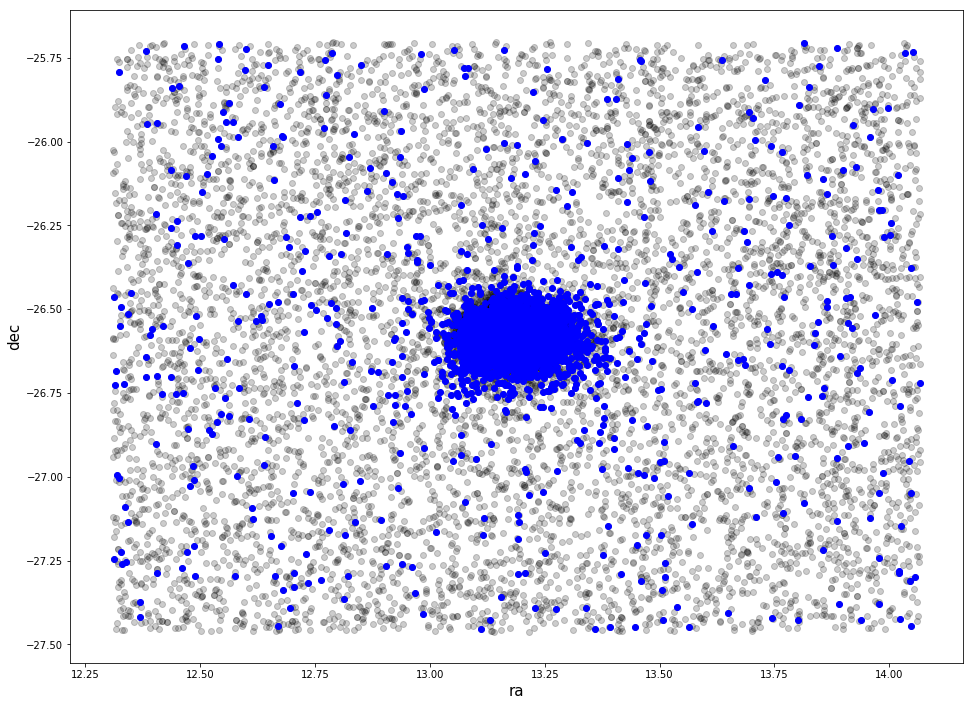

In [42]:
CMD_indx = (rpbp_ic3>0.5)*(rpbp_ic3<0.8)*(M_ic3>3.5)*(M_ic3<5.5)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3[CMD_indx], y=M_ic3[CMD_indx], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_ic3, y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra, y=GlobClust_Log_dec, c='k', alpha=0.2)
plt.scatter(x=ra_ic3[CMD_indx], y=dec_ic3[CMD_indx], c='b')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

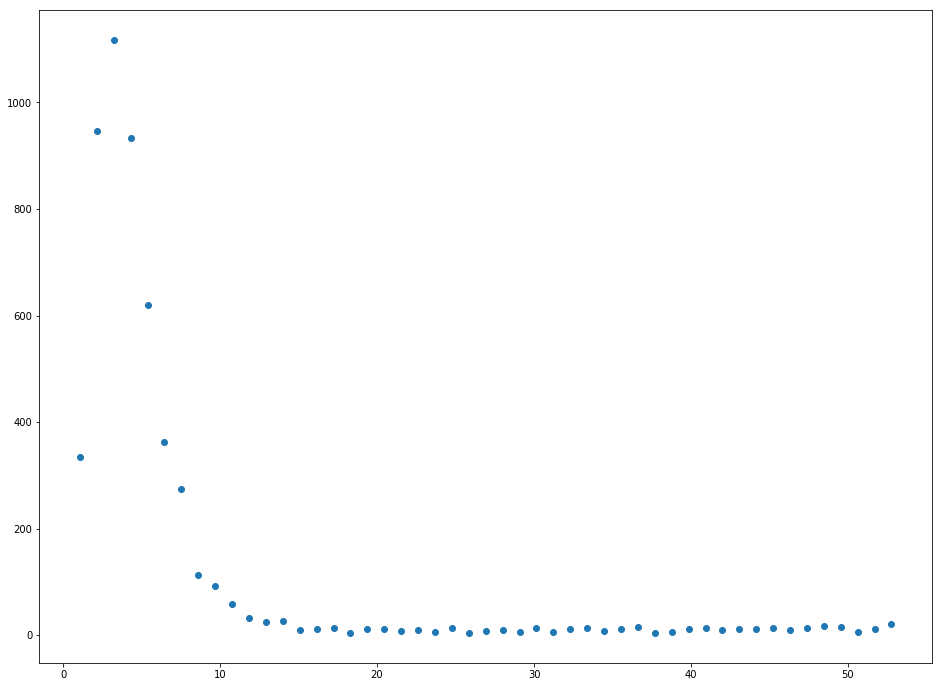

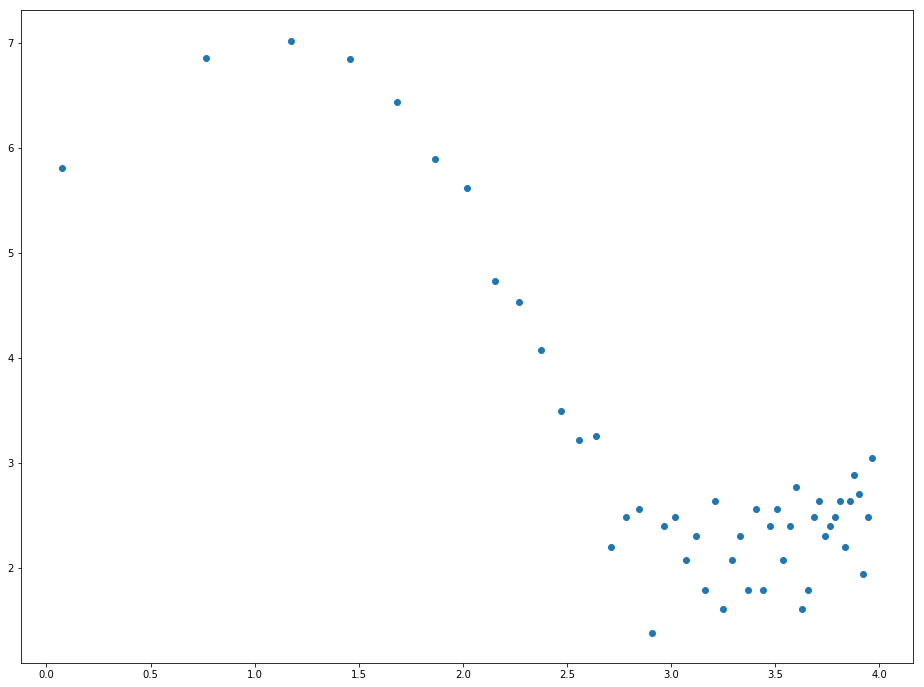

In [43]:

#radii=linspace(0, ra_DB.max(),3)

radii=linspace(0, 4*GlobClust_Log_r_t[0]/60)

c_a = []

for i in range(1,len(radii)):
    indx_r = (sqrt((np.fabs(ra_ic3[CMD_indx]-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_ic3[CMD_indx]-coord_ra_dec.dec.deg)**2)<radii[i])*\
    (sqrt((np.fabs(ra_ic3[CMD_indx]-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_ic3[CMD_indx]-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_ic3[CMD_indx][indx_r])
    dec_count = len(dec_ic3[CMD_indx][indx_r])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count#/r_area_ring
    count_area2 = dec_count#/r_area_ring
    #print('debug',count_area)
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

fig=plt.figure(figsize(16,12))
plt.scatter(radii[1:]*60,c_a)
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

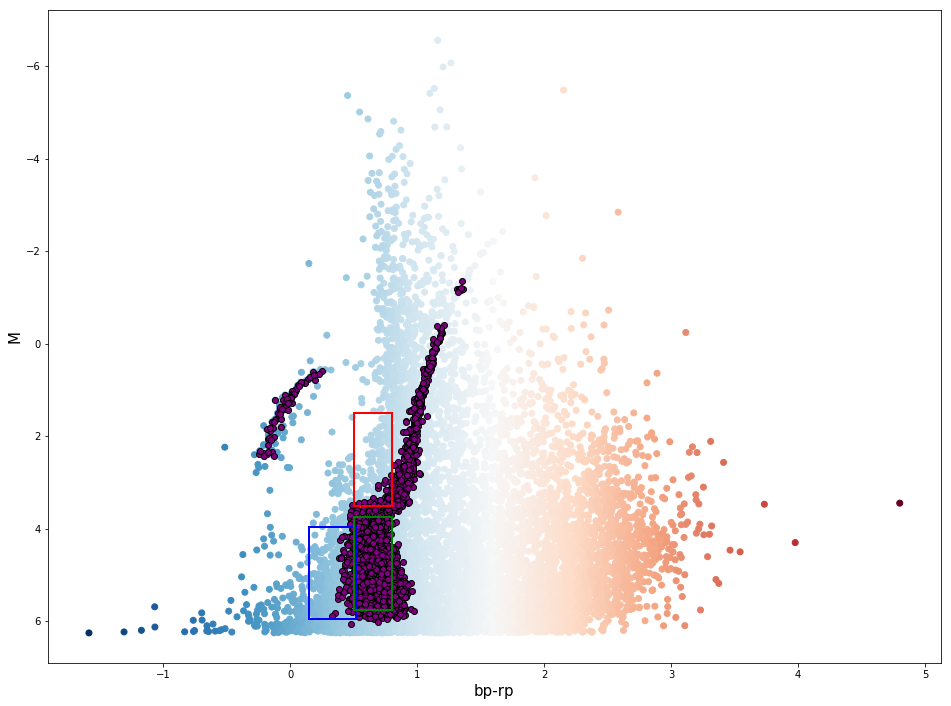

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))


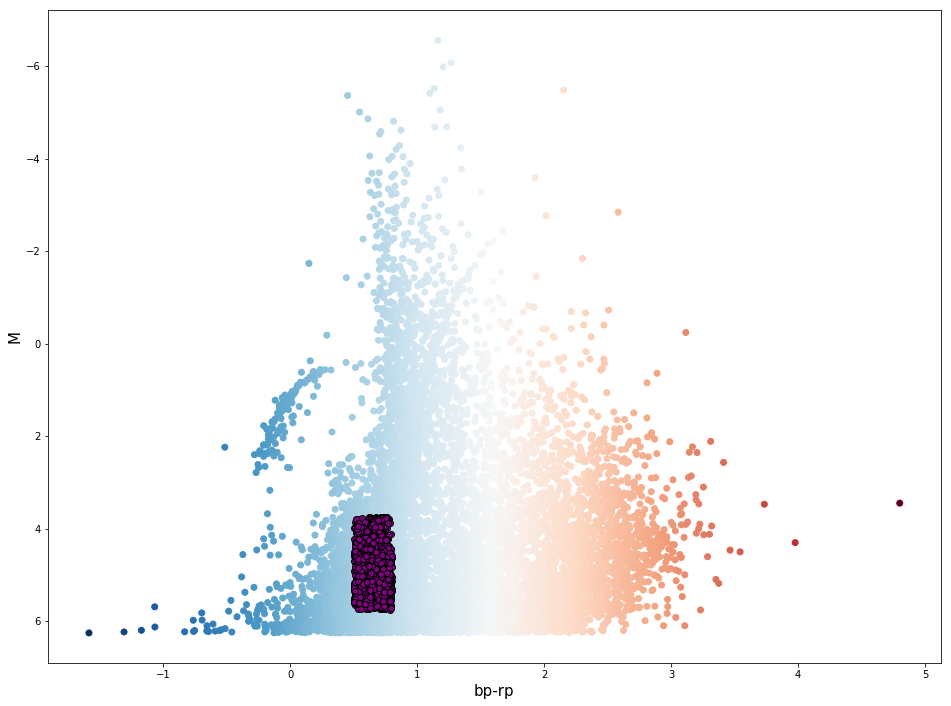

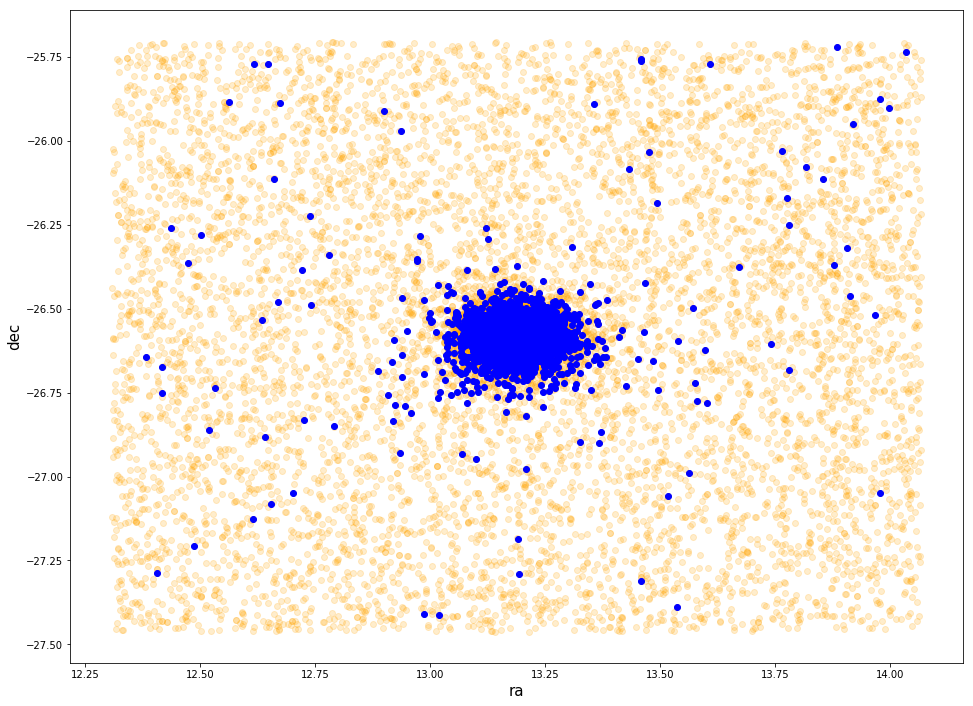

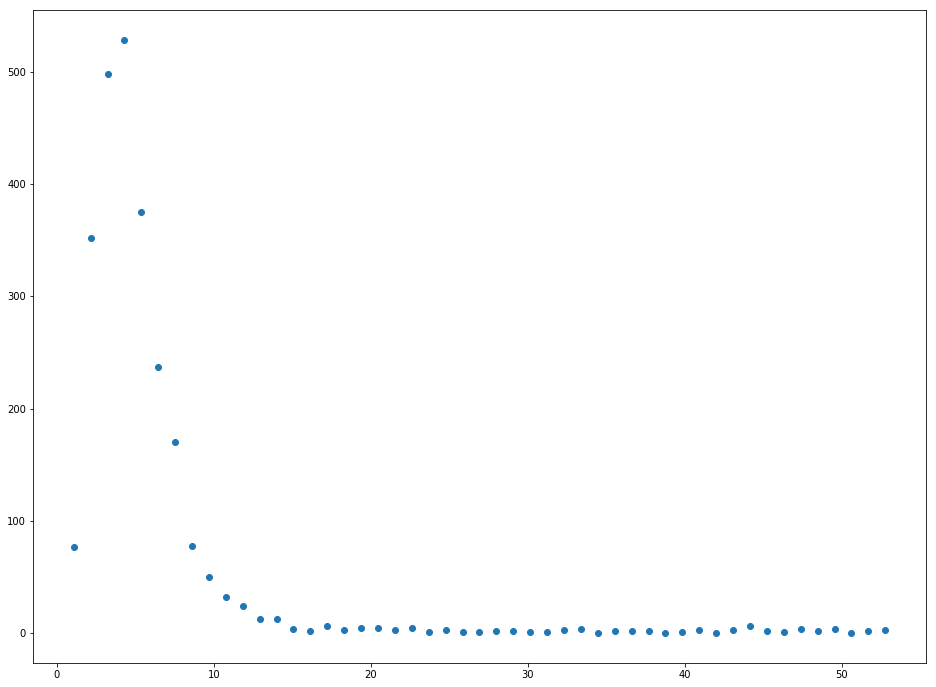

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:83: RuntimeWarning: divide by zero encountered in log


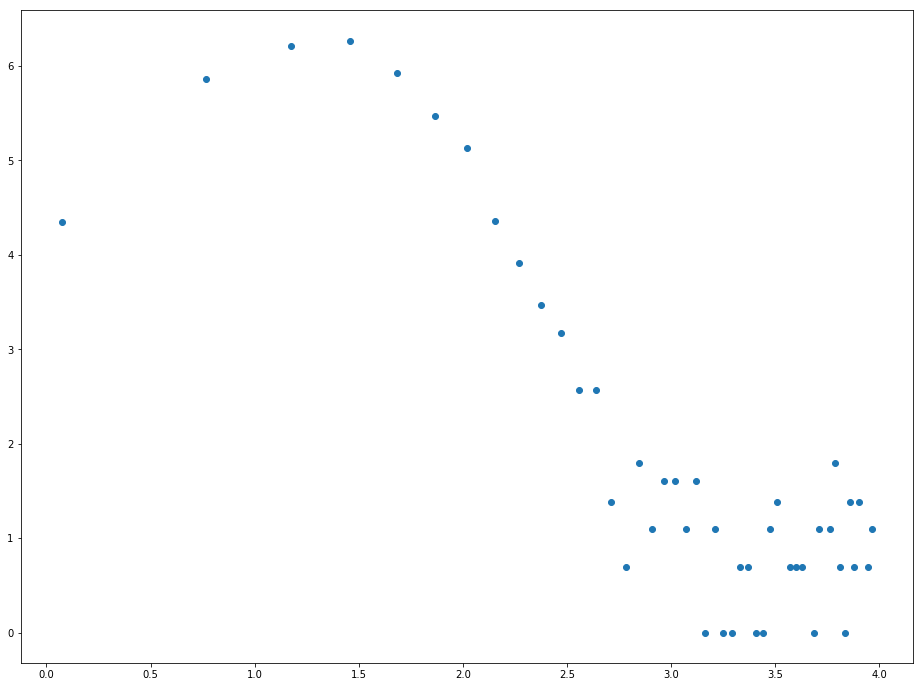

In [19]:
#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_ic3, y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Box in same place as paper
plt.plot([0.15,0.15], [M_dlim, M_uplim], 'b-', lw=2)
plt.plot([0.52,0.52], [M_dlim, M_uplim], 'b-', lw=2)
plt.plot([0.15,0.52], [M_uplim, M_uplim], 'b-', lw=2)
plt.plot([0.15,0.52], [M_dlim, M_dlim], 'b-', lw=2)

#Chosen box?:
plt.plot([0.5,0.5], [1.5, 3.5], 'r-', lw=2)
plt.plot([0.8,0.8], [1.5, 3.5], 'r-', lw=2)
plt.plot([0.5,0.8], [3.5, 3.5], 'r-', lw=2)
plt.plot([0.5,0.8], [1.5, 1.5], 'r-', lw=2)

plt.plot([0.5,0.5], [3.75, 5.75], 'g-', lw=2)
plt.plot([0.8,0.8], [3.75, 5.75], 'g-', lw=2)
plt.plot([0.5,0.8], [5.75, 5.75], 'g-', lw=2)
plt.plot([0.5,0.8], [3.75, 3.75], 'g-', lw=2)
plt.show()

CMD_indx2 = (rpbp_DB>0.5)*(rpbp_DB<0.8)*(M_DB>3.75)*(M_DB<5.75)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_DB[CMD_indx2], y=M_DB[CMD_indx2], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_ic3, y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra, y=GlobClust_Log_dec, c='orange', alpha=0.2)
plt.scatter(x=ra_DB[CMD_indx2], y=dec_DB[CMD_indx2], c='b')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)


#radii=linspace(0, ra_DB.max(),3)

radii=linspace(0, 4*GlobClust_Log_r_t[0]/60)

c_a = []

for i in range(1,len(radii)):
    indx_r2 = (sqrt((np.fabs(ra_DB[CMD_indx2]-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_DB[CMD_indx2]-coord_ra_dec.dec.deg)**2)<radii[i])*\
    (sqrt((np.fabs(ra_DB[CMD_indx2]-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB[CMD_indx2]-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_DB[CMD_indx2][indx_r2])
    dec_count = len(dec_DB[CMD_indx2][indx_r2])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count#/r_area_ring
    count_area2 = dec_count#/r_area_ring
    #print('debug',count_area)
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

fig=plt.figure(figsize(16,12))
plt.scatter(radii[1:]*60,c_a)
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

In [82]:
ra_ic3-1.5*ra_ic3.mean()

array([-6.65910626, -6.62062343, -6.63902931, ..., -6.51030697,
       -6.66886529, -6.59958338])

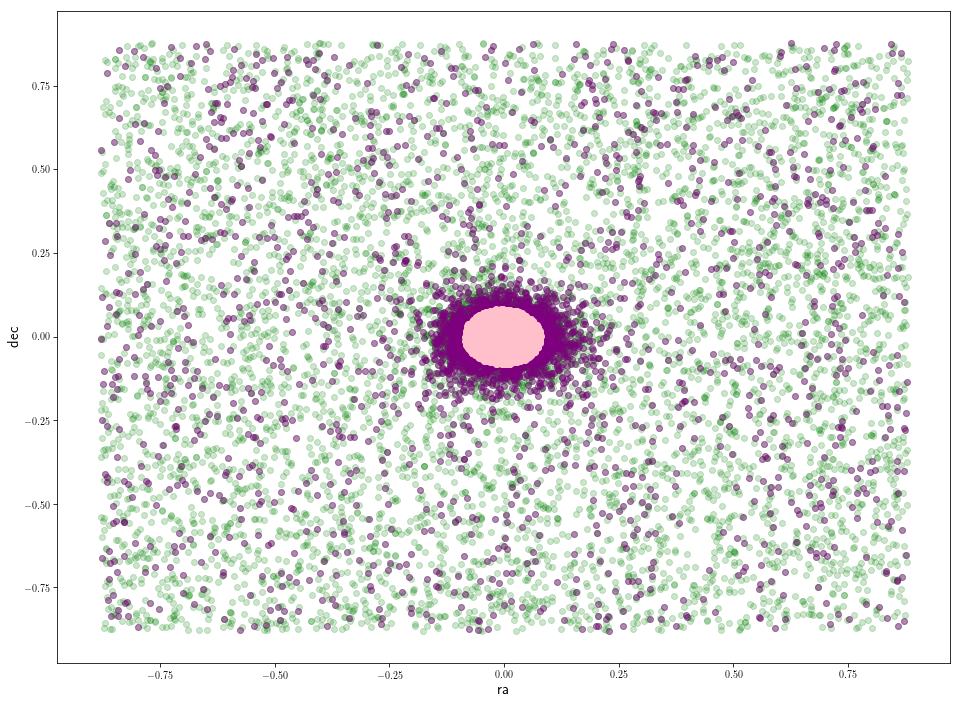

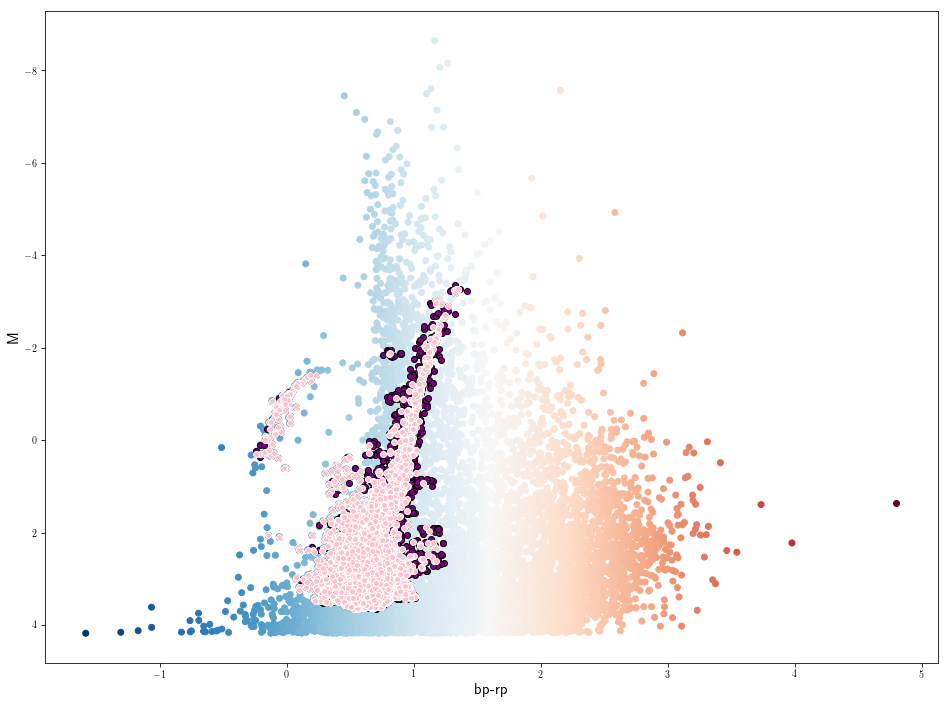

In [36]:
#in5 = (ra_ic3-ra_ic3.mean()<5/60)*(dec_ic3-dec_ic3.mean()<5/60)

in5 = (sqrt((np.fabs(ra_ic3-ra_ic3.mean())**2+np.fabs(dec_ic3-dec_ic3.mean())**2))<5/60)

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=ra_ic3[in5]-coord_ra_dec.ra.deg, y=dec_ic3[in5]-coord_ra_dec.dec.deg, c='pink')
#circle = plt.Circle((0, 0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=5)
#circle = plt.Circle((0,0), 5/60, color='k', fill=False, lw=5)
#ax.add_artist(circle)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=rpbp_ic3[in5], y=M_ic3[in5], c='pink', edgecolors='w')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

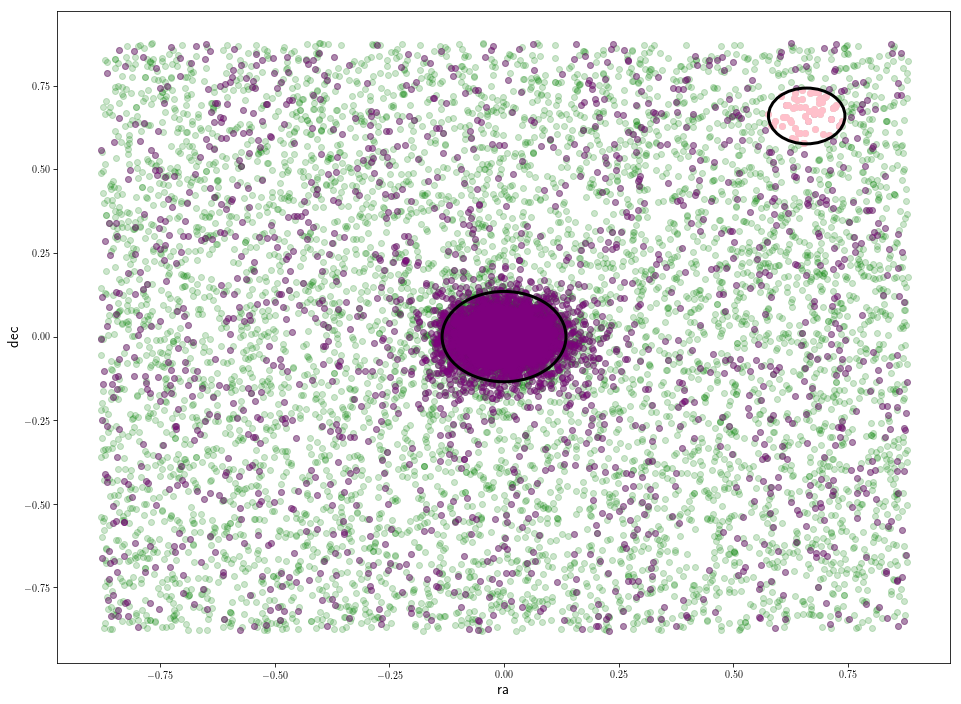

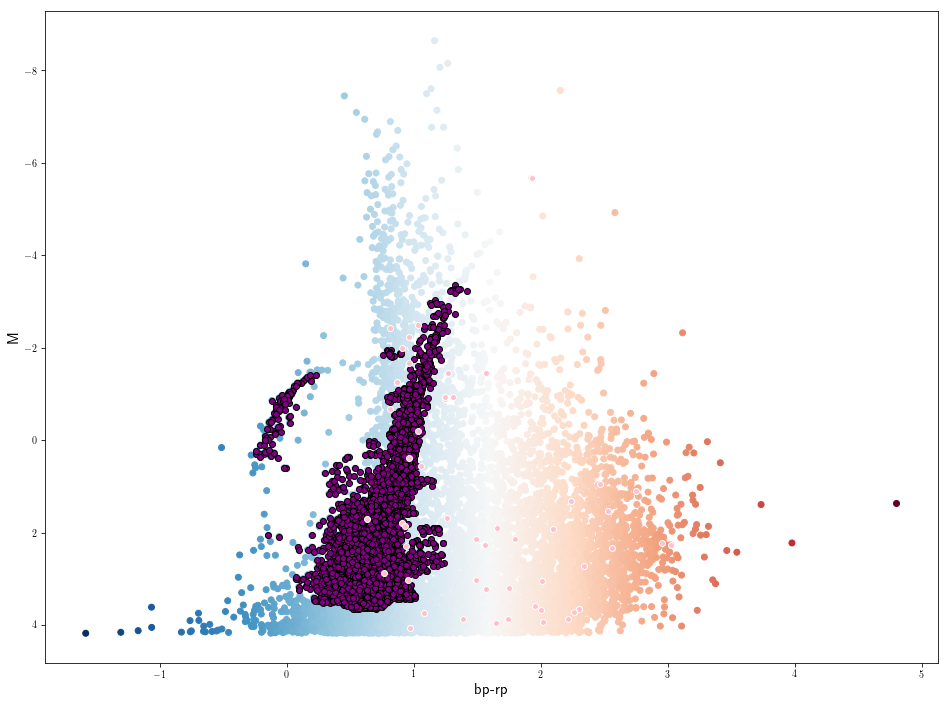

In [37]:
#in5 = (ra_ic3-ra_ic3.mean()<5/60)*(dec_ic3-dec_ic3.mean()<5/60)

r_t = GlobClust_Log_r_t[0]/60
r_c = GlobClust_Log_r_c[0]/60

in6 = (sqrt((np.fabs(GlobClust_Log_ra-ra_ic3.mean()-3*r_t)**2+np.fabs(GlobClust_Log_dec-dec_ic3.mean()-3*r_t)**2))<5/60)

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GlobClust_Log_ra[in6]-coord_ra_dec.ra.deg, y=GlobClust_Log_dec[in6]-coord_ra_dec.dec.deg, c='pink')
circle = plt.Circle((3*r_t,3*r_t), 5/60, color='k', fill=False, lw=3)
circle2 = plt.Circle((0,0),6*r_c, color='k', fill=False, lw=3)
ax.add_artist(circle)
ax.add_artist(circle2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GlobClust_Log_rpbp[in6], y=GlobClust_Log_M[in6], c='pink', edgecolors='w')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

In [70]:
shape(GC_15_M)

(117480,)

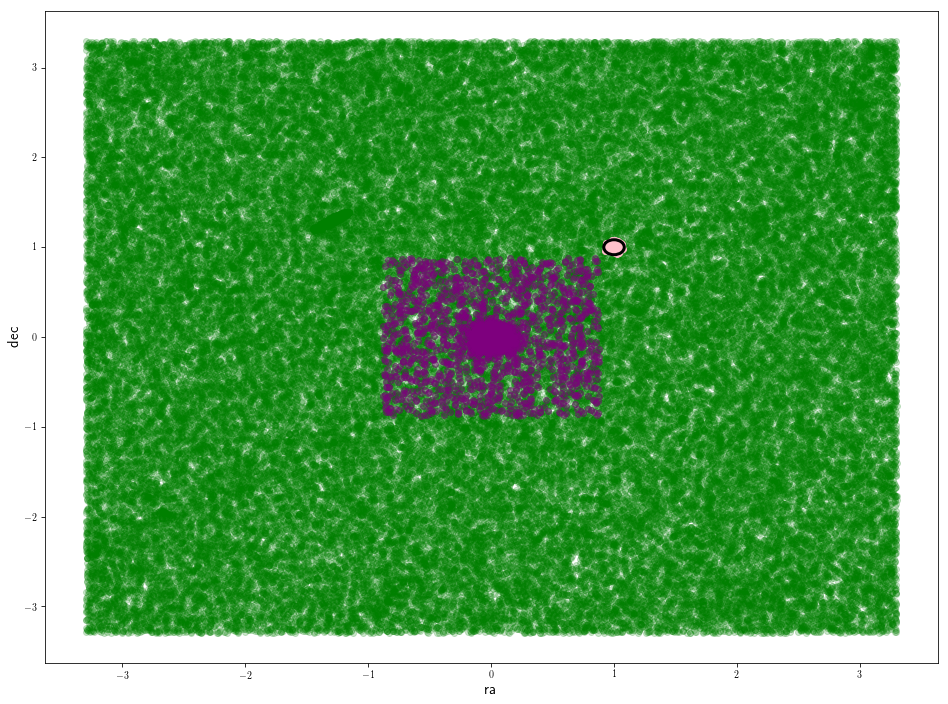

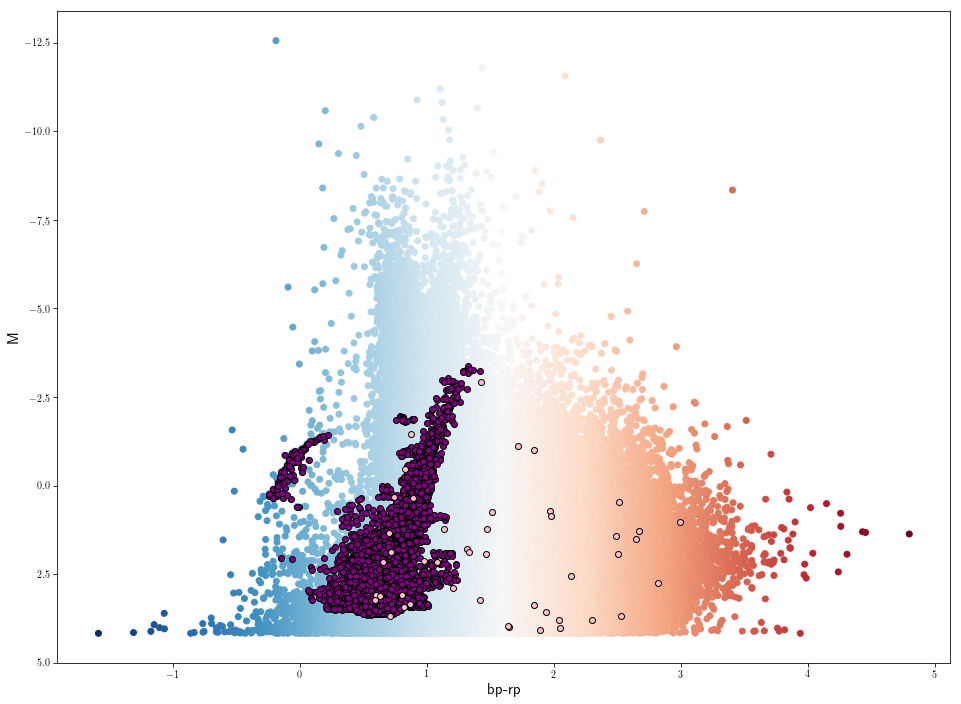

In [38]:
GC_15_r_t = pd.read_csv('out_NGC 288_full_12-rt_ra_dec.csv')

GC_15_ra = GC_15_r_t.loc[:,'ra']
GC_15_dec = GC_15_r_t.loc[:,'dec']
GC_15_g = GC_15_r_t.loc[:,'phot_g_mean_mag']
GC_15_rp = GC_15_r_t.loc[:,'phot_rp_mean_mag']
GC_15_bp = GC_15_r_t.loc[:,'phot_bp_mean_mag']
GC_15_pmra = GC_15_r_t.loc[:,'pmra']
GC_15_pmdec = GC_15_r_t.loc[:,'pmdec']

GC_15_M = GC_15_g-5*((log10(d_pc[i])) - 1)
GC_15_rpbp = GC_15_bp-GC_15_rp

in7 = (sqrt((np.fabs(GC_15_ra-ra_ic3.mean()-1)**2+np.fabs(GC_15_dec-dec_ic3.mean()-1)**2))<5/60)

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GC_15_ra-coord_ra_dec.ra.deg, y=GC_15_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GC_15_ra[in7]-coord_ra_dec.ra.deg, y=GC_15_dec[in7]-coord_ra_dec.dec.deg, c='pink')
circle = plt.Circle((1,1), 5/60, color='k', fill=False, lw=3)
#circle = plt.Circle((0,0), 5/60, color='k', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GC_15_rpbp, y=GC_15_M, c=GC_15_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GC_15_rpbp[in7], y=GC_15_M[in7], c='pink', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()


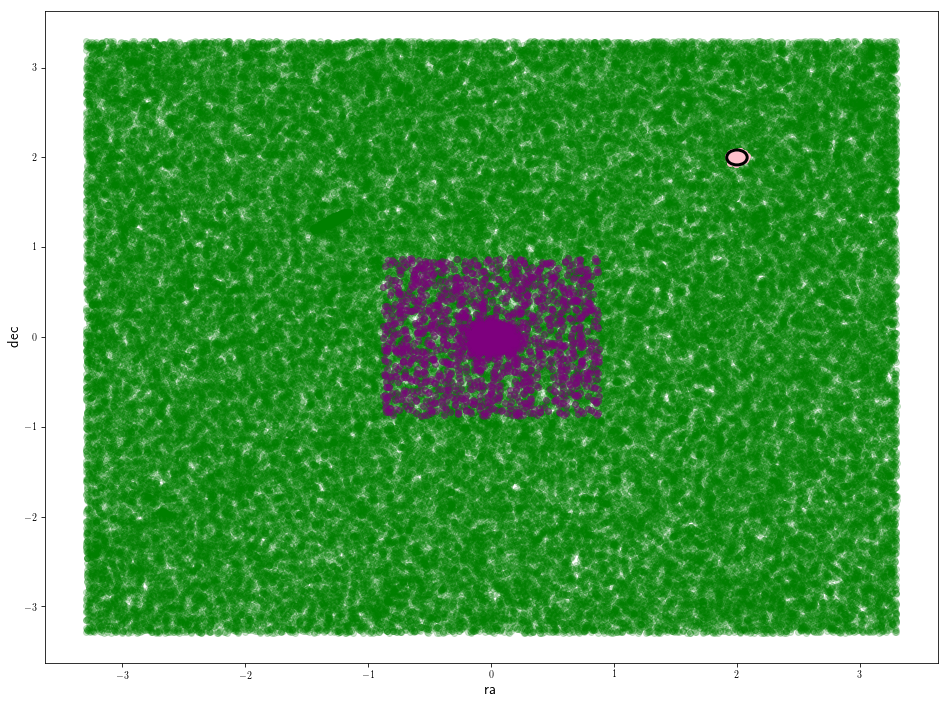

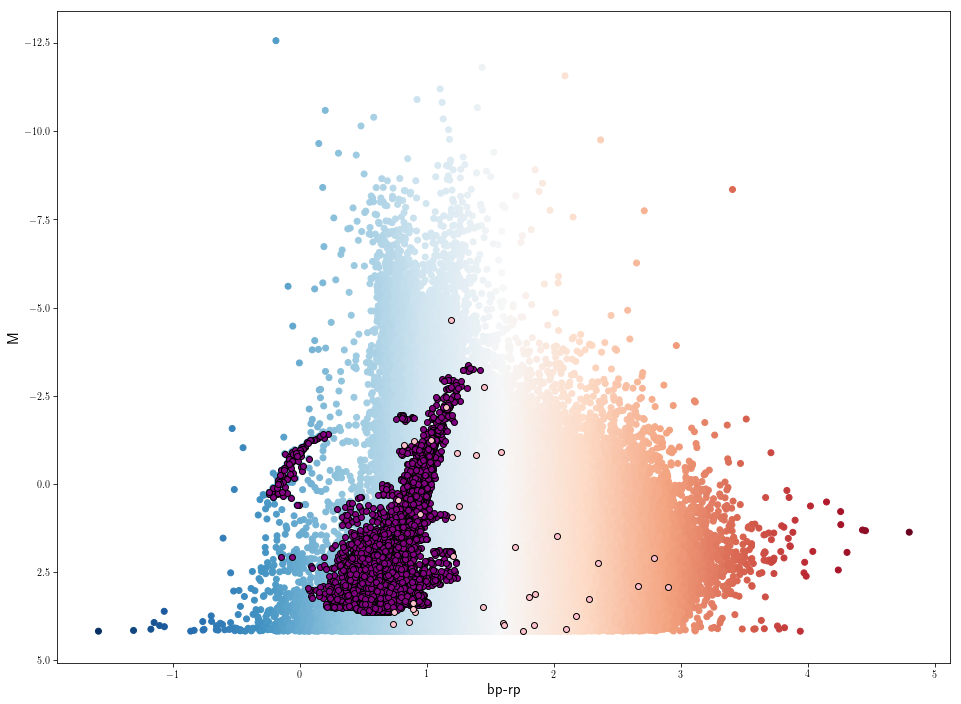

In [39]:
GC_15_r_t = pd.read_csv('out_NGC 288_full_12-rt_ra_dec.csv')

GC_15_ra = GC_15_r_t.loc[:,'ra']
GC_15_dec = GC_15_r_t.loc[:,'dec']
GC_15_g = GC_15_r_t.loc[:,'phot_g_mean_mag']
GC_15_rp = GC_15_r_t.loc[:,'phot_rp_mean_mag']
GC_15_bp = GC_15_r_t.loc[:,'phot_bp_mean_mag']
GC_15_pmra = GC_15_r_t.loc[:,'pmra']
GC_15_pmdec = GC_15_r_t.loc[:,'pmdec']

GC_15_M = GC_15_g-5*((log10(d_pc[i])) - 1)
GC_15_rpbp = GC_15_bp-GC_15_rp

in8 = (sqrt((np.fabs(GC_15_ra-ra_ic3.mean()-2)**2+np.fabs(GC_15_dec-dec_ic3.mean()-2)**2))<5/60)

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GC_15_ra-coord_ra_dec.ra.deg, y=GC_15_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GC_15_ra[in8]-coord_ra_dec.ra.deg, y=GC_15_dec[in8]-coord_ra_dec.dec.deg, c='pink')
circle = plt.Circle((2,2), 5/60, color='k', fill=False, lw=3)
#circle = plt.Circle((0,0), 5/60, color='k', fill=False, lw=5)
ax.add_artist(circle)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GC_15_rpbp, y=GC_15_M, c=GC_15_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GC_15_rpbp[in8], y=GC_15_M[in8], c='pink', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()


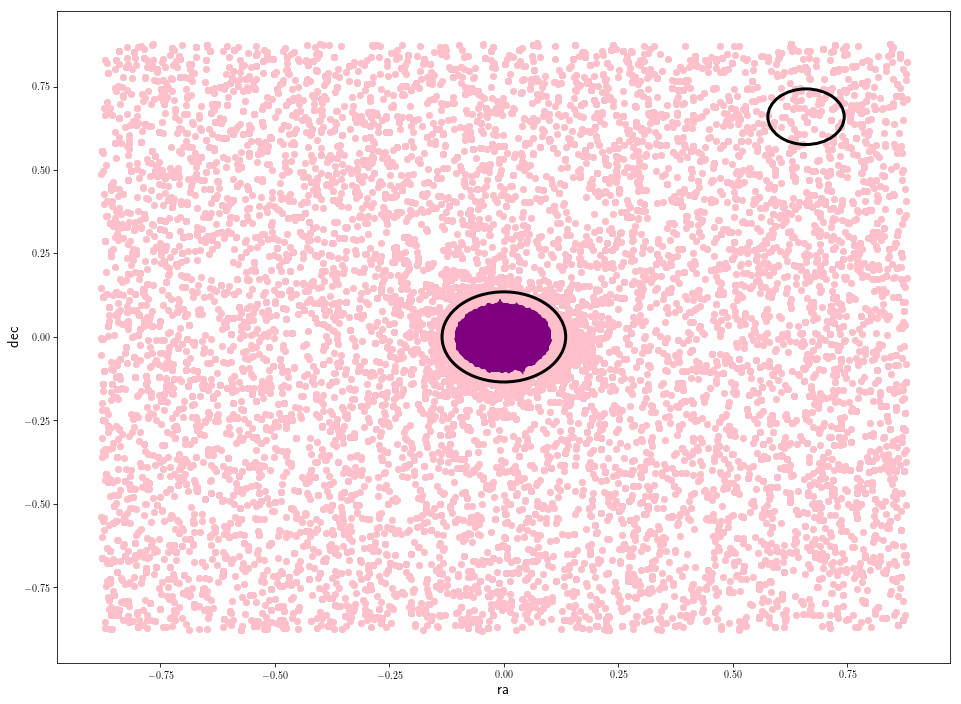

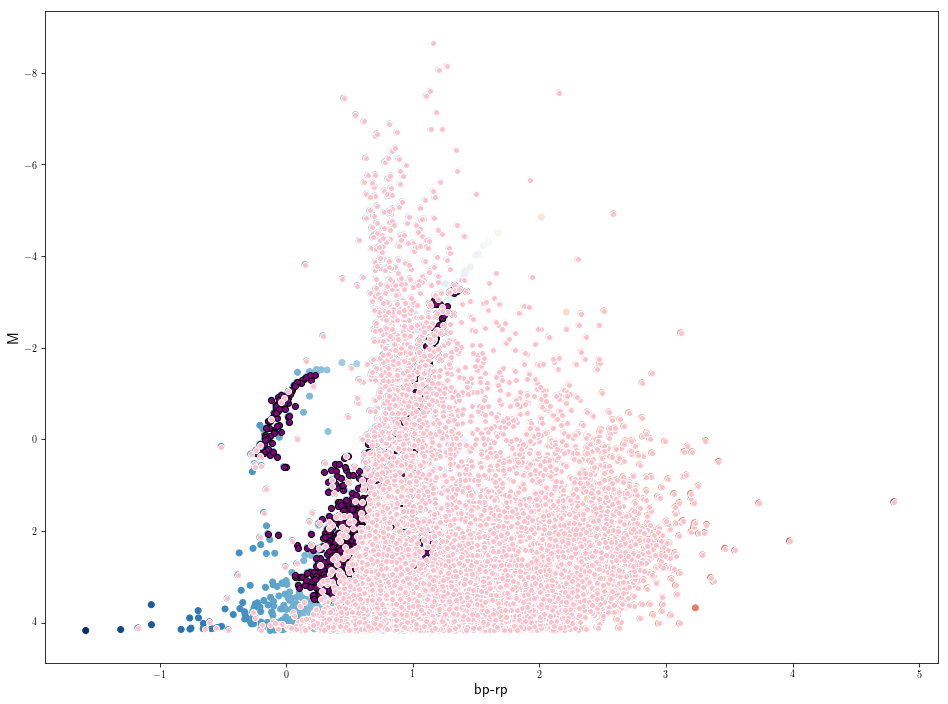

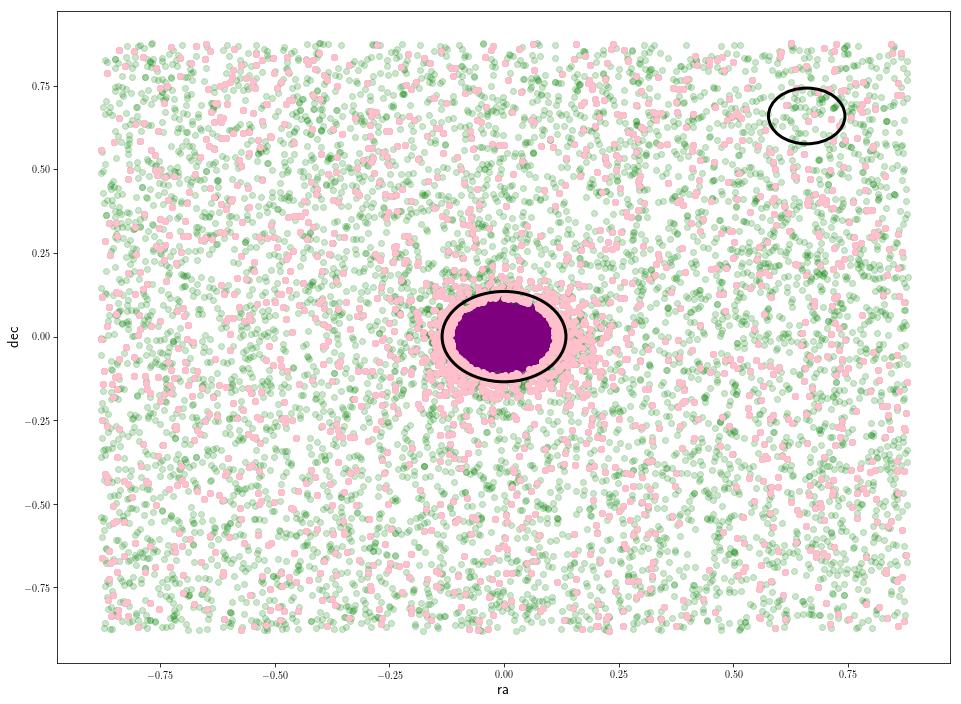

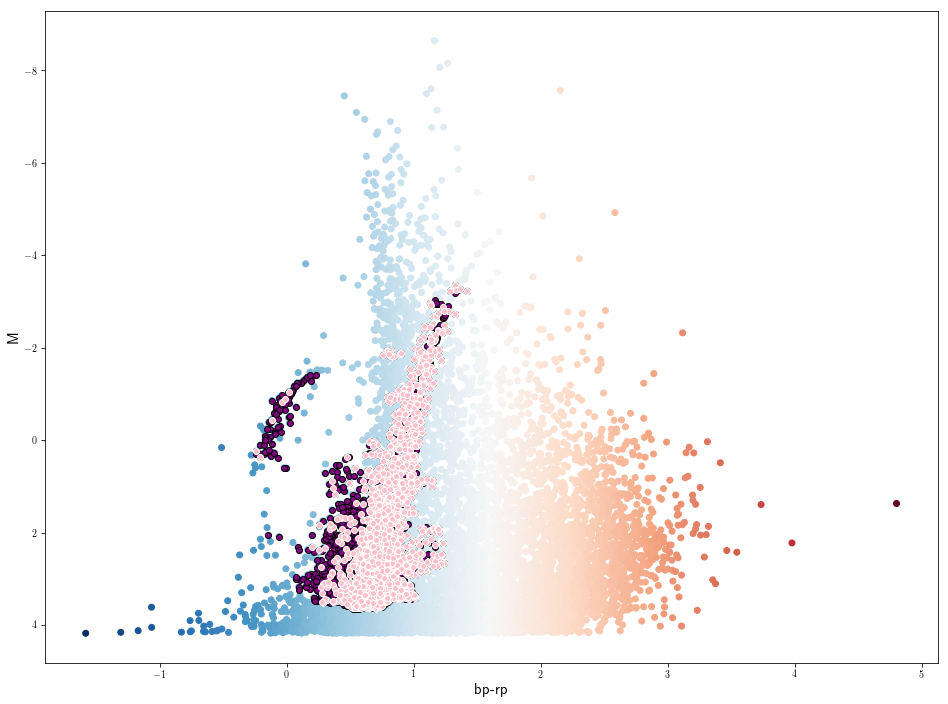

In [40]:
#in5 = (ra_ic3-ra_ic3.mean()<5/60)*(dec_ic3-dec_ic3.mean()<5/60)

r_t = GlobClust_Log_r_t[0]/60
r_c = GlobClust_Log_r_c[0]/60

in9 = (sqrt((np.fabs(GlobClust_Log_ra-ra_ic3.mean())**2+np.fabs(GlobClust_Log_dec-dec_ic3.mean())**2))>5*r_c)

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GlobClust_Log_ra[in9]-coord_ra_dec.ra.deg, y=GlobClust_Log_dec[in9]-coord_ra_dec.dec.deg, c='pink')
circle = plt.Circle((3*r_t,3*r_t), 5/60, color='k', fill=False, lw=3)
circle2 = plt.Circle((0,0),6*r_c, color='k', fill=False, lw=3)
ax.add_artist(circle)
ax.add_artist(circle2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GlobClust_Log_rpbp[in9], y=GlobClust_Log_M[in9], c='pink', edgecolors='w')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()


in10 = (sqrt((np.fabs(ra_ic3-ra_ic3.mean())**2+np.fabs(dec_ic3-dec_ic3.mean())**2))>5*r_c)
#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GlobClust_Log_ra-coord_ra_dec.ra.deg, y=GlobClust_Log_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=ra_ic3[in10]-coord_ra_dec.ra.deg, y=dec_ic3[in10]-coord_ra_dec.dec.deg, c='pink')
circle = plt.Circle((3*r_t,3*r_t), 5/60, color='k', fill=False, lw=3)
circle2 = plt.Circle((0,0),6*r_c, color='k', fill=False, lw=3)
ax.add_artist(circle)
ax.add_artist(circle2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=rpbp_ic3[in10], y=M_ic3[in10], c='pink', edgecolors='w')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))



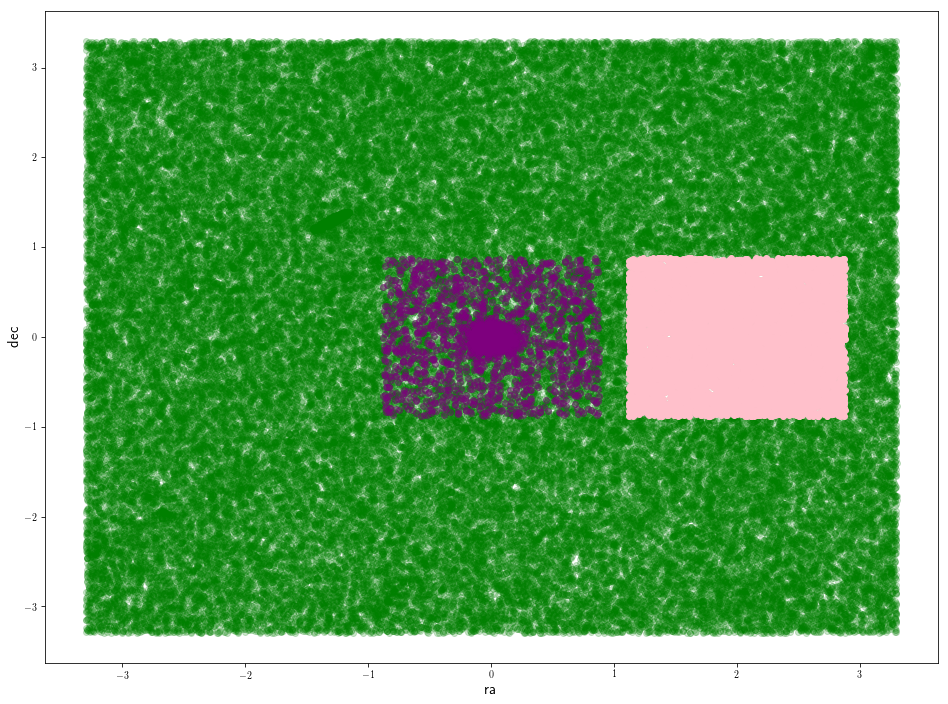

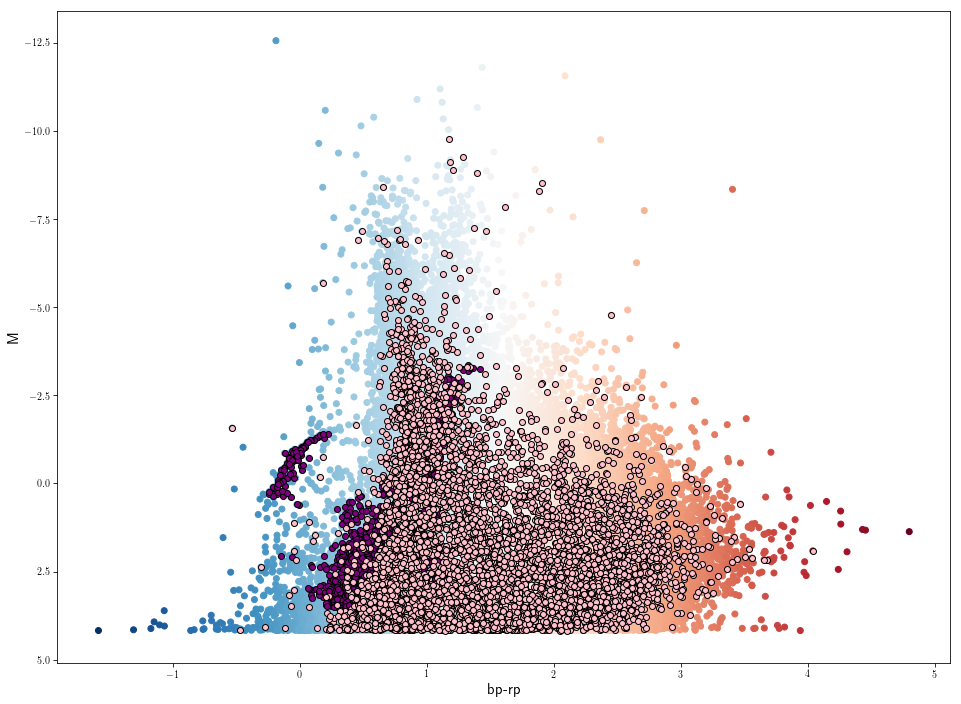

In [41]:
GC_15_r_t = pd.read_csv('out_NGC 288_full_12-rt_ra_dec.csv')

GC_15_ra = GC_15_r_t.loc[:,'ra']
GC_15_dec = GC_15_r_t.loc[:,'dec']
GC_15_g = GC_15_r_t.loc[:,'phot_g_mean_mag']
GC_15_rp = GC_15_r_t.loc[:,'phot_rp_mean_mag']
GC_15_bp = GC_15_r_t.loc[:,'phot_bp_mean_mag']
GC_15_pmra = GC_15_r_t.loc[:,'pmra']
GC_15_pmdec = GC_15_r_t.loc[:,'pmdec']

GC_15_M = GC_15_g-5*((log10(d_pc[i])) - 1)
GC_15_rpbp = GC_15_bp-GC_15_rp

in11 = (np.fabs(GC_15_ra-ra_ic3.mean()-2)<4*GlobClust_Log_r_t[0]/60)*\
(np.fabs(GC_15_dec-dec_ic3.mean())<4*GlobClust_Log_r_t[0]/60)

#sqrt((np.fabs(GC_15_ra-ra_ic3.mean()-2)**2+np.fabs(GC_15_dec-dec_ic3.mean()-2)**2))

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GC_15_ra-coord_ra_dec.ra.deg, y=GC_15_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GC_15_ra[in11]-coord_ra_dec.ra.deg, y=GC_15_dec[in11]-coord_ra_dec.dec.deg, c='pink')
#circle = plt.Circle((2,2), 5/60, color='k', fill=False, lw=3)
#circle = plt.Circle((0,0), 5/60, color='k', fill=False, lw=5)
#ax.add_artist(circle)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GC_15_rpbp, y=GC_15_M, c=GC_15_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GC_15_rpbp[in11], y=GC_15_M[in11], c='pink', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()


/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))



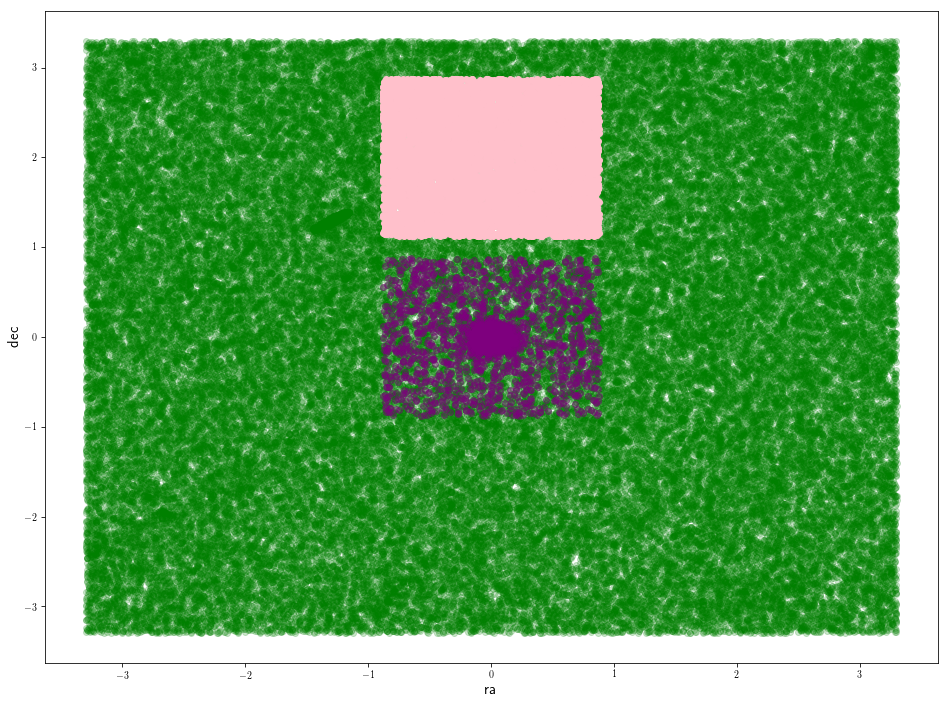

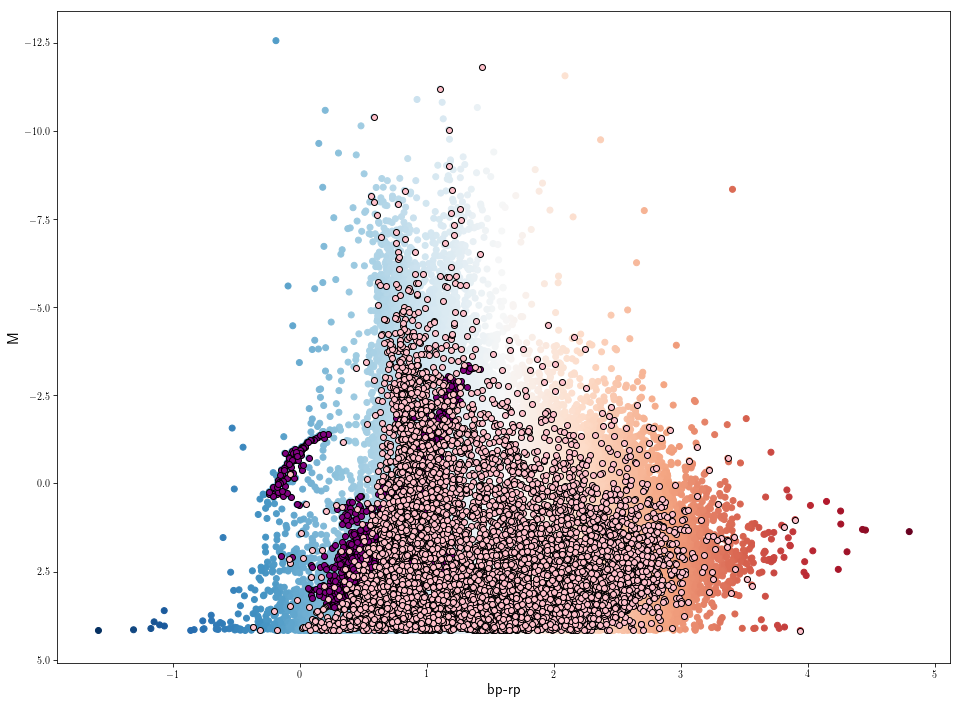

In [42]:
GC_15_r_t = pd.read_csv('out_NGC 288_full_12-rt_ra_dec.csv')

GC_15_ra = GC_15_r_t.loc[:,'ra']
GC_15_dec = GC_15_r_t.loc[:,'dec']
GC_15_g = GC_15_r_t.loc[:,'phot_g_mean_mag']
GC_15_rp = GC_15_r_t.loc[:,'phot_rp_mean_mag']
GC_15_bp = GC_15_r_t.loc[:,'phot_bp_mean_mag']
GC_15_pmra = GC_15_r_t.loc[:,'pmra']
GC_15_pmdec = GC_15_r_t.loc[:,'pmdec']

GC_15_M = GC_15_g-5*((log10(d_pc[i])) - 1)
GC_15_rpbp = GC_15_bp-GC_15_rp

in11 = (np.fabs(GC_15_ra-ra_ic3.mean())<4*GlobClust_Log_r_t[0]/60)*\
(np.fabs(GC_15_dec-dec_ic3.mean()-2)<4*GlobClust_Log_r_t[0]/60)

#sqrt((np.fabs(GC_15_ra-ra_ic3.mean()-2)**2+np.fabs(GC_15_dec-dec_ic3.mean()-2)**2))

#Scatter in ra-dec
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(x=GC_15_ra-coord_ra_dec.ra.deg, y=GC_15_dec-coord_ra_dec.dec.deg, c='g', alpha=0.2)
plt.scatter(x=ra_ic3-coord_ra_dec.ra.deg, y=dec_ic3-coord_ra_dec.dec.deg, c='purple', alpha=0.4)
plt.scatter(x=GC_15_ra[in11]-coord_ra_dec.ra.deg, y=GC_15_dec[in11]-coord_ra_dec.dec.deg, c='pink')
#circle = plt.Circle((2,2), 5/60, color='k', fill=False, lw=3)
#circle = plt.Circle((0,0), 5/60, color='k', fill=False, lw=5)
#ax.add_artist(circle)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

#CMD
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GC_15_rpbp, y=GC_15_M, c=GC_15_rpbp, cmap='RdBu_r')
plt.scatter(x=rpbp_ic3, y=M_ic3, c='purple', edgecolors='k')#, alpha=0.2)
plt.scatter(x=GC_15_rpbp[in11], y=GC_15_M[in11], c='pink', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=GlobClust_Log_rpbp[indx], y=GlobClust_Log_M[indx], c='b', edgecolors='w')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.gca().invert_yaxis()


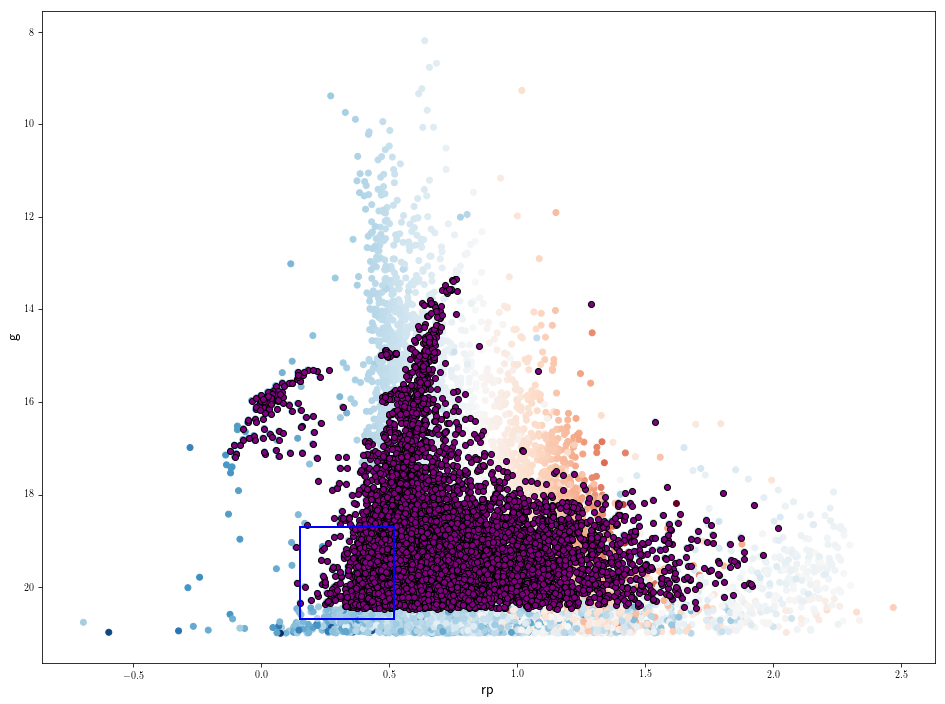

In [33]:
# Just curious
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_g-GlobClust_Log_rp, y=GlobClust_Log_g, c=GlobClust_Log_rpbp, cmap='RdBu_r')
plt.scatter(x=GlobClust_Log_g[Cluster3]-GlobClust_Log_rp[Cluster3], y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_ic3, y=GlobClust_Log_g[Cluster3], c='purple', edgecolors='k')#, alpha=0.2)
#plt.scatter(x=rpbp_outer_p, y=M_outer_p, c='g', edgecolors='w')#, alpha=0.2)
plt.xlabel('rp', fontsize=15)
plt.ylabel('g', fontsize=15)
plt.gca().invert_yaxis()

#Box in same place as paper
plt.plot([0.15,0.15], [18.7, 20.7], 'b-', lw=2)
plt.plot([0.52,0.52], [18.7, 20.7], 'b-', lw=2)
plt.plot([0.15,0.52], [20.7, 20.7], 'b-', lw=2)
plt.plot([0.15,0.52], [18.7, 18.7], 'b-', lw=2)

## Same analysis but including parallax from the start

#### Don't run!!

[5] :  NGC 288 1.35 0.0225


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in log10
/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))


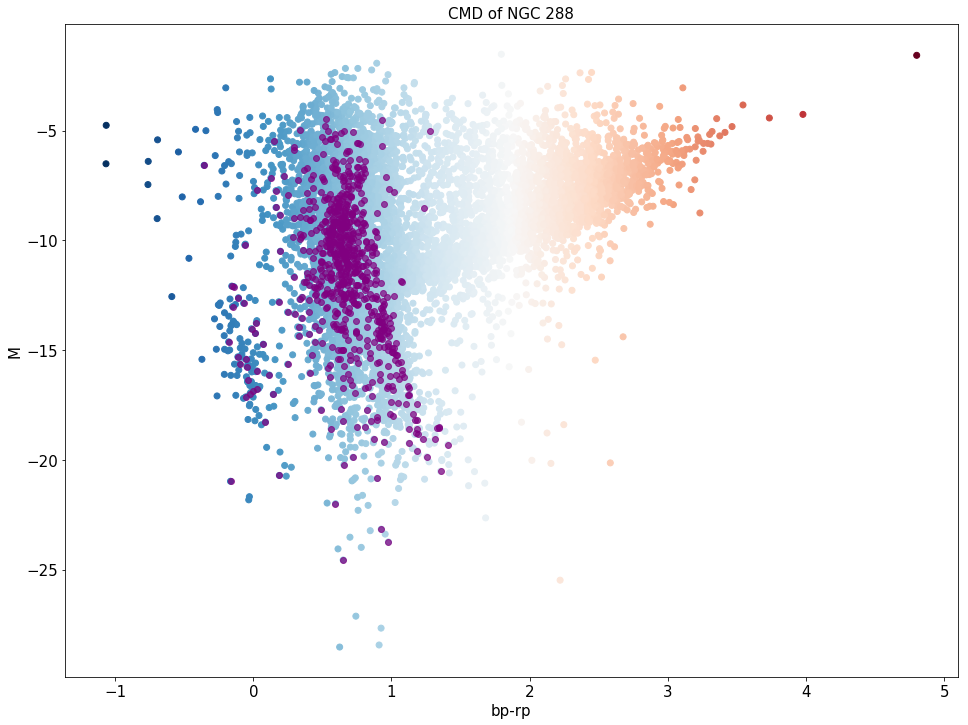

In [5]:
# CMD of core stars on full CMD for only stars with above 0 parallax
# RUN FOR DBSCAN !

#from gaia_tools import query
#import matplotlib
#matplotlib.use("AGG")
#import matplotlib.pyplot as plt
#import numpy as np
#import pandas as pd
#from astropy.table import Table
#import pyexcel
#from astropy import units as u
#from astropy.coordinates import SkyCoord

GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
#GlobClust_Log_r_h = GlobClust_Log_ra_dec.loc[:,"r_h"]
#Clust_Edge = GlobClust_Log_r_h
GlobClust_Log_r_c = GlobClust_Log_ra_dec.loc[:,"r_c"]
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[:,"r_t"]

out_logs = ['out_NGC 104_full_4-rt_ra_dec.csv','out_NGC 5694_full_4-rt_ra_dec.csv',\
            'out_NGC 1851_full_4-rt_ra_dec.csv','out_NGC 7492_full_4-rt_ra_dec.csv','out_Pal 5_full_4-rt_ra_dec.csv',\
            'out_NGC 288_full_4-rt_ra_dec.csv']
GC_IDs = ['NGC 104', 'NGC 5694', 'NGC 1851', 'NGC 7492', 'Pal 5', 'NGC 288']
Clust_Edge = [GlobClust_Log_r_c[2], GlobClust_Log_r_c[6], GlobClust_Log_r_c[7], GlobClust_Log_r_c[5], GlobClust_Log_r_c[1], GlobClust_Log_r_c[0]] #[0.4, 0.03, 0.1, 0.05, 0.13, 0.2]

d_kpc = [4500, 35000, 45100, 12100, 26300, 23200, 8900, 76500]
d_pc = d_kpc

for i in range(5,6):#len(GC_IDs)): #Should be better
    print([i], ": ", GC_IDs[i], Clust_Edge[i], Clust_Edge[i]/60)
    GlobClust_Log_CMD = pd.read_csv(out_logs[i]) 
    GlobClust_Log_g = GlobClust_Log_CMD.loc[:,"phot_g_mean_mag"]
    GlobClust_Log_rp = GlobClust_Log_CMD.loc[:,"phot_rp_mean_mag"]
    GlobClust_Log_bp = GlobClust_Log_CMD.loc[:,"phot_bp_mean_mag"]
    GlobClust_Log_rpbp = GlobClust_Log_bp - GlobClust_Log_rp
    GlobClust_Log_ra_out = GlobClust_Log_CMD.loc[:,"ra"]
    GlobClust_Log_dec_out = GlobClust_Log_CMD.loc[:,"dec"]
    GlobClust_Log_pmdec_out = GlobClust_Log_CMD.loc[:,"pmdec"]
    GlobClust_Log_pmra_out = GlobClust_Log_CMD.loc[:,"pmra"]
    GlobClust_Log_parallax_out = GlobClust_Log_CMD.loc[:,"parallax"]
    GlobClust_Log_parallaxerror_out = GlobClust_Log_CMD.loc[:,"parallax_error"]
    
    
    #M=m-5(log(d)-1)
    GlobClust_Log_M = GlobClust_Log_g-5*((log10(1/(GlobClust_Log_parallax_out/3600000))) - 1)
    
    GlobClust_Log_parallaxover_out = GlobClust_Log_parallaxerror_out/GlobClust_Log_parallax_out
    
    indx_parallax = (np.fabs(GlobClust_Log_ra_out-GlobClust_Log_ra_out.mean())<Clust_Edge[i]/60)*\
    (np.fabs(GlobClust_Log_dec_out-GlobClust_Log_dec_out.mean())<Clust_Edge[i]/60)*\
    ((GlobClust_Log_parallaxover_out>0.20) | ((1/GlobClust_Log_parallax_out>5.)*(GlobClust_Log_parallaxover_out<0.20)))
    #(GlobClust_Log_parallaxover_out<0.2)
    
    fig=plt.figure(figsize=(16,12))
    plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
    plt.scatter(x=GlobClust_Log_rpbp[indx_parallax], y=GlobClust_Log_M[indx_parallax], c='purple', alpha=0.7)
    plt.xlabel('bp-rp', fontsize=15)
    plt.ylabel('M', fontsize=15)
    plt.title('CMD of ' + GC_IDs[i], fontsize=15)
    #cb=plt.colorbar()
    #cb.ax.tick_params(labelsize=15)
    #cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
    plt.gca().tick_params(labelsize=15)
    plt.show()

    #CMD_raw = {'bprp': GlobClust_Log_rpbp, 'M': GlobClust_Log_M, 'ra': GlobClust_Log_ra_out, 'dec': GlobClust_Log_dec_out}
    #CMD_plot = pd.DataFrame(data=CMD_raw)
    #CMD_plot.to_csv('out_CMD_'+ GC_IDs[i] +'_rawplot.csv', index=True, header=True)
    
    #GC_StarsPlot = {'bprp indx': GlobClust_Log_rpbp[indx], 'M indx': GlobClust_Log_M[indx], 'ra': GlobClust_Log_ra_out,\
    #                'dec': GlobClust_Log_dec_out}
    #GC_StarscutPlot = pd.DataFrame(data=GC_StarsPlot)
    #GC_StarscutPlot.to_csv('out_GCStars_'+ GC_IDs[i] +'_cutplot_r_c.csv', index=True, header=True)
    


<SkyCoord (ICRS): (ra, dec) in deg
    [( 13.1885, -26.58261111)]>
(752, 6)
[ 0  0 -1  0  0  0  0 -1  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0 -1 -1
  0  0  0  0 -1  0  0  0 -1  0  0 -1  0  0  0 -1  0  0  0  0  0  0  0  0  0
  0  0  0  0 -1  0  0  0  0 -1  0 -1  0  0 -1 -1  0 -1  0  0  0  0  0  0  0
  0 -1  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0 -1  0  0 -1 -1 -1
  0  0  0  0  0 -1  0  0  0  0  0 -1  0  0 -1  0  0 -1  0  0  0  0  0 -1  0
 -1 -1 -1  0 -1 -1  0  0  0  0  0  0  0  0  0  0 -1  0  0  0 -1 -1  0  0  0
  0 -1  0  0  0  0 -1 -1  0 -1  0  0  0  0  0  0  0  0 -1  0  0 -1  0  0  0
  0  0  0 -1  0 -1  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0 -1  0 -1 -1
  0  0  0  0  0 -1 -1  0  0  0  0 -1  0  0  0 -1  0  0 -1 -1  0 -1  0 -1  0
  0  0  0  0  0  0 -1  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0 -1 -1 -1  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0
  0  0  0  0

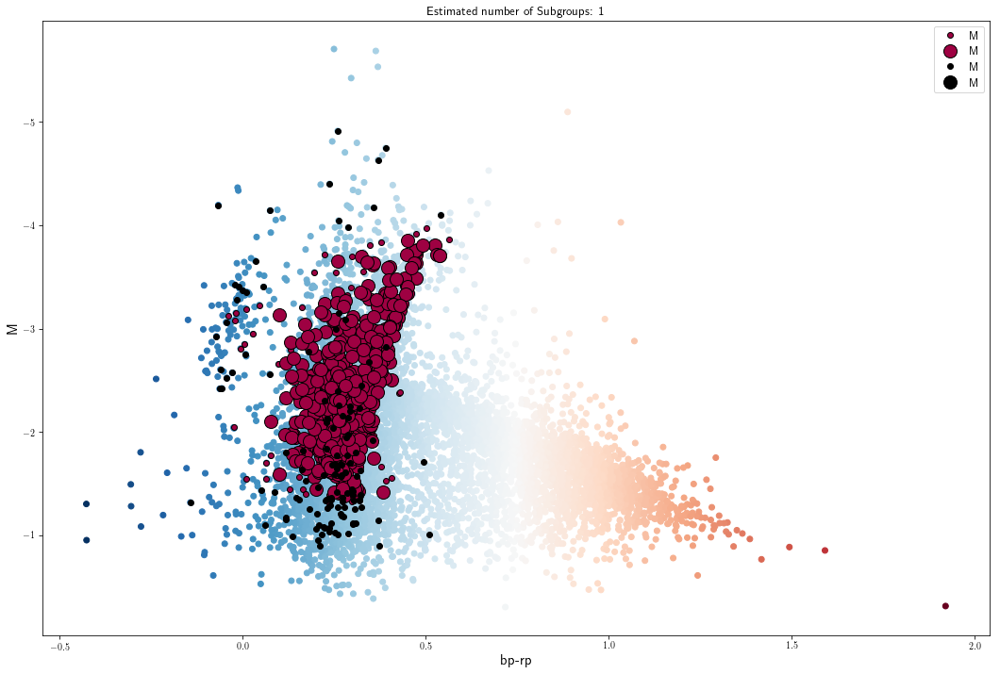

In [56]:
GlobClust_Log_pmra = GlobClust_Log_pmra_out.as_matrix()
GlobClust_Log_pmdec = GlobClust_Log_pmdec_out.as_matrix()
GlobClust_Log_ra = GlobClust_Log_ra_out.as_matrix()
GlobClust_Log_dec = GlobClust_Log_dec_out.as_matrix()

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')
print(coord_ra_dec)

DB_Params =[]
DB_Params=np.transpose(DB_Params)

DF={'M': GlobClust_Log_M[indx_parallax]/5, 'rpbp': GlobClust_Log_rpbp[indx_parallax]/2.5, 'pmra': GlobClust_Log_pmra[indx_parallax]/20, \
    'pmdec': GlobClust_Log_pmdec[indx_parallax]/20, 'ra': GlobClust_Log_ra[indx_parallax]/0.35, 'dec': GlobClust_Log_dec[indx_parallax]/0.3}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.1625, min_samples=10, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params)

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5,GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    xy = DB_Params[class_member_mask & ~core_samples_mask]
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
    
    x_param4.append(xy.loc[:, "rpbp"]*2.5)
    y_param4.append(xy.loc[:, "M"]*5)


plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

In [57]:
import time

t0 = time.time()

#print(x_param)
#print(y_param)

#print(GlobClust_Log_M[x_param])
#x_out = x_param.transpose()
x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
x_out4.reset_index()
x_out4 = x_out4.transpose() 
x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
x_out4 = x_out4["rpbp"].as_matrix()
x_out4

y_out4 = pd.DataFrame(y_param4)#, index=None)#, mangle_dupe_cols=True)
y_out4.reset_index()
y_out4 = y_out4.transpose() 
y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
y_out4 = y_out4["M"].as_matrix()
print(shape(y_out4))


M_i4 = GlobClust_Log_M.as_matrix()
rpbp_i4 = GlobClust_Log_rpbp.as_matrix()

M_k4 = y_out4
rpbp_k4 = x_out4


Cluster4 = np.zeros(len(GlobClust_Log_M), dtype='bool')


M_final4 = []
rpbp_final4 =[]


for i3 in range(0,len(M_i4)):
    count = 0
    for k3 in range(0,len(M_k4)):
        dist4 = np.sqrt(np.abs((M_i4[i3]-M_k4[k3])**2+(rpbp_i4[i3]-rpbp_k4[k3])**2))
        if dist4 < 0.1:
            Cluster4[i3]=True
            M_final4.append(M_i4[i3])
            rpbp_final4.append(rpbp_i4[i3])
            count+=1
            if count != 0:
                break

t1 = time.time()
total = t1-t0
print(total)
print(Cluster4)
print(shape(Cluster4))
print(np.sum(Cluster4))

(553,)
37.02069926261902
[False False False ...,  True  True False]
(21399,)
5270


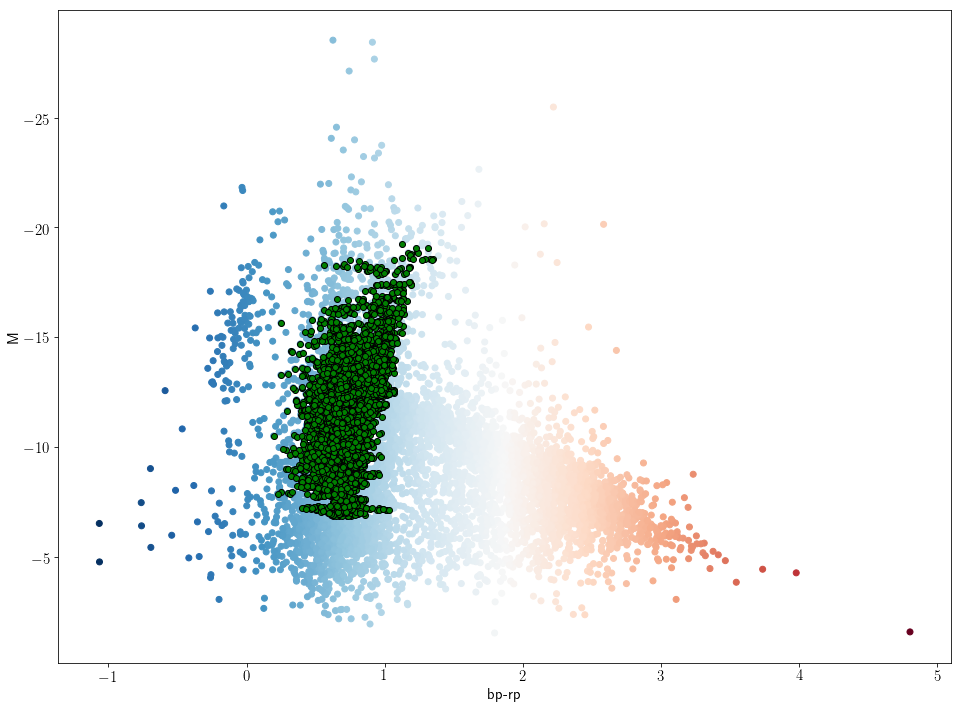

In [58]:
# PLOT OUTCOME OF CMD - RUN AFTER PREVIOUS CELL
rpbp_ic4=rpbp_i4[Cluster4] #np.multiply(rpbp_i,Cluster)
M_ic4=M_i4[Cluster4] #multiply(M_i,Cluster)

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=rpbp_ic4, y=M_ic4, c='g', edgecolors='k')#, alpha=0.2)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

In [5]:
import pandas as pd
GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_cat.csv')
GlobClust_Log_ra_dec.loc[150:150, :]

,ID,RA,DEC,r_h,r_t
150,NGC 288,0h52m45.24s,-26d34m57.4s,2.23,13.192702


In [4]:
# New Query

GlobClust_New = pd.read_csv('~/out_NGC 288_full_12-rt_ra_dec.csv')

GlobClust_New

,Unnamed: 0,ra,dec,l,b,pmra,pmdec,phot_g_mean_mag,phot_rp_mean_mag,phot_bp_mean_mag,parallax,parallax_error,a_g_val
0,0,13.299065,-25.160894,134.371163,-87.993466,-0.593986,-2.039833,16.8501,15.9495,17.6908,1.591576,0.088067,0.4435
1,1,15.890165,-26.724809,205.128407,-87.268000,61.395963,3.143169,15.4983,14.6319,16.2842,2.489756,0.039943,0.4230
2,2,12.633905,-29.061840,308.754966,-88.056199,-2.407490,-4.548216,20.3736,20.0796,20.5231,-1.315404,1.068133,NaN
3,3,11.528637,-28.419488,344.986381,-88.252507,-12.949446,-8.366959,14.0938,13.5780,14.4634,1.197885,0.027709,0.2793
4,4,12.291225,-29.837042,313.244849,-87.245560,NaN,NaN,21.1678,NaN,NaN,NaN,NaN,NaN
5,5,16.172073,-25.303044,182.115273,-86.512664,5.545489,5.538272,19.5815,18.5611,20.5721,0.797422,0.463502,NaN
6,6,15.999561,-28.548484,240.748049,-86.881372,7.497432,-5.168095,20.3566,19.4564,20.6271,0.223391,0.729323,NaN
7,7,13.555091,-24.874056,138.587012,-87.660730,13.953805,9.651733,20.6755,19.4135,21.2646,-1.129184,1.674561,NaN
8,8,16.399607,-26.729140,206.529252,-86.818706,NaN,NaN,21.1678,NaN,NaN,NaN,NaN,NaN
9,9,10.698190,-29.237137,344.519441,-87.158204,3.841904,6.835329,15.0181,14.2541,15.6678,2.427205,0.035703,0.2140
